# Info
Purpose:

    Describe the details ...

Input:

    arguments

Output:

    Figure and save files

Keywords:

    none

Dependencies:

    - load_utils.py
    - matplotlib
    - numpy
    - Sp_parameters
    - write_utils
    - path_utils
    - hdf5storage
    - scipy

Needed Files:
  - file.rc : for consistent creation of look of matplotlib figures
  - ...

Modification History:

    Written: Samuel LeBlanc, Santa Cruz, CA, 2022-12-01
    Modified:


# Prepare python environment

In [1]:
import numpy as np
import Sp_parameters as Sp
import load_utils as lu
import write_utils as wu
from path_utils import getpath
import hdf5storage as hs
import scipy.io as sio
import matplotlib.pyplot as plt
%matplotlib notebook
import os
from datetime import datetime 

In [66]:
name = 'ORACLES_2017_4wvl_nc_daily'
vv = 'v1'
fp = getpath('sunsat_oracles2016')

Return path named:  sunsat_oracles2016 /data/sunsat/ORACLES_2016/


In [128]:
fpo = fp+'data_processed/starskies/skyscans_Logan_20221201_nc_2017/'

In [7]:
fpo = fp+'data_processed/starskies/Logan_skyscans_20221209/'

In [73]:
name = 'ORACLES_2016_5wvl_nc_daily'
fpo = fp+'data_processed/starskies/skyscans_Logan_20221209_nc_2016/'

In [36]:
name8 = 'ORACLES_2018_4wvl_nc_daily'
fpo8 = fp+'data_processed/starsky/Logan_starskies_20221209/'

# Load files

In [68]:
flist = os.listdir(fpo)
flist.sort()
flist

['4STAR-aeroinv_P3_20160831_5wl_R1.nc',
 '4STAR-aeroinv_P3_20160902_5wl_R1.nc',
 '4STAR-aeroinv_P3_20160904_5wl_R1.nc',
 '4STAR-aeroinv_P3_20160906_5wl_R1.nc',
 '4STAR-aeroinv_P3_20160908_5wl_R1.nc',
 '4STAR-aeroinv_P3_20160910_5wl_R1.nc',
 '4STAR-aeroinv_P3_20160912_5wl_R1.nc',
 '4STAR-aeroinv_P3_20160914_5wl_R1.nc',
 '4STAR-aeroinv_P3_20160918_5wl_R1.nc',
 '4STAR-aeroinv_P3_20160920_5wl_R1.nc',
 '4STAR-aeroinv_P3_20160924_5wl_R1.nc',
 '4STAR-aeroinv_P3_20160925_5wl_R1.nc',
 '4STAR-aeroinv_P3_20160927_5wl_R1.nc']

In [69]:
nc = []
nc_dict = []
for f in flist:
    nc_tmp,nc_dict_tmp = lu.load_netcdf(fpo+f,everything=True)
    nc.append(nc_tmp)
    nc_dict.append(nc_dict_tmp) 

Reading file: /data/sunsat/ORACLES_2016/data_processed/starskies/skyscans_Logan_20221209_nc_2016/4STAR-aeroinv_P3_20160831_5wl_R1.nc
Outputting the Data subdatasets:
0: base_time
1: time_offset
2: time
3: wavelength
4: radius
5: psd
6: QA_level
7: sphericity
8: sphericity_err
9: PF_angle
10: sca_angle
11: n_real
12: n_imag
13: SSA
14: AOD_fit_total
15: AOD_fit_fine
16: AOD_fit_coarse
17: AOD_meas
18: AAOD
19: TOD_meas
20: TOD_fit
21: TOD_meas_minus_fit
22: AGOD
23: sfc_alb
24: g_total
25: g_fine
26: g_coarse
27: PF_total
28: PF_fine
29: PF_coarse
30: normalized_sky_radiance
31: normalized_sky_radiance_fit
32: sky_radiance_fit_error
33: scan_tag
34: scan_type
35: Lat
36: Lon
37: GPS_Altitude
38: Heading
39: Pitch
40: Roll
41: GPS_Altitude_std
42: Heading_std
43: Pitch_std
44: Roll_std
45: T_static
46: P_static
47: RH
48: SAZ
49: SZA
50: SEL
51: m_ray
52: PWV
[b'base_time', b'time_offset', b'time', b'wavelength', b'radius', b'psd', b'QA_level', b'sphericity', b'sphericity_err', b'PF_angl

[b'base_time', b'time_offset', b'time', b'wavelength', b'radius', b'psd', b'QA_level', b'sphericity', b'sphericity_err', b'PF_angle', b'sca_angle', b'n_real', b'n_imag', b'SSA', b'AOD_fit_total', b'AOD_fit_fine', b'AOD_fit_coarse', b'AOD_meas', b'AAOD', b'TOD_meas', b'TOD_fit', b'TOD_meas_minus_fit', b'AGOD', b'sfc_alb', b'g_total', b'g_fine', b'g_coarse', b'PF_total', b'PF_fine', b'PF_coarse', b'normalized_sky_radiance', b'normalized_sky_radiance_fit', b'sky_radiance_fit_error', b'scan_tag', b'scan_type', b'Lat', b'Lon', b'GPS_Altitude', b'Heading', b'Pitch', b'Roll', b'GPS_Altitude_std', b'Heading_std', b'Pitch_std', b'Roll_std', b'T_static', b'P_static', b'RH', b'SAZ', b'SZA', b'SEL', b'm_ray', b'PWV']
Reading file: /data/sunsat/ORACLES_2016/data_processed/starskies/skyscans_Logan_20221209_nc_2016/4STAR-aeroinv_P3_20160918_5wl_R1.nc
Outputting the Data subdatasets:
0: base_time
1: time_offset
2: time
3: wavelength
4: radius
5: psd
6: QA_level
7: sphericity
8: sphericity_err
9: PF_an

In [70]:
for i,n in enumerate(nc):
    if i==0: 
        nc_all = n   
        nc_all[b'time'] = nc_all[b'time']+nc_all[b'base_time']
    else:
        for k in n:
            if not k in [b'wavelength',b'radius',b'PF_angle']:
                if k in [b'base_time']:
                    nc_all[k] = np.append(nc_all[k],n[k])
                elif k in [b'time']:
                    nc_all[k] = np.append(nc_all[k],n[k]+n[b'base_time'])
                else:
                    nc_all[k] = np.append(nc_all[k],n[k],axis=0)

In [71]:
for k in nc_all:
    print(k,nc_all[k].shape,nc[1][k].shape)

b'base_time' (13,) ()
b'time_offset' (82,) (14,)
b'time' (82,) (14,)
b'wavelength' (5,) (5,)
b'radius' (22,) (22,)
b'psd' (82, 22) (14, 22)
b'QA_level' (82,) (14,)
b'sphericity' (82,) (14,)
b'sphericity_err' (82,) (14,)
b'PF_angle' (83,) (83,)
b'sca_angle' (82, 60) (14, 60)
b'n_real' (82, 5) (14, 5)
b'n_imag' (82, 5) (14, 5)
b'SSA' (82, 5) (14, 5)
b'AOD_fit_total' (82, 5) (14, 5)
b'AOD_fit_fine' (82, 5) (14, 5)
b'AOD_fit_coarse' (82, 5) (14, 5)
b'AOD_meas' (82, 5) (14, 5)
b'AAOD' (82, 5) (14, 5)
b'TOD_meas' (82, 5) (14, 5)
b'TOD_fit' (82, 5) (14, 5)
b'TOD_meas_minus_fit' (82, 5) (14, 5)
b'AGOD' (82, 5) (14, 5)
b'sfc_alb' (82, 5) (14, 5)
b'g_total' (82, 5) (14, 5)
b'g_fine' (82, 5) (14, 5)
b'g_coarse' (82, 5) (14, 5)
b'PF_total' (82, 5, 83) (14, 5, 83)
b'PF_fine' (82, 5, 83) (14, 5, 83)
b'PF_coarse' (82, 5, 83) (14, 5, 83)
b'normalized_sky_radiance' (82, 5, 60) (14, 5, 60)
b'normalized_sky_radiance_fit' (82, 5, 60) (14, 5, 60)
b'sky_radiance_fit_error' (82, 5, 60) (14, 5, 60)
b'scan_tag

In [72]:
nc_all[b'datetime'] = np.array([datetime.fromtimestamp(t) for t in nc_all[b'time']]).astype(np.datetime64)

## load 2018 files

In [37]:
flist8 = os.listdir(fpo8)
flist8.sort()
flist8

['4STAR-aeroinv_P3_20180930_4wl_R0.nc',
 '4STAR-aeroinv_P3_20181005_4wl_R0.nc',
 '4STAR-aeroinv_P3_20181007_4wl_R0.nc',
 '4STAR-aeroinv_P3_20181010_4wl_R0.nc',
 '4STAR-aeroinv_P3_20181012_4wl_R0.nc',
 '4STAR-aeroinv_P3_20181015_4wl_R0.nc',
 '4STAR-aeroinv_P3_20181017_4wl_R0.nc',
 '4STAR-aeroinv_P3_20181019_4wl_R0.nc',
 'drive-download-20221210T060520Z-001.zip']

In [38]:
nc8 = []
nc8_dict = []
for f in flist8:
    nc8_tmp,nc8_dict_tmp = lu.load_netcdf(fpo8+f,everything=True)
    nc8.append(nc8_tmp)
    nc8_dict.append(nc8_dict_tmp) 

Reading file: /data/sunsat/ORACLES_2018/data_processed/starsky/Logan_starskies_20221209/4STAR-aeroinv_P3_20180930_4wl_R0.nc
Outputting the Data subdatasets:
0: base_time
1: time_offset
2: time
3: wavelength
4: radius
5: psd
6: QA_level
7: sphericity
8: sphericity_err
9: PF_angle
10: sca_angle
11: n_real
12: n_imag
13: SSA
14: AOD_fit_total
15: AOD_fit_fine
16: AOD_fit_coarse
17: AOD_meas
18: AAOD
19: TOD_meas
20: TOD_fit
21: TOD_meas_minus_fit
22: AGOD
23: sfc_alb
24: g_total
25: g_fine
26: g_coarse
27: PF_total
28: PF_fine
29: PF_coarse
30: normalized_sky_radiance
31: normalized_sky_radiance_fit
32: sky_radiance_fit_error
33: scan_tag
34: scan_type
35: Lat
36: Lon
37: GPS_Altitude
38: Heading
39: Pitch
40: Roll
41: GPS_Altitude_std
42: Heading_std
43: Pitch_std
44: Roll_std
45: T_static
46: P_static
47: RH
48: SAZ
49: SZA
50: SEL
51: m_ray
52: PWV
[b'base_time', b'time_offset', b'time', b'wavelength', b'radius', b'psd', b'QA_level', b'sphericity', b'sphericity_err', b'PF_angle', b'sca

32: sky_radiance_fit_error
33: scan_tag
34: scan_type
35: Lat
36: Lon
37: GPS_Altitude
38: Heading
39: Pitch
40: Roll
41: GPS_Altitude_std
42: Heading_std
43: Pitch_std
44: Roll_std
45: T_static
46: P_static
47: RH
48: SAZ
49: SZA
50: SEL
51: m_ray
52: PWV
[b'base_time', b'time_offset', b'time', b'wavelength', b'radius', b'psd', b'QA_level', b'sphericity', b'sphericity_err', b'PF_angle', b'sca_angle', b'n_real', b'n_imag', b'SSA', b'AOD_fit_total', b'AOD_fit_fine', b'AOD_fit_coarse', b'AOD_meas', b'AAOD', b'TOD_meas', b'TOD_fit', b'TOD_meas_minus_fit', b'AGOD', b'sfc_alb', b'g_total', b'g_fine', b'g_coarse', b'PF_total', b'PF_fine', b'PF_coarse', b'normalized_sky_radiance', b'normalized_sky_radiance_fit', b'sky_radiance_fit_error', b'scan_tag', b'scan_type', b'Lat', b'Lon', b'GPS_Altitude', b'Heading', b'Pitch', b'Roll', b'GPS_Altitude_std', b'Heading_std', b'Pitch_std', b'Roll_std', b'T_static', b'P_static', b'RH', b'SAZ', b'SZA', b'SEL', b'm_ray', b'PWV']
Reading file: /data/sunsat/O

OSError: [Errno -51] NetCDF: Unknown file format: b'/data/sunsat/ORACLES_2018/data_processed/starsky/Logan_starskies_20221209/drive-download-20221210T060520Z-001.zip'

In [39]:
for i,n in enumerate(nc8):
    if i==0: 
        nc8_all = n   
        nc8_all[b'time'] = nc8_all[b'time']+nc8_all[b'base_time']
    else:
        for k in n:
            if not k in [b'wavelength',b'radius',b'PF_angle']:
                if k in [b'base_time']:
                    nc8_all[k] = np.append(nc8_all[k],n[k])
                elif k in [b'time']:
                    nc8_all[k] = np.append(nc8_all[k],n[k]+n[b'base_time'])
                else:
                    nc8_all[k] = np.append(nc8_all[k],n[k],axis=0)

In [40]:
nc8_all[b'datetime'] = np.array([datetime.fromtimestamp(t) for t in nc8_all[b'time']]).astype(np.datetime64)

# Plot out data

<IPython.core.display.Javascript object>


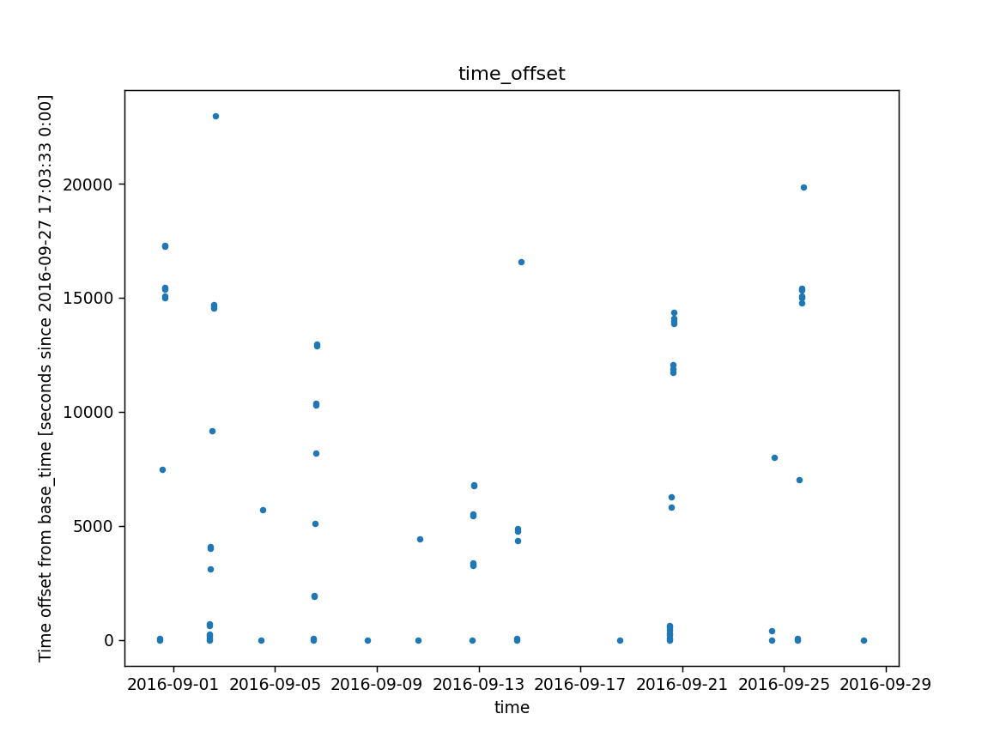

<IPython.core.display.Javascript object>


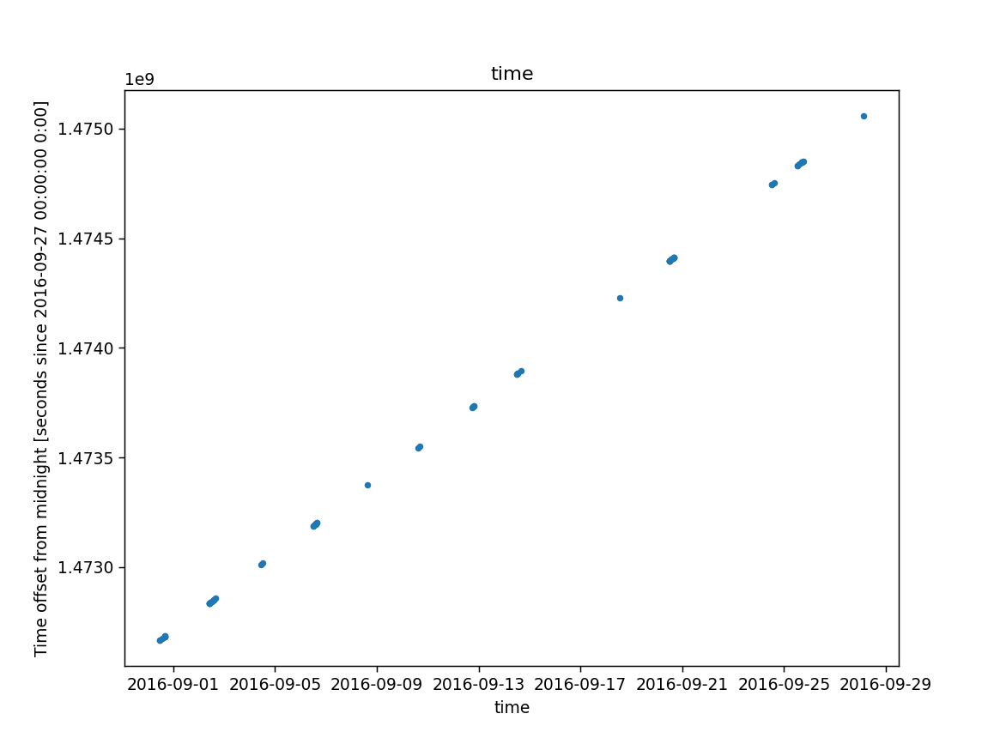

<IPython.core.display.Javascript object>


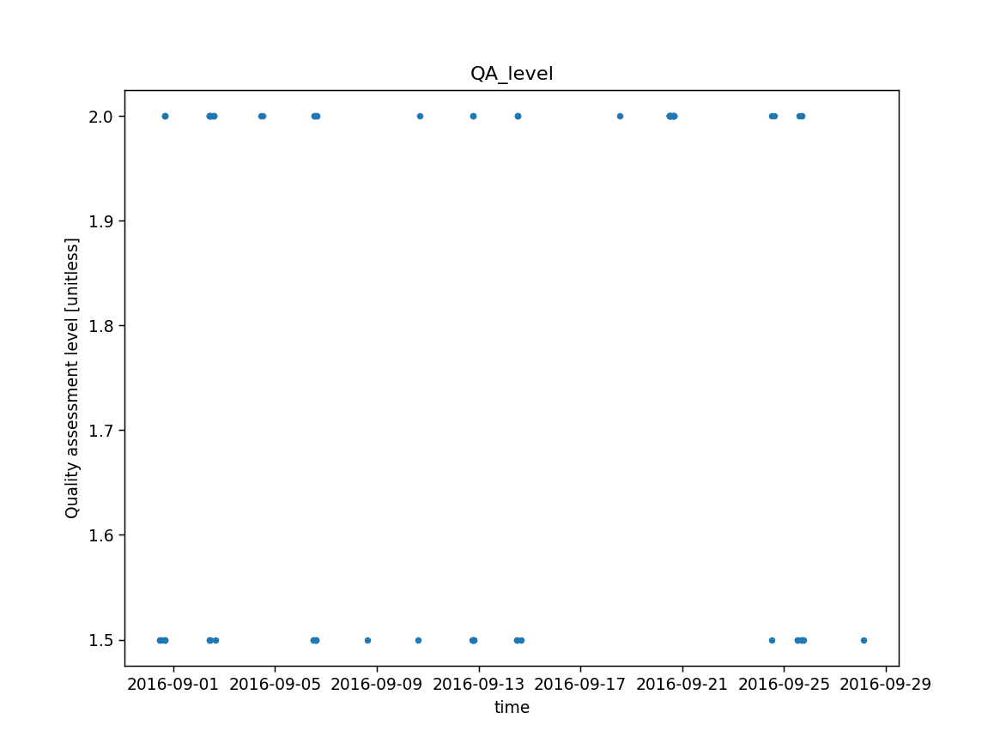

<IPython.core.display.Javascript object>


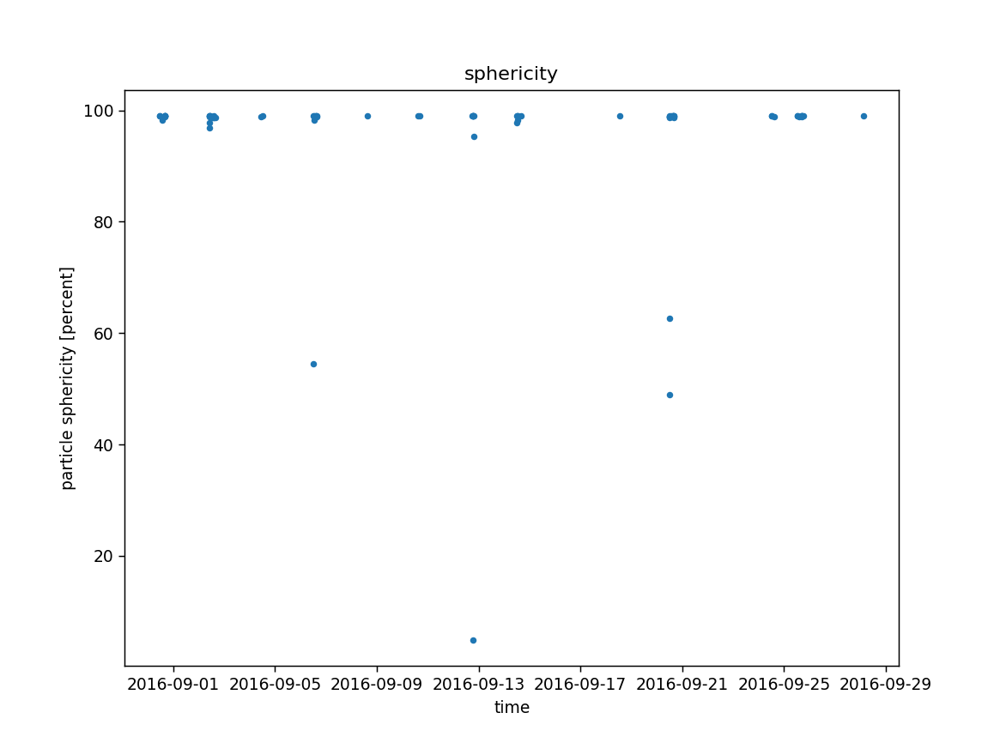

<ipython-input-74-4fd944ddcf24>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


<IPython.core.display.Javascript object>


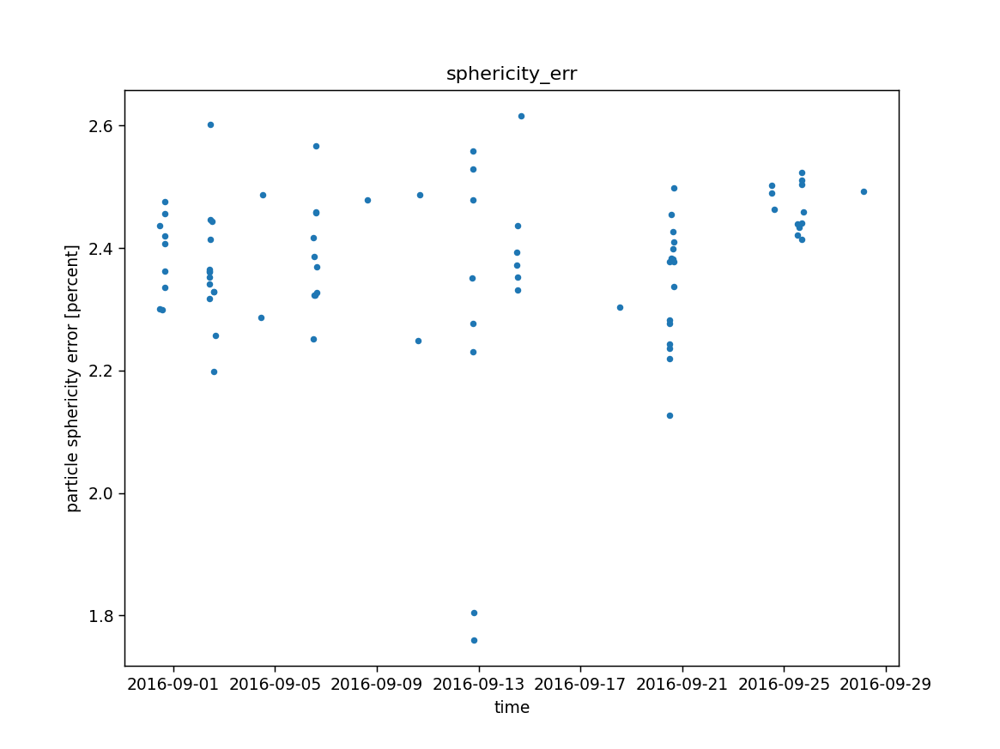

<IPython.core.display.Javascript object>


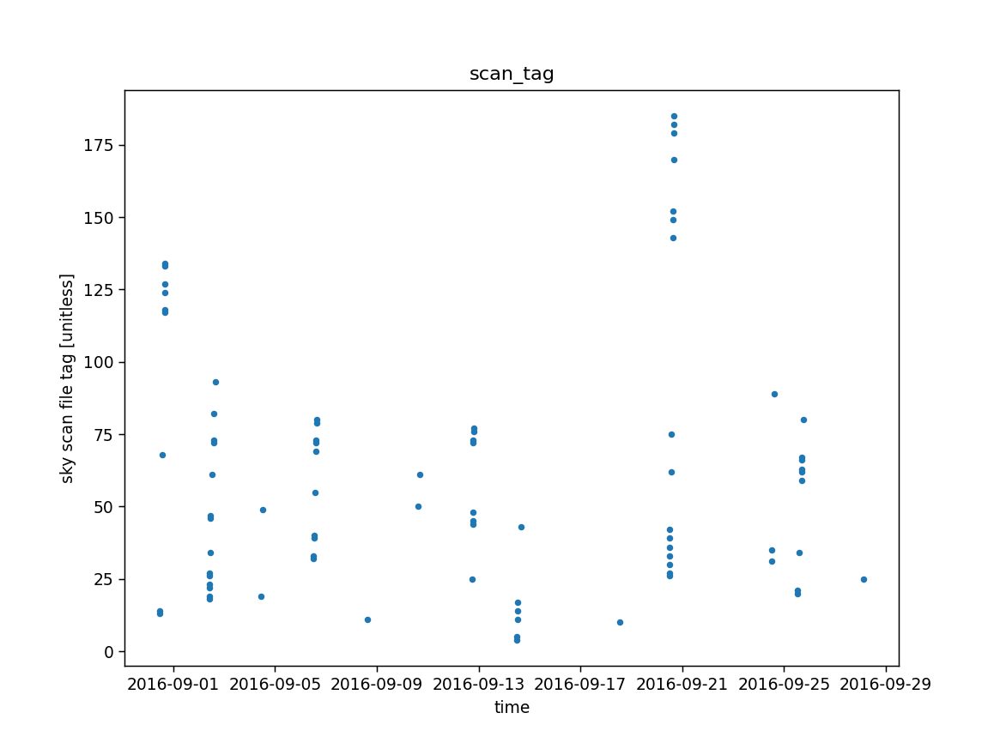

<IPython.core.display.Javascript object>


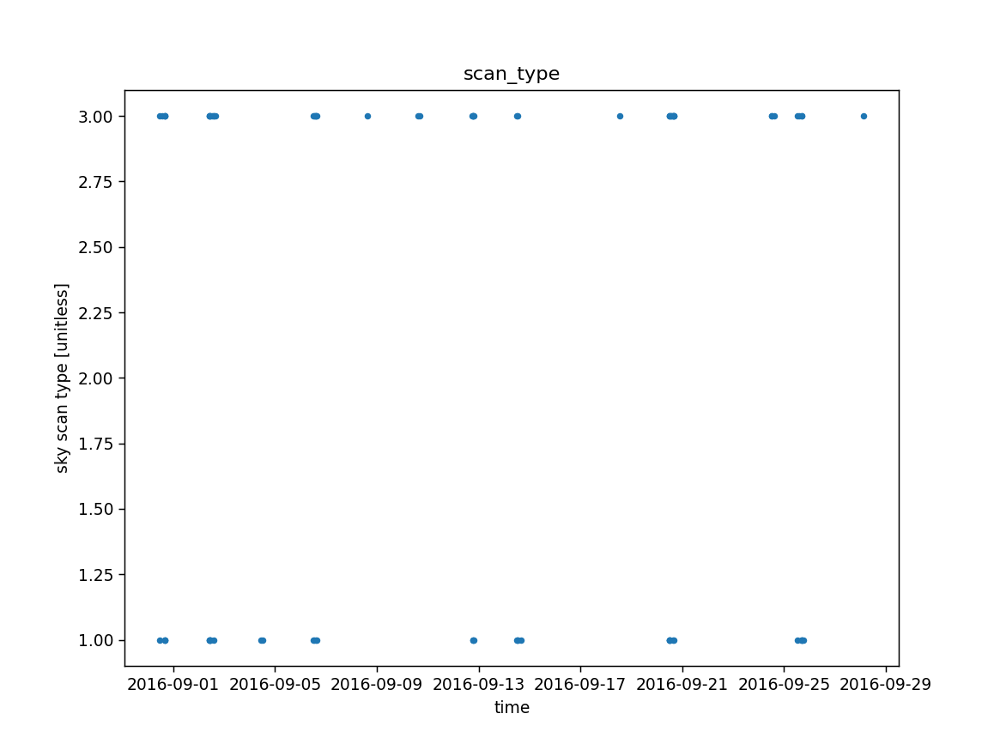

<IPython.core.display.Javascript object>


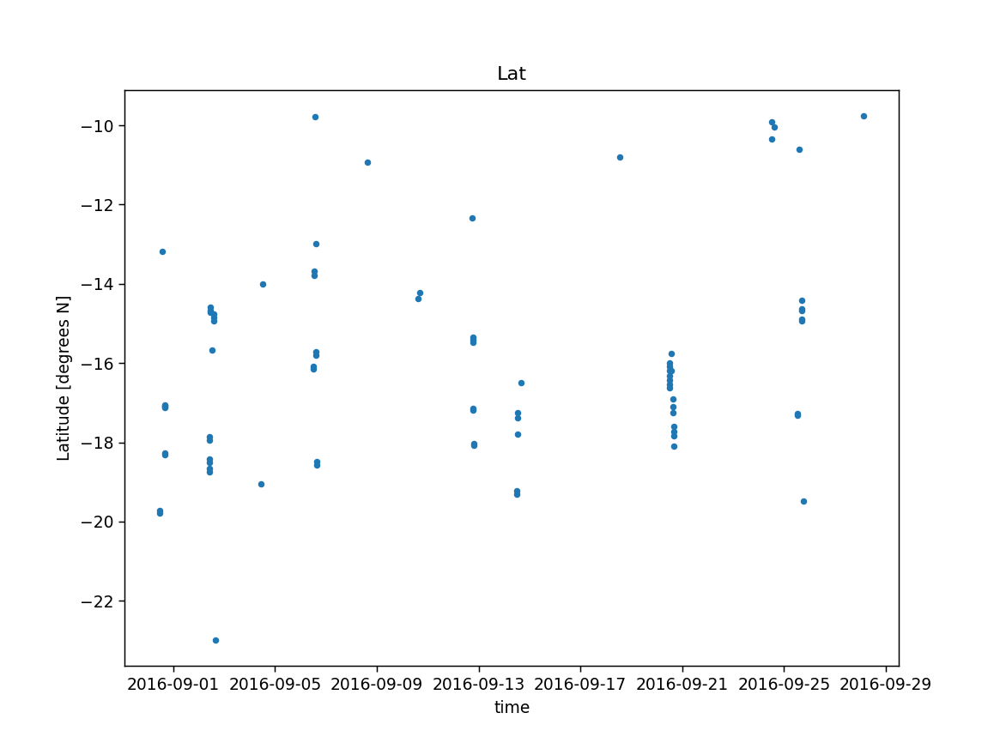

<IPython.core.display.Javascript object>


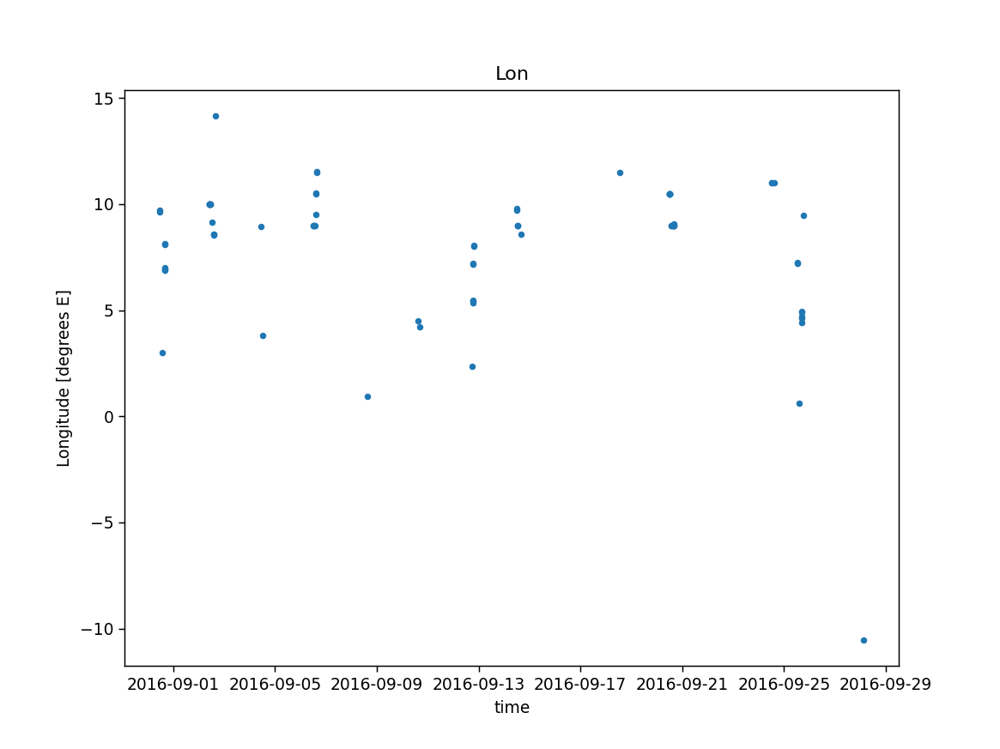

<IPython.core.display.Javascript object>


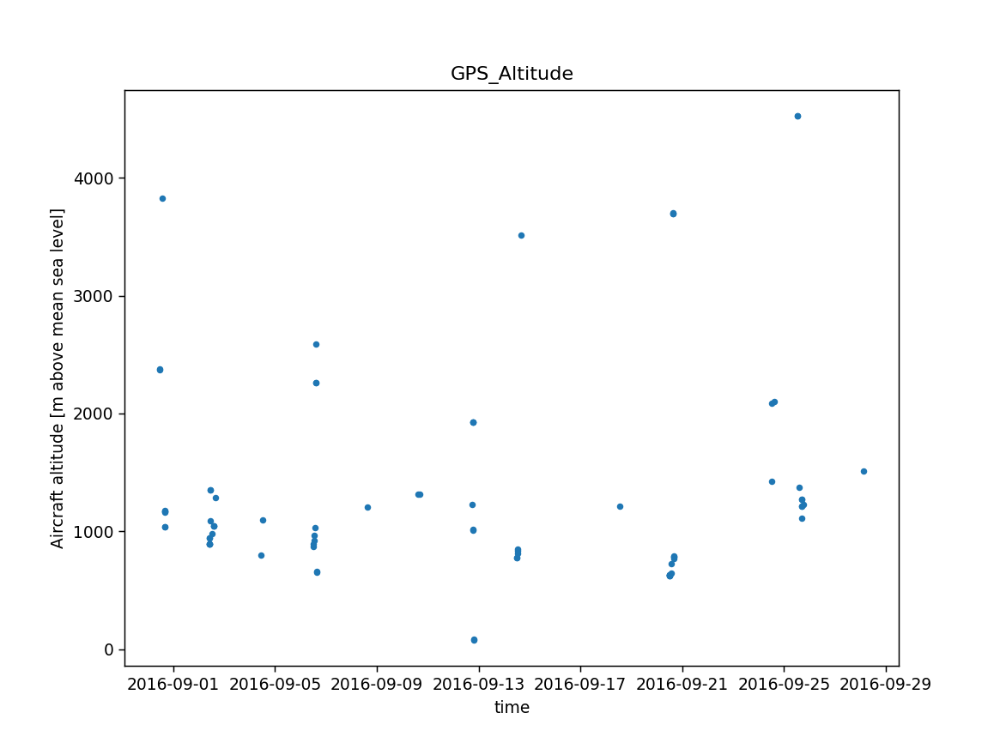

<IPython.core.display.Javascript object>


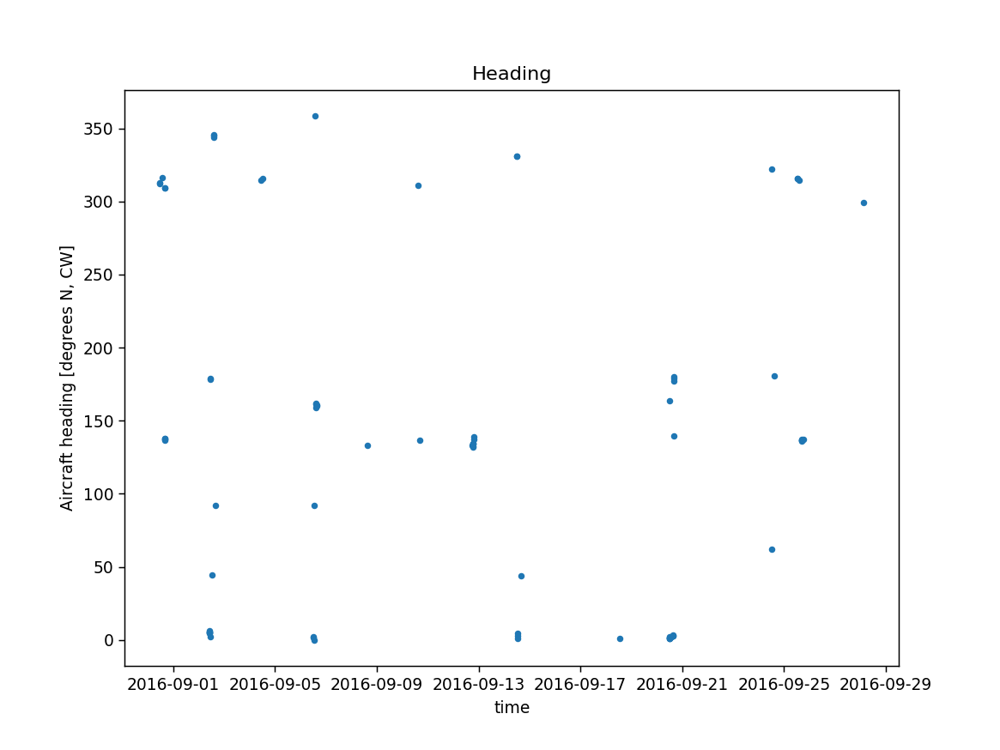

<IPython.core.display.Javascript object>


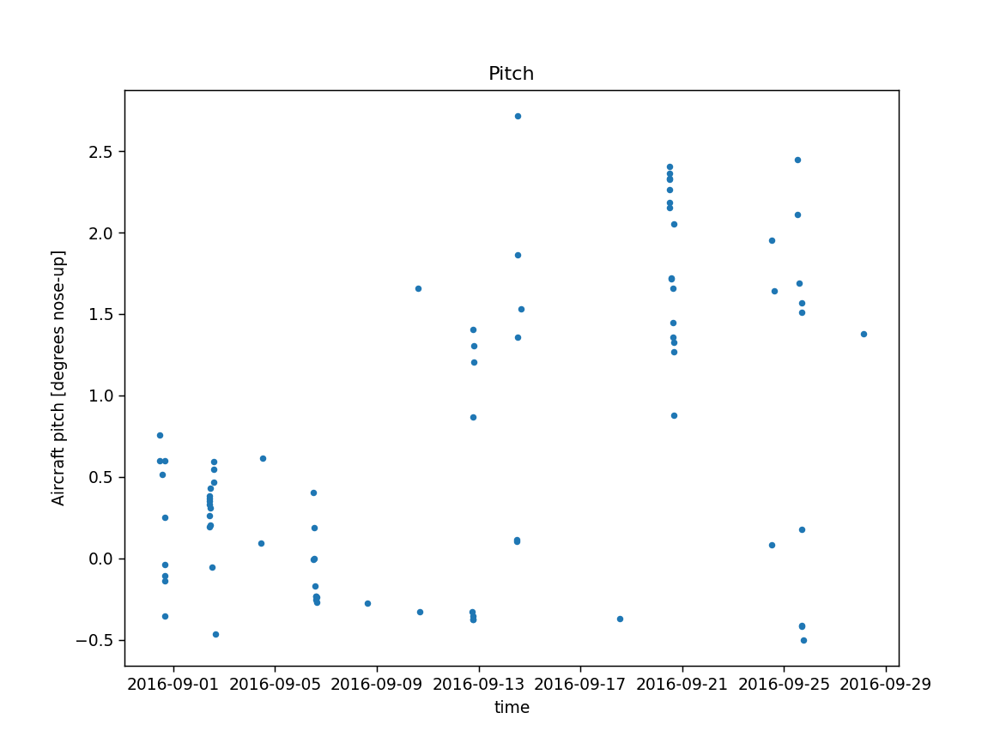

<IPython.core.display.Javascript object>


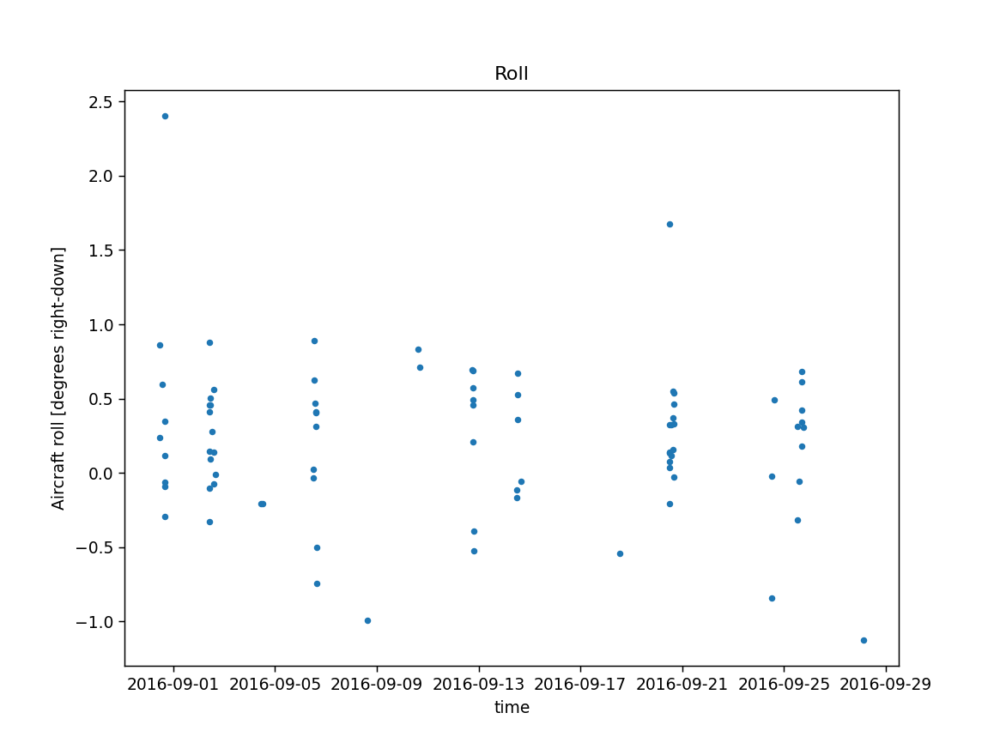

<IPython.core.display.Javascript object>


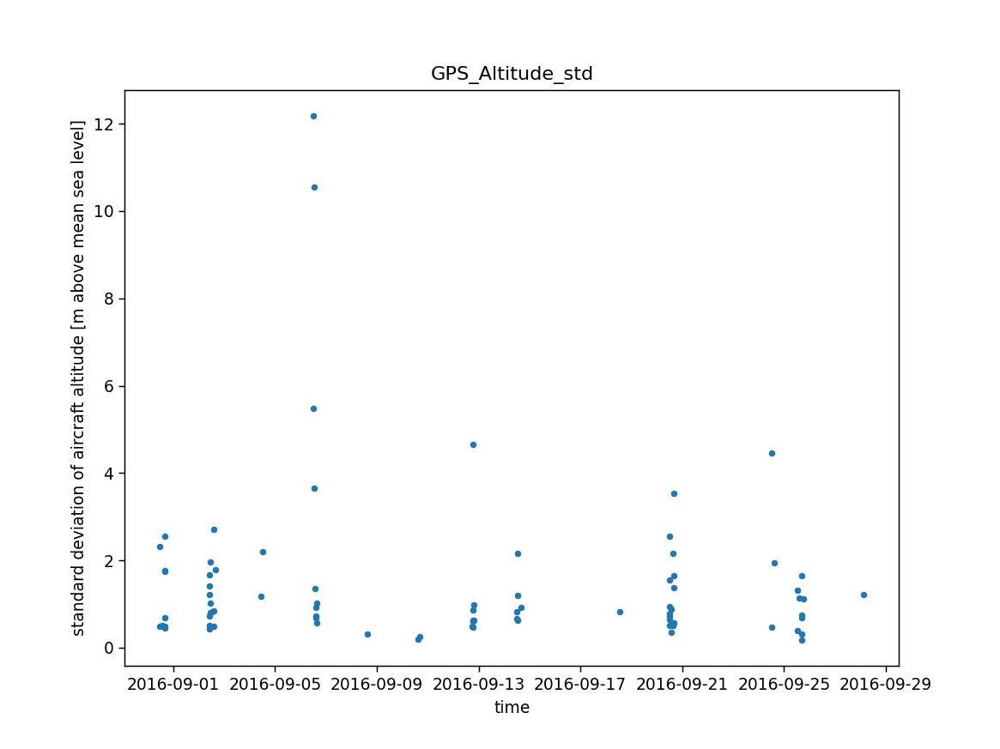

<IPython.core.display.Javascript object>


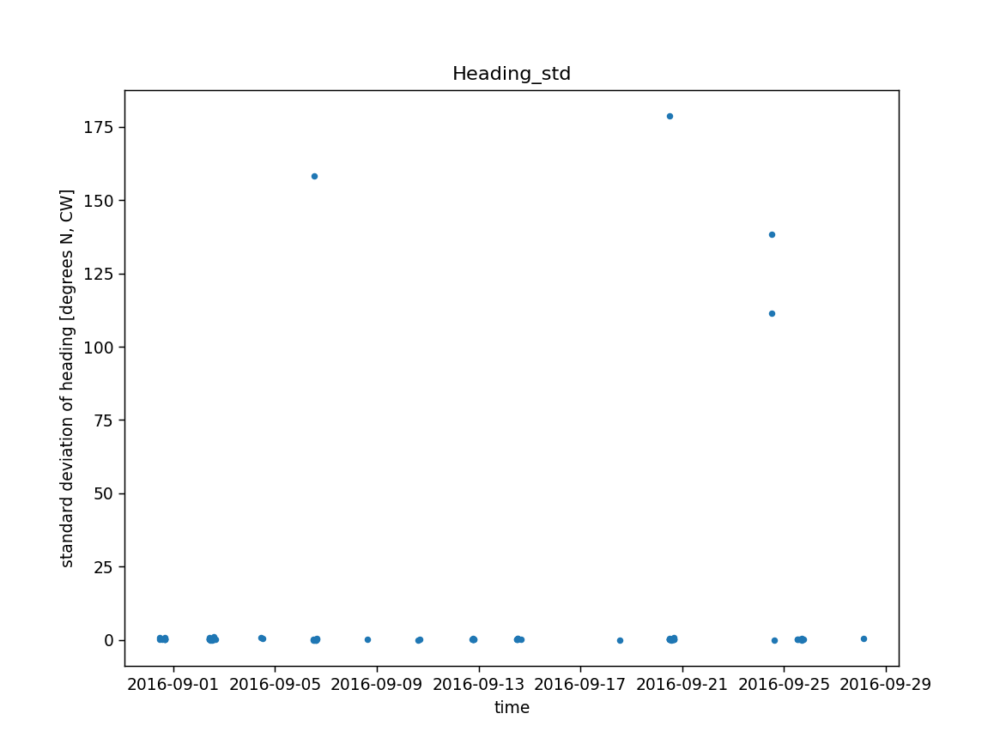

<IPython.core.display.Javascript object>


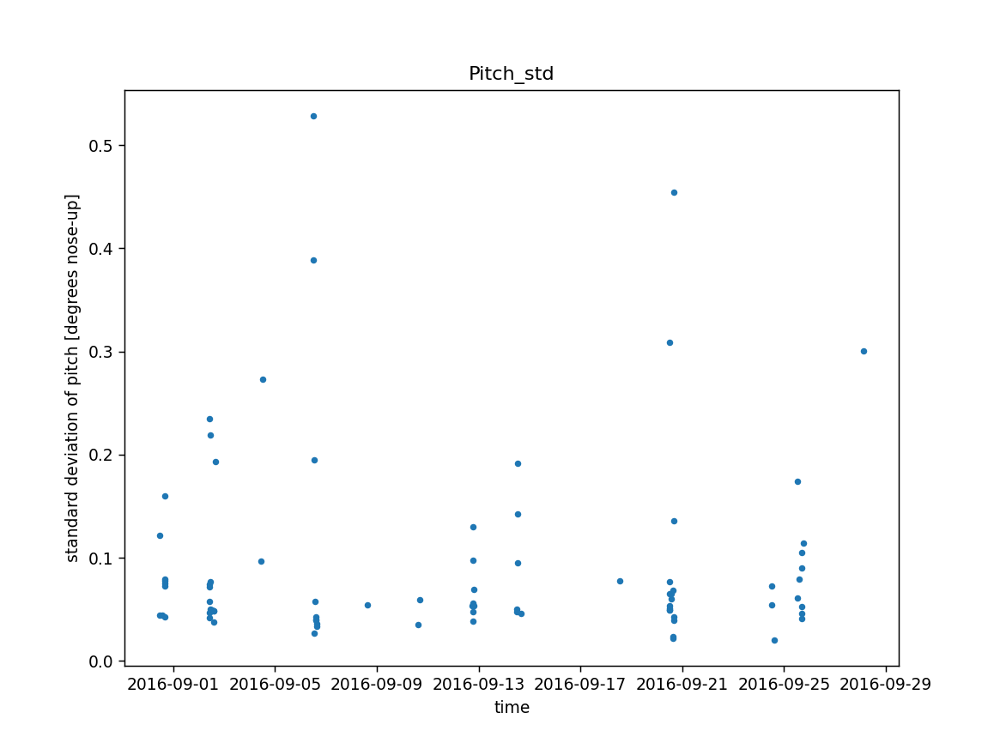

<IPython.core.display.Javascript object>


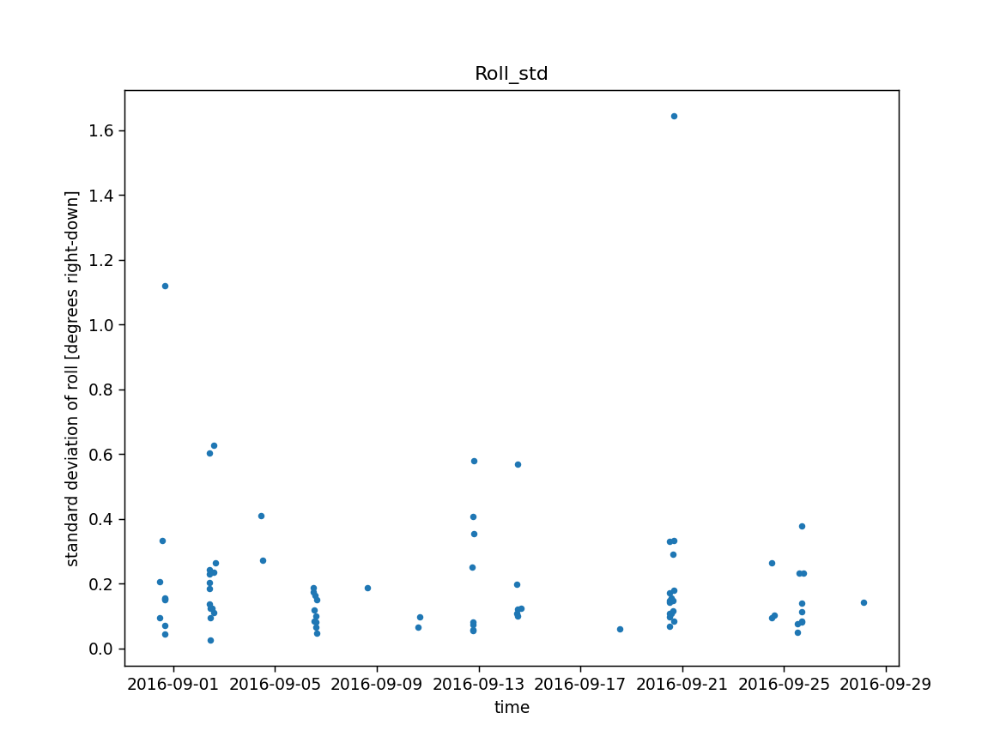

<IPython.core.display.Javascript object>


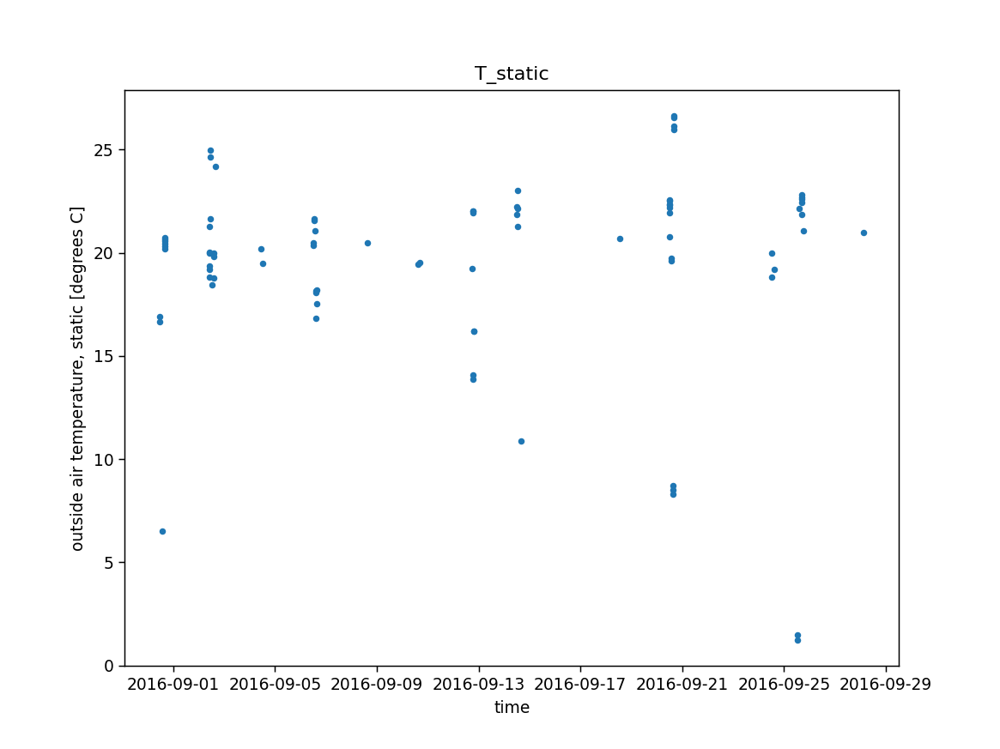

<IPython.core.display.Javascript object>


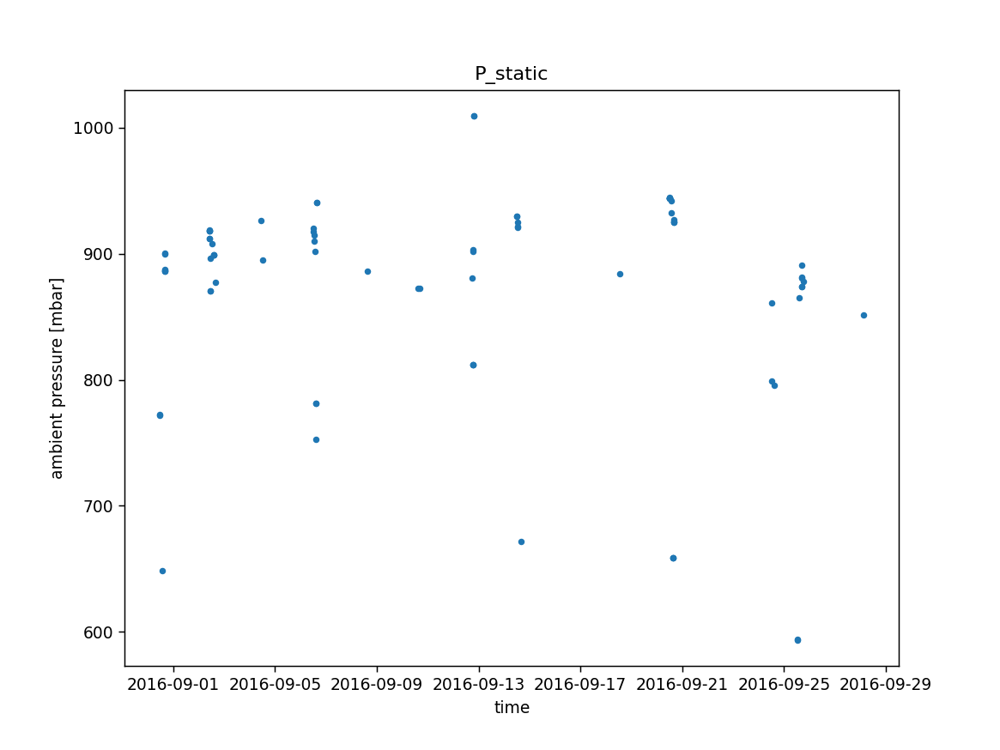

<IPython.core.display.Javascript object>


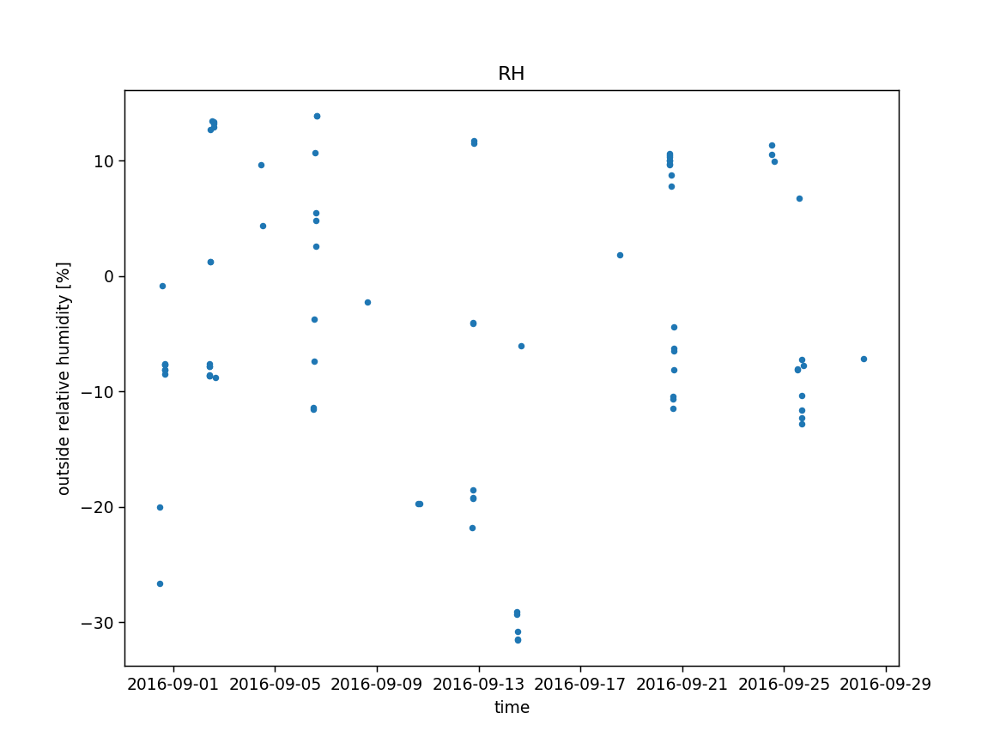

<IPython.core.display.Javascript object>


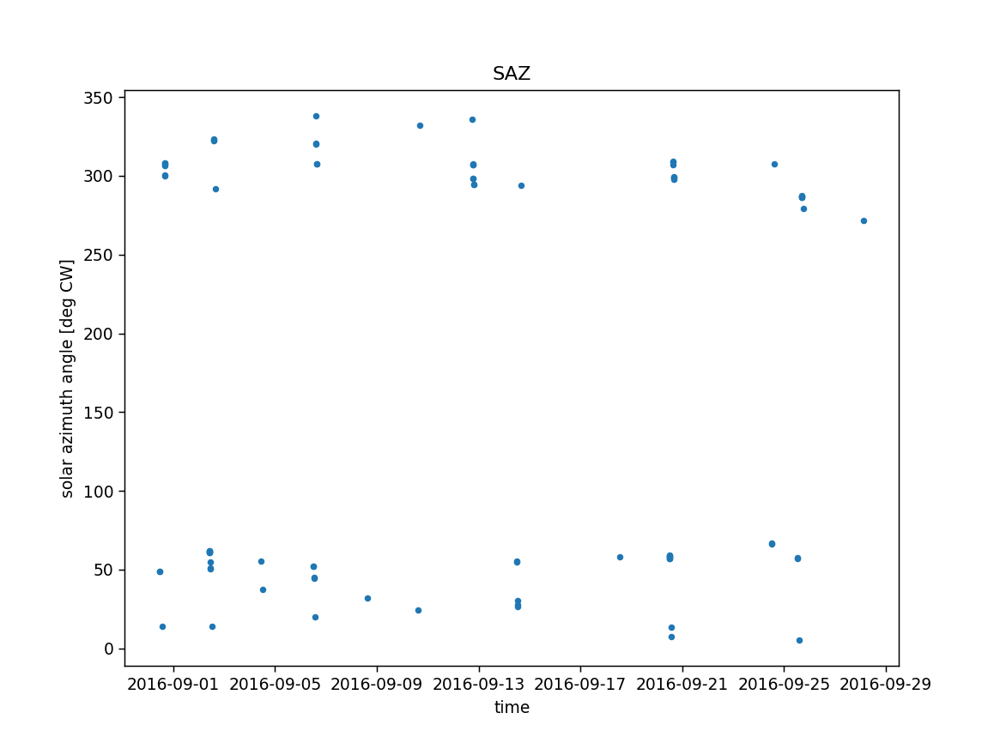

<IPython.core.display.Javascript object>


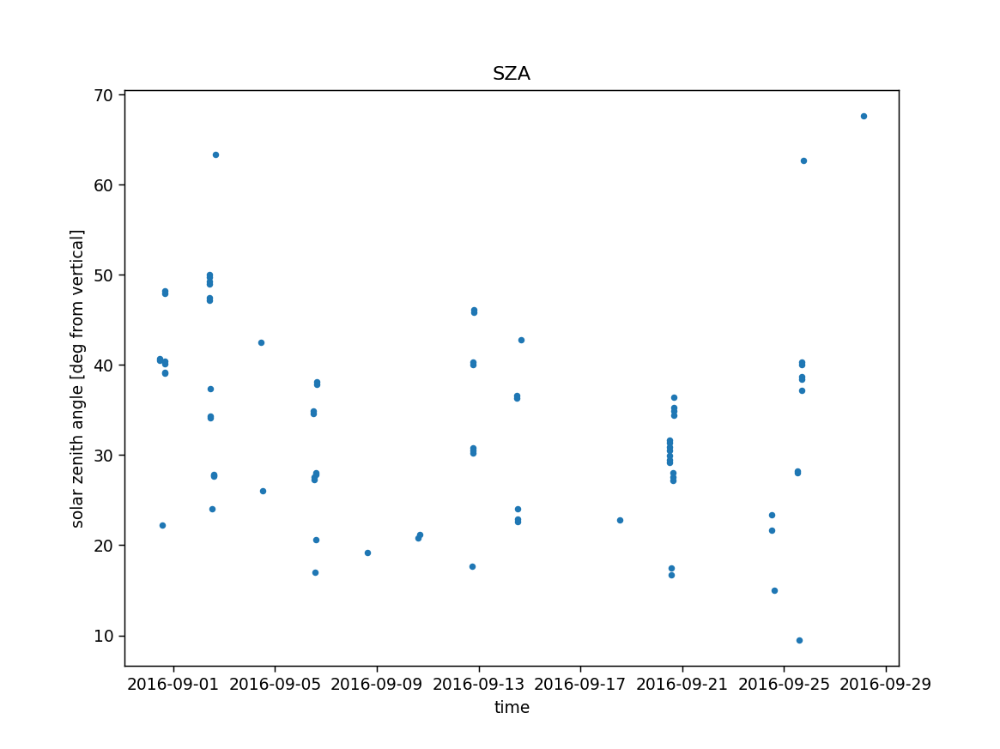

<IPython.core.display.Javascript object>


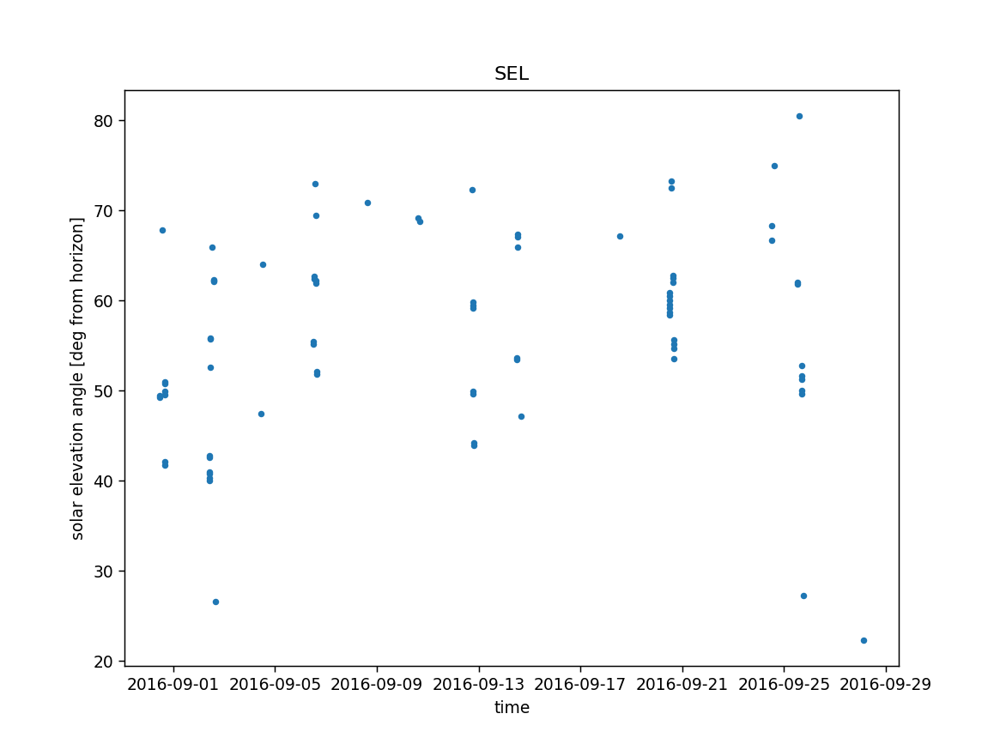

<IPython.core.display.Javascript object>


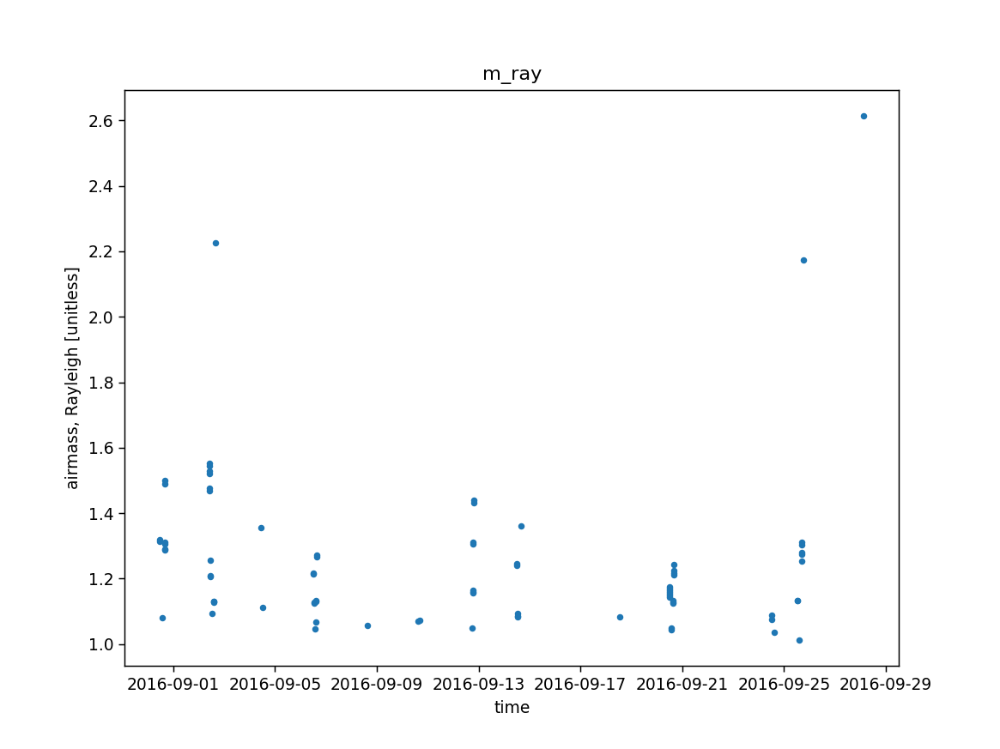

<IPython.core.display.Javascript object>


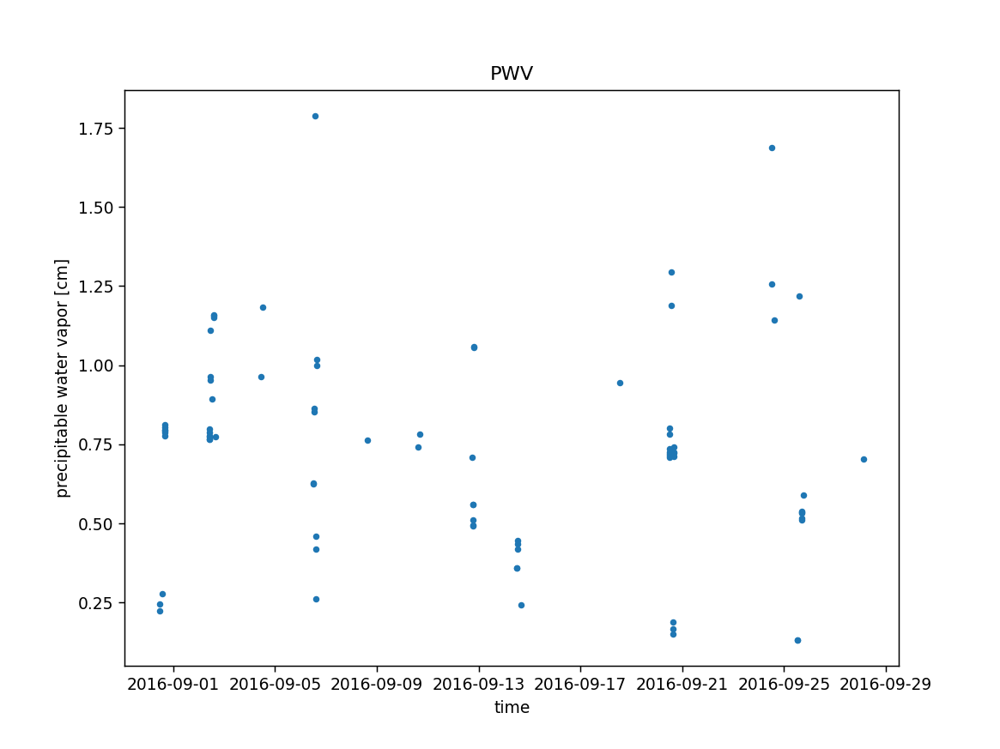

<IPython.core.display.Javascript object>


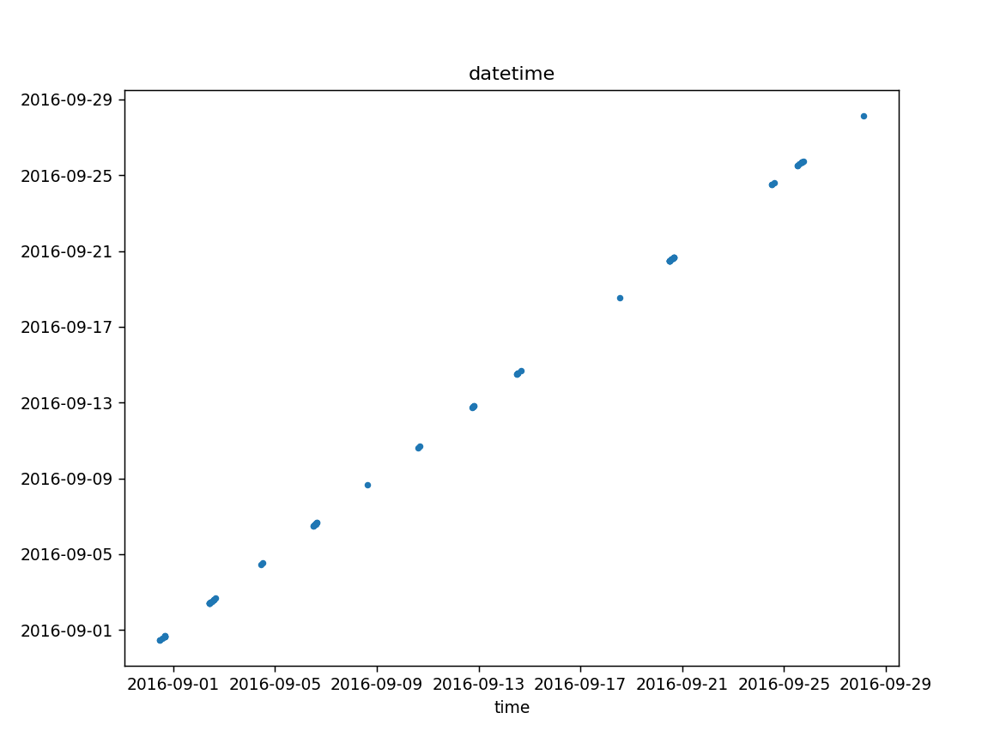

In [74]:
for k in nc_all:
    if nc_all[k].shape == nc_all[b'time'].shape:
        plt.figure()
        plt.plot(nc_all[b'datetime'],nc_all[k],'.')
        try: 
            plt.ylabel(nc_dict_tmp[k].long_name + ' ['+nc_dict_tmp[k].units+']')
        except:
            pass
        plt.xlabel('time')
        plt.title(k.decode())        
        
        plt.savefig(fpo+name+k.decode()+'.png',transparent=True,dpi=500)

<IPython.core.display.Javascript object>


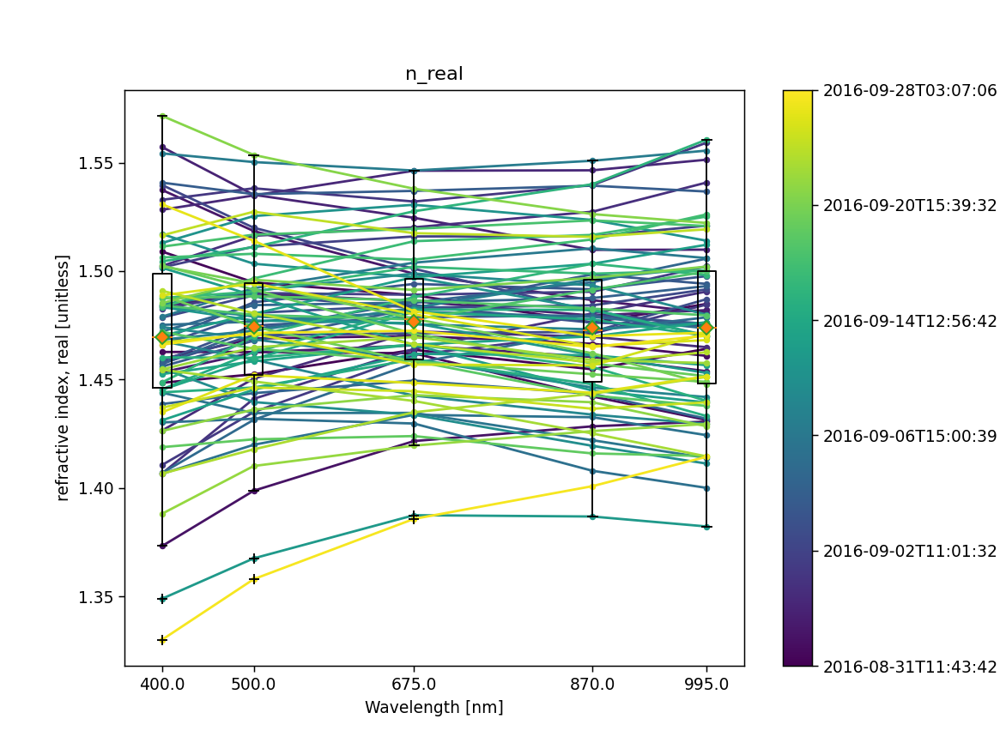

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


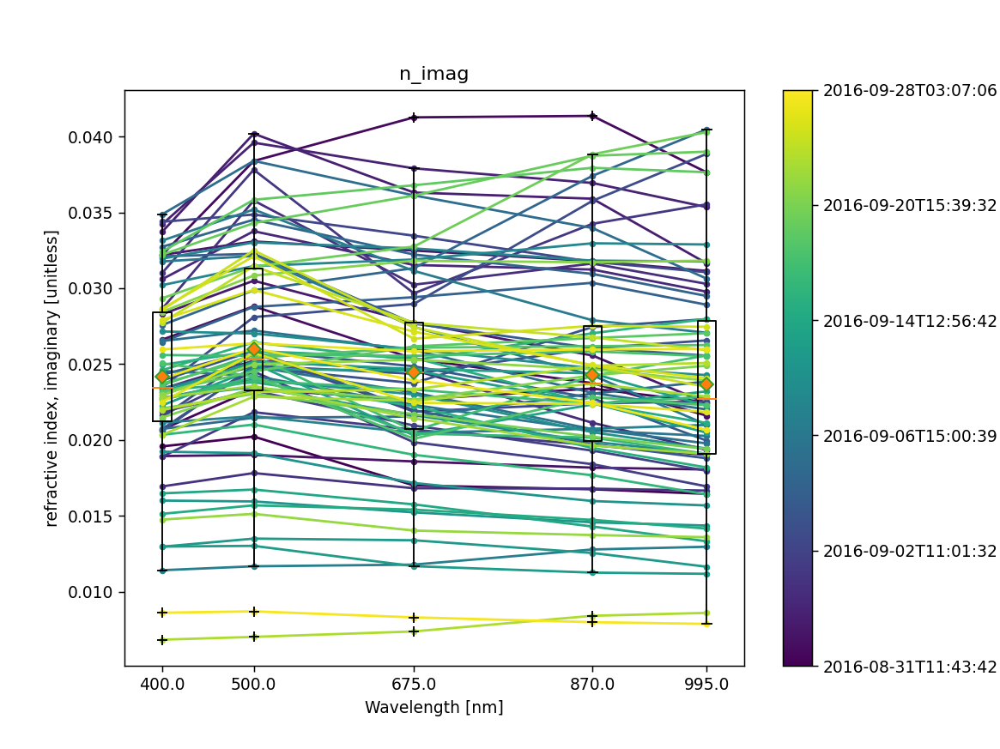

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


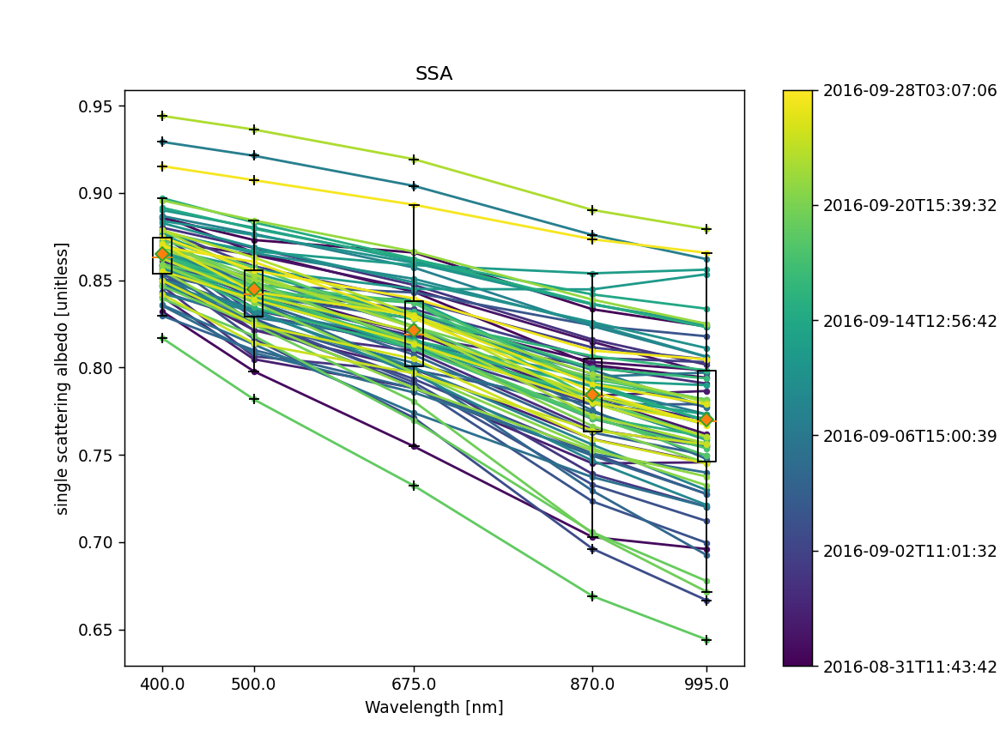

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


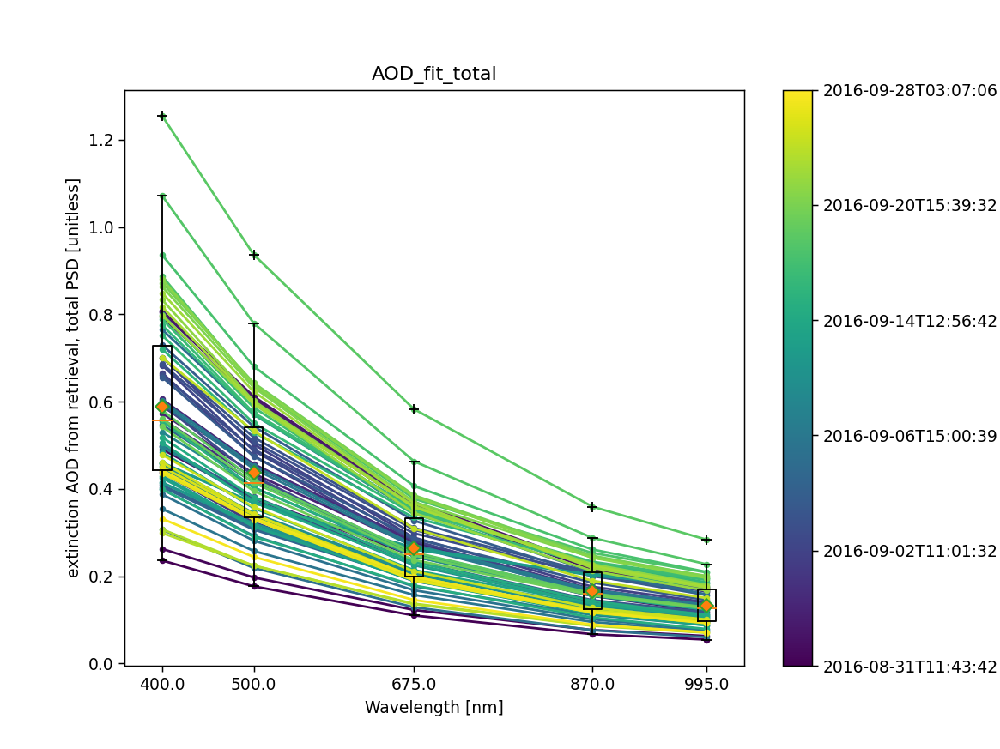

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


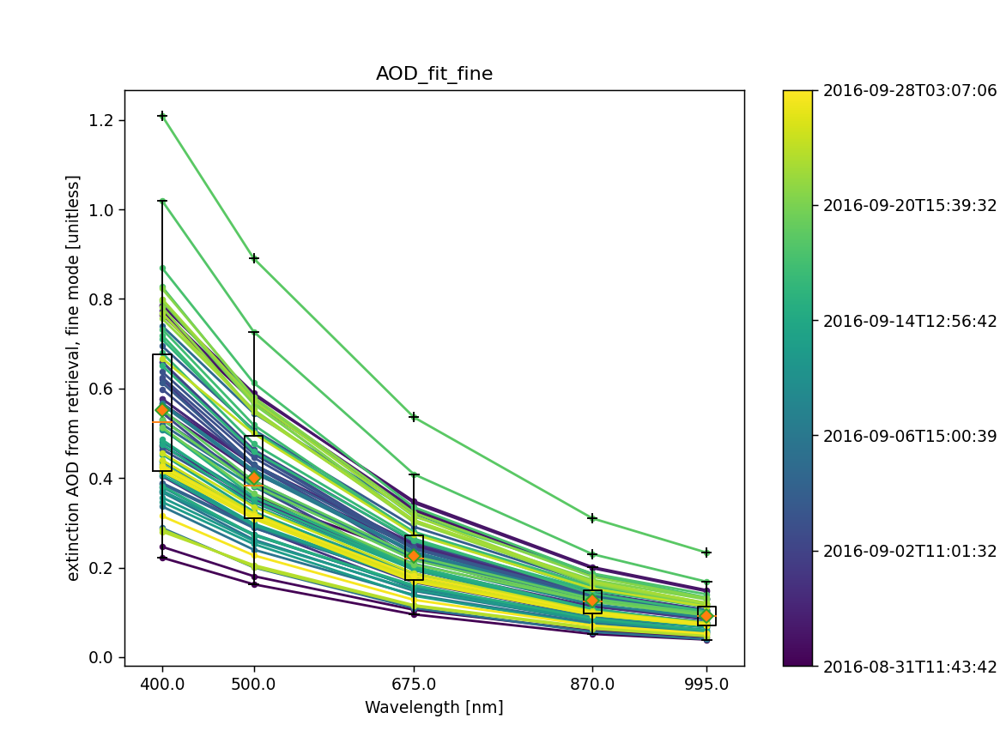

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


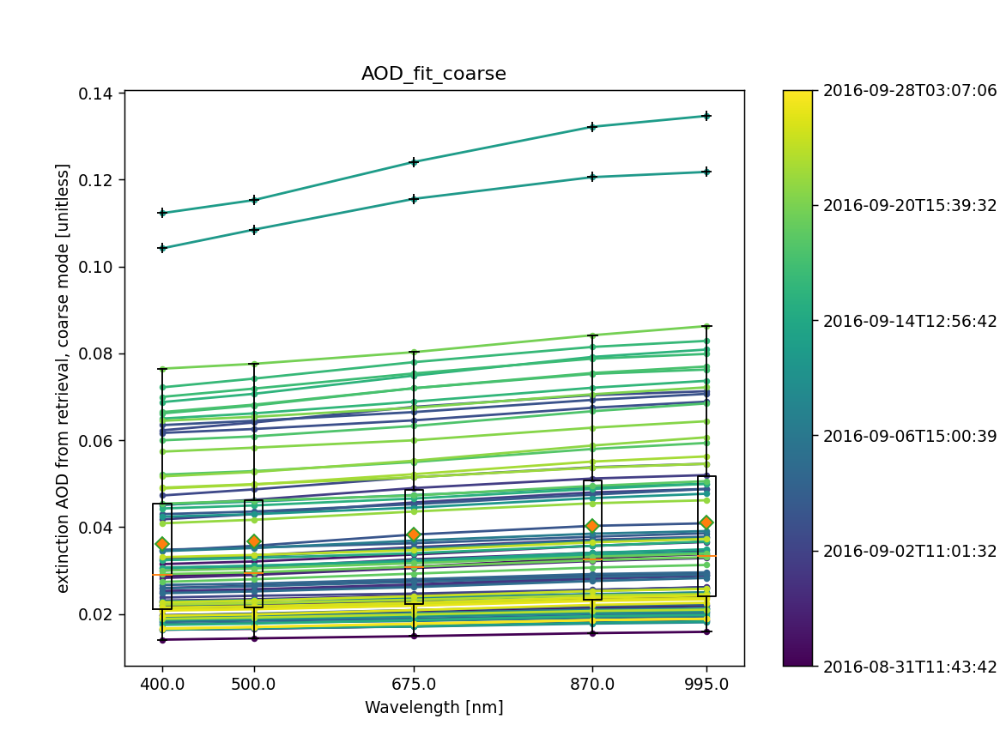

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


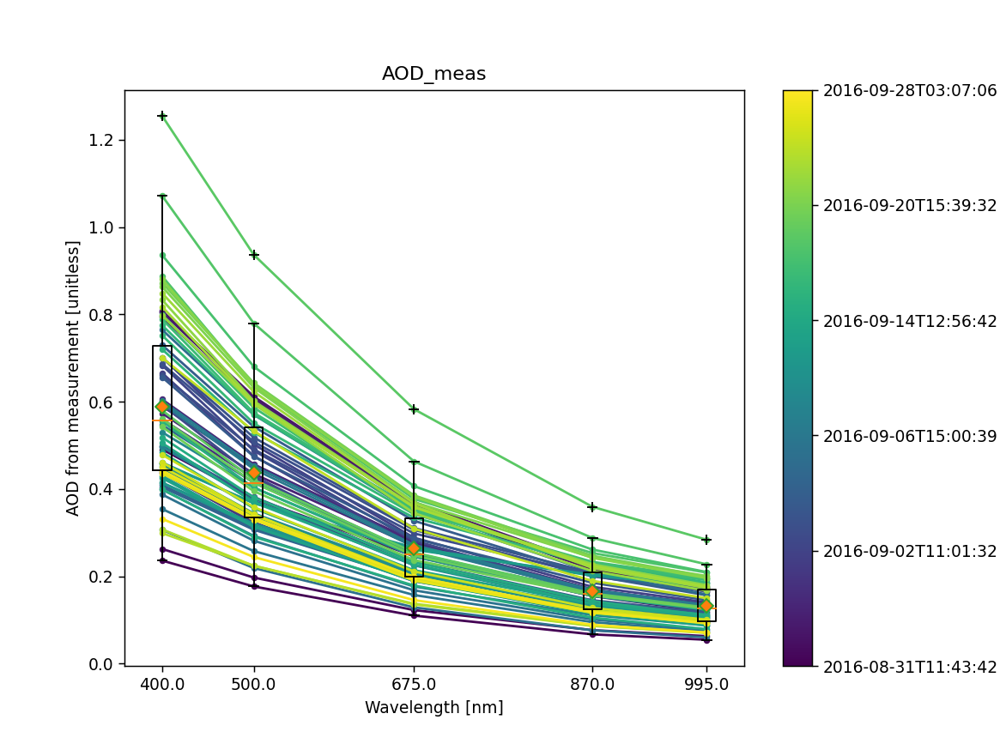

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


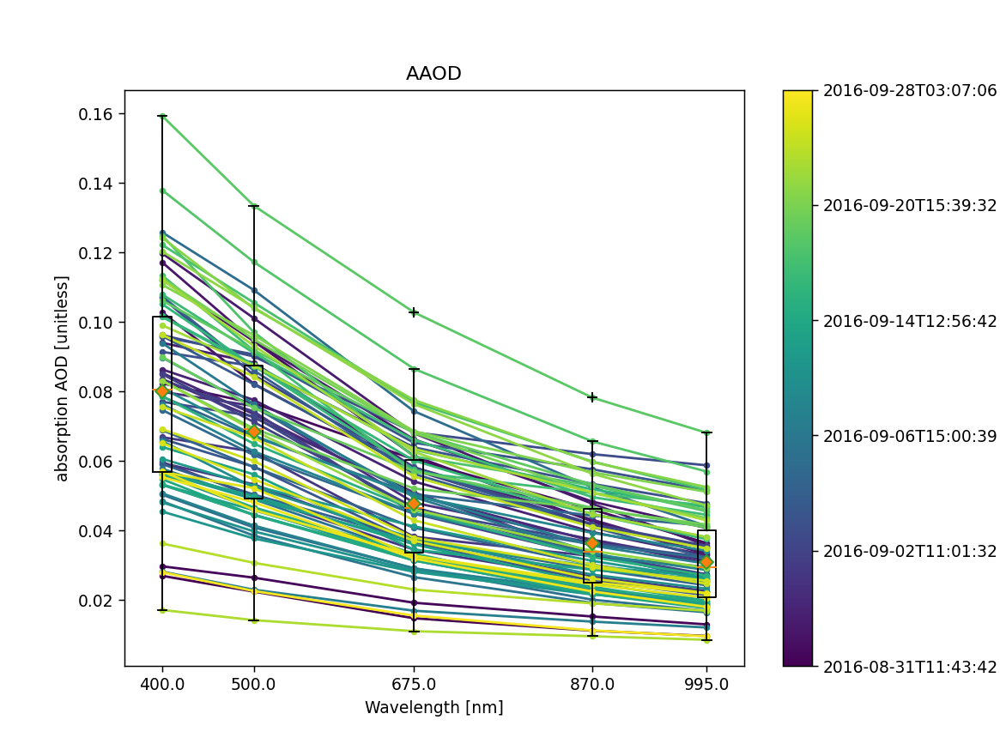

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


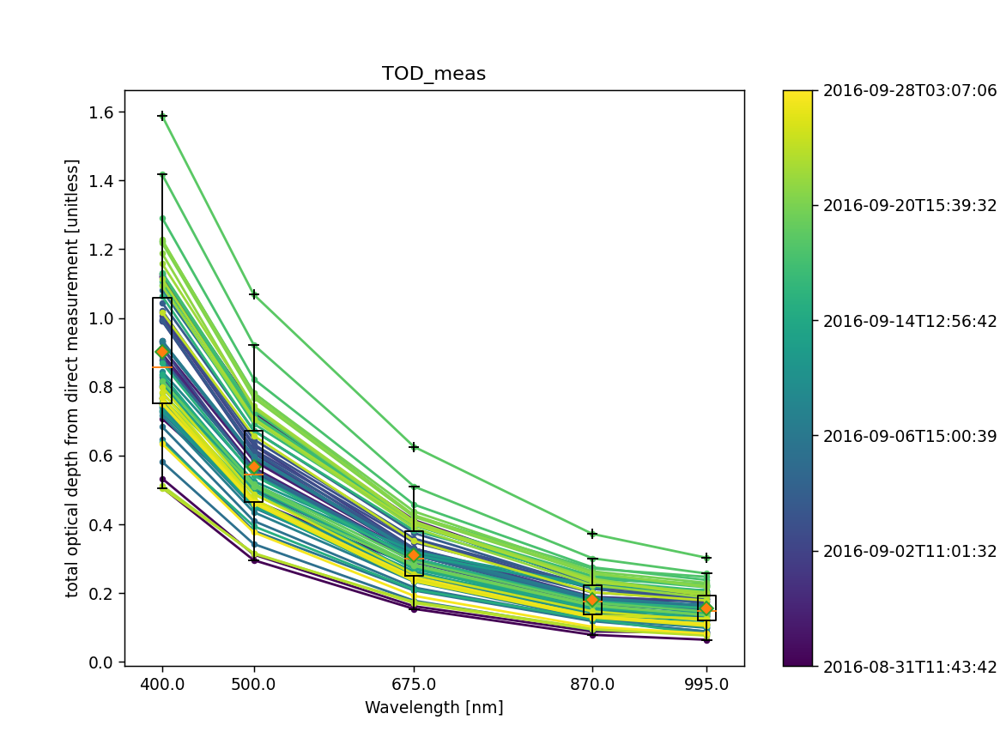

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


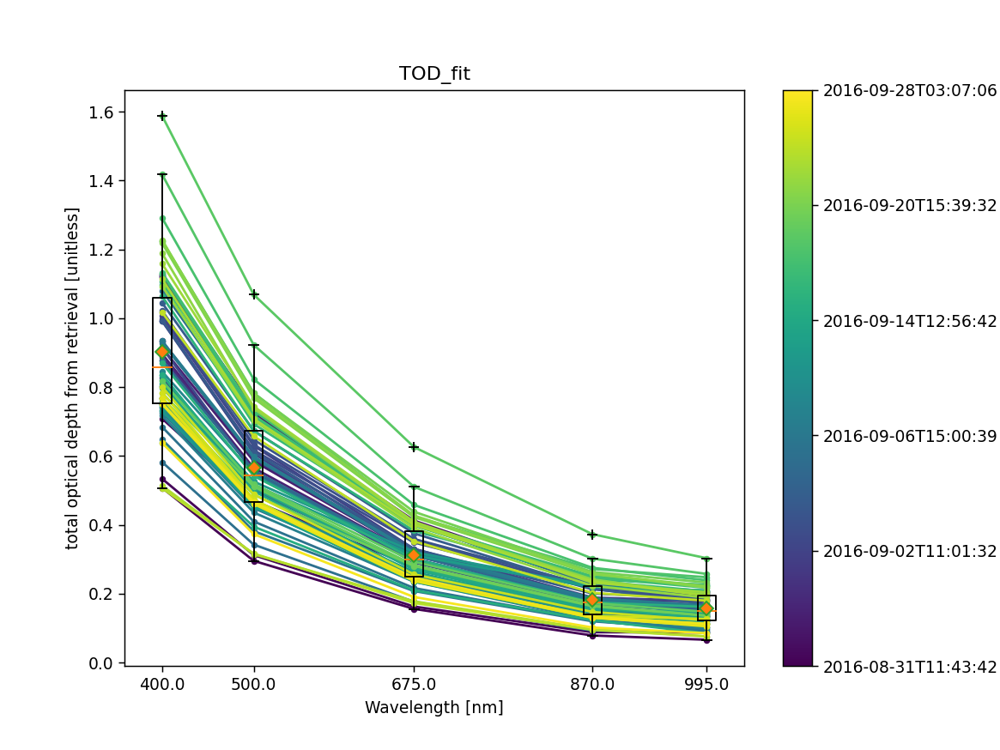

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


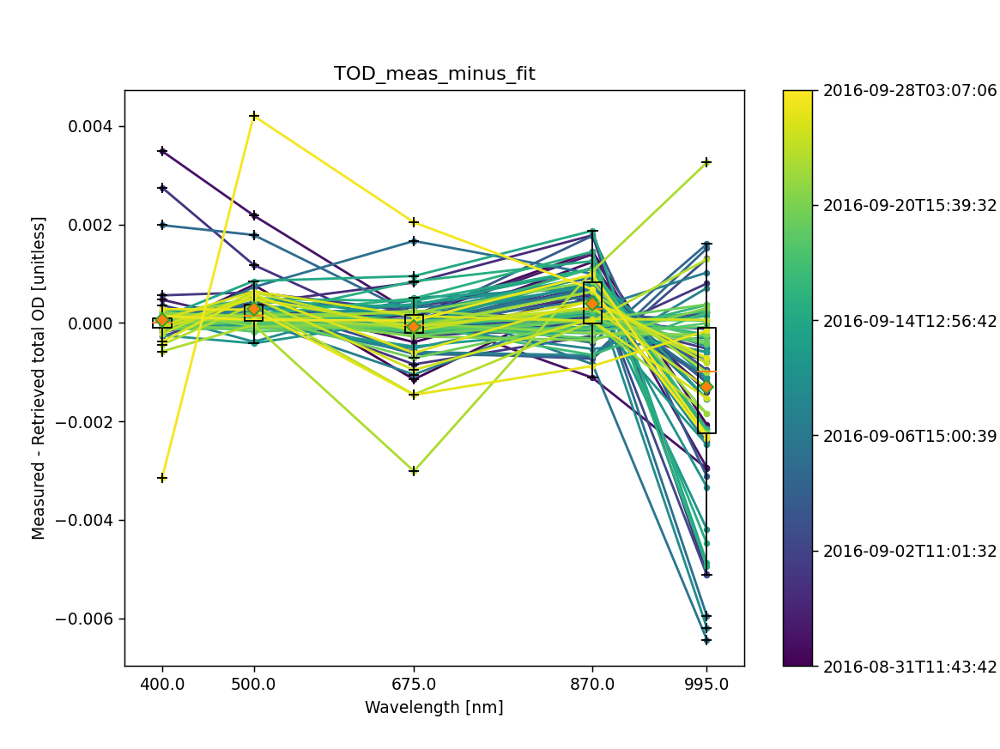

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


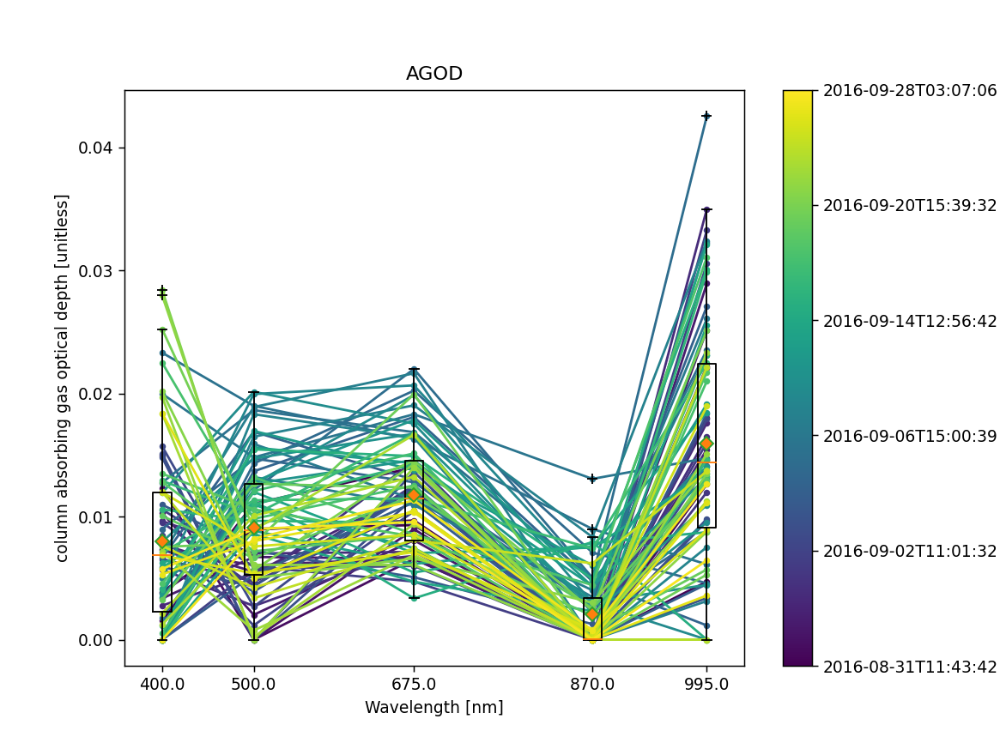

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


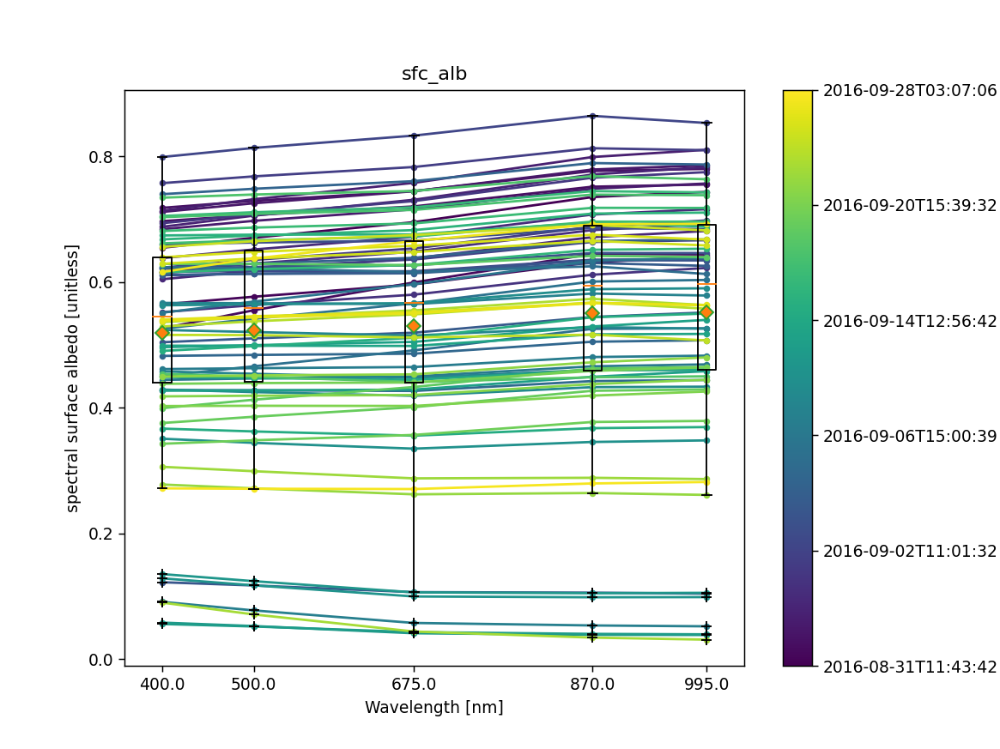

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


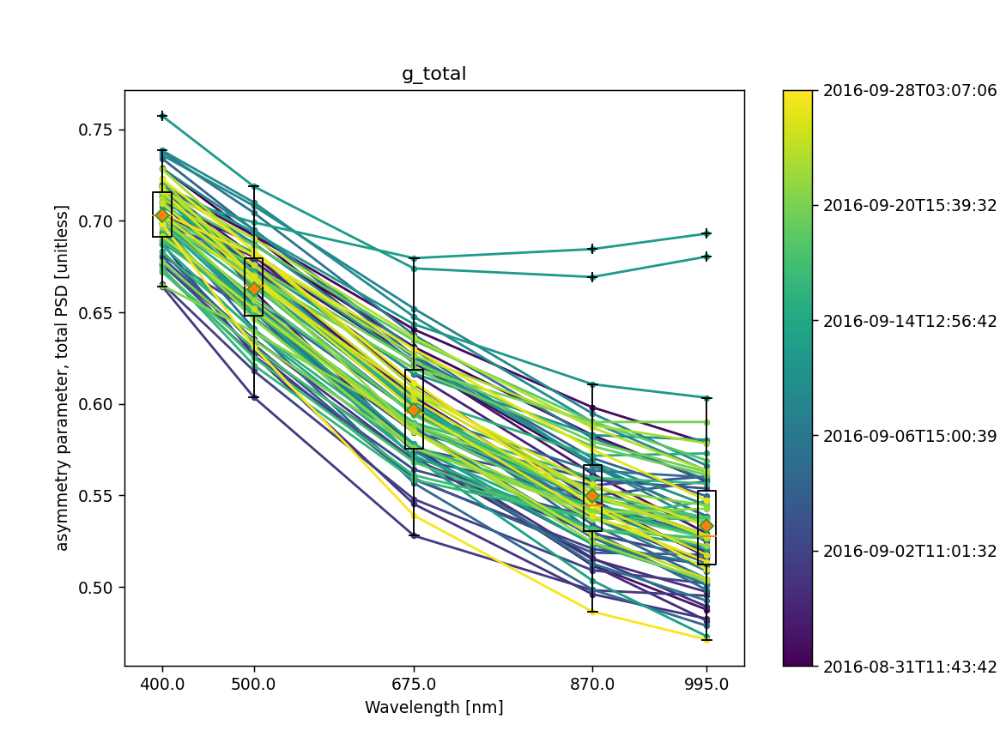

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


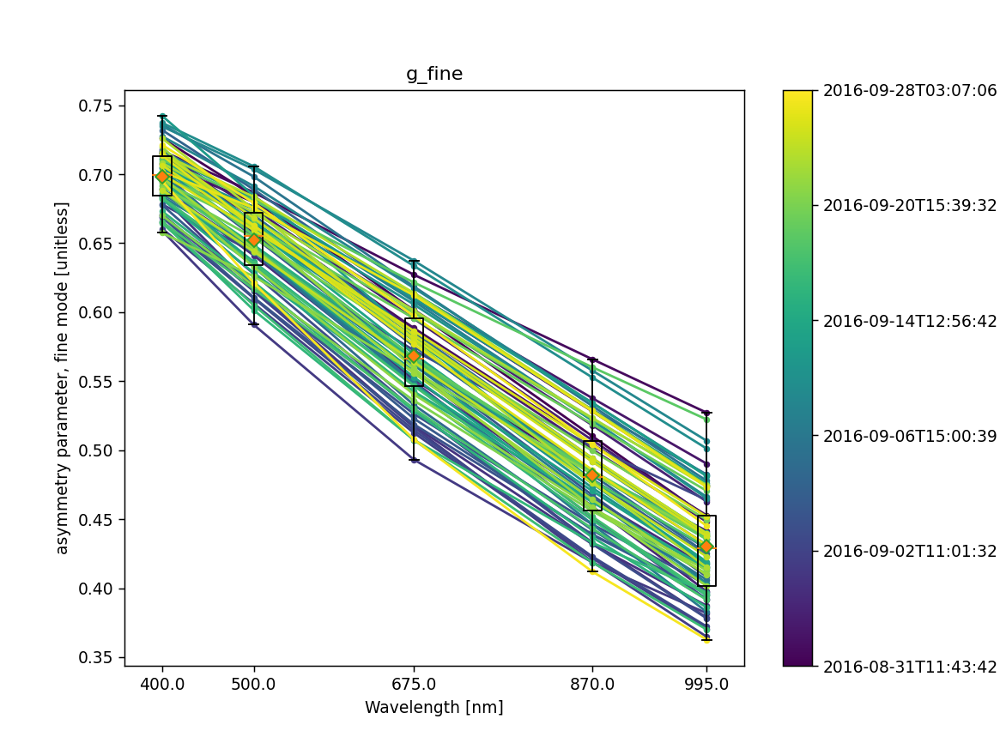

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


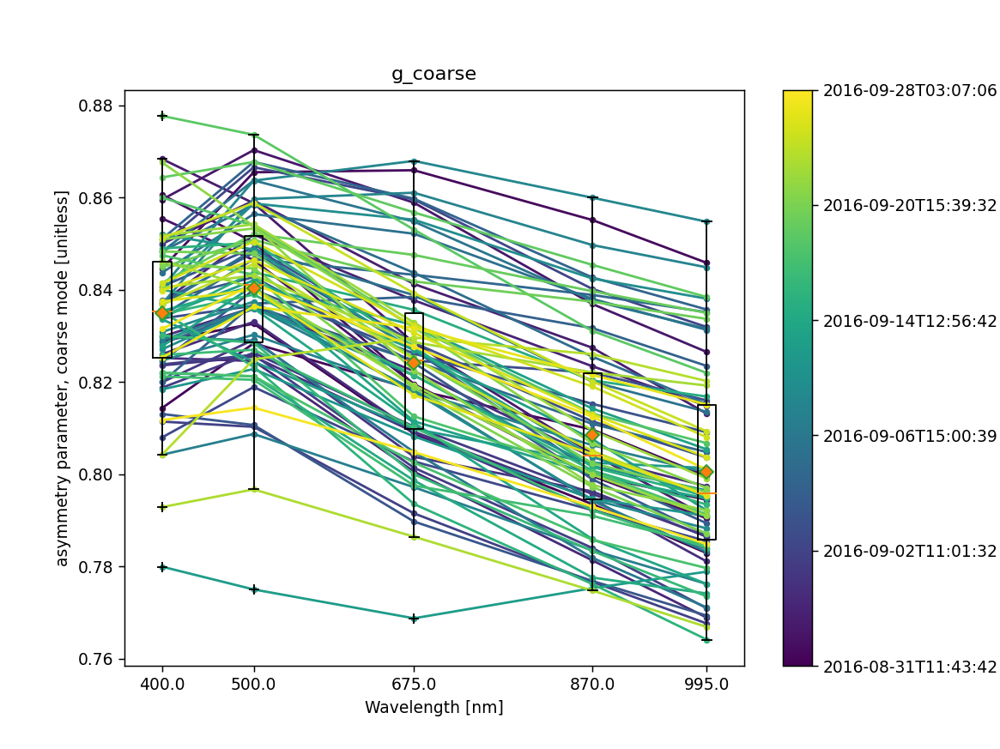

<ipython-input-75-26b0eb0abe2b>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


In [75]:
for k in nc_all:
    if nc_all[k].shape == nc_all[b'SSA'].shape:
        plt.figure()
        plt.gca().set_prop_cycle(color=[plt.cm.viridis(k) for k in np.linspace(0, 1, len(nc_all[b'time'])+1)])
        plt.plot(nc_all[b'wavelength'],nc_all[k].T,'.-')
        plt.boxplot(nc_all[k],positions=nc_all[b'wavelength'],widths=20.0,showmeans=True,sym='+',meanprops={'markerfacecolor':'tab:orange','marker':'D'})
        plt.xlabel('Wavelength [nm]')
        plt.ylabel(nc_dict_tmp[k].long_name + ' ['+nc_dict_tmp[k].units+']')
        plt.title(k.decode())
        scalarmap = plt.cm.ScalarMappable(cmap=plt.cm.viridis)
        scalarmap.set_array(np.linspace(0, 1, len(nc_all[b'time'])+1))
        cb = plt.colorbar(scalarmap)
        indexes = [np.argmin(abs(np.linspace(0, 1, len(nc_all[b'time']))-ti)) for ti in cb.get_ticks()]
        cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])
        
        plt.savefig(fpo+name+k.decode()+'.png',transparent=True,dpi=500)

<IPython.core.display.Javascript object>


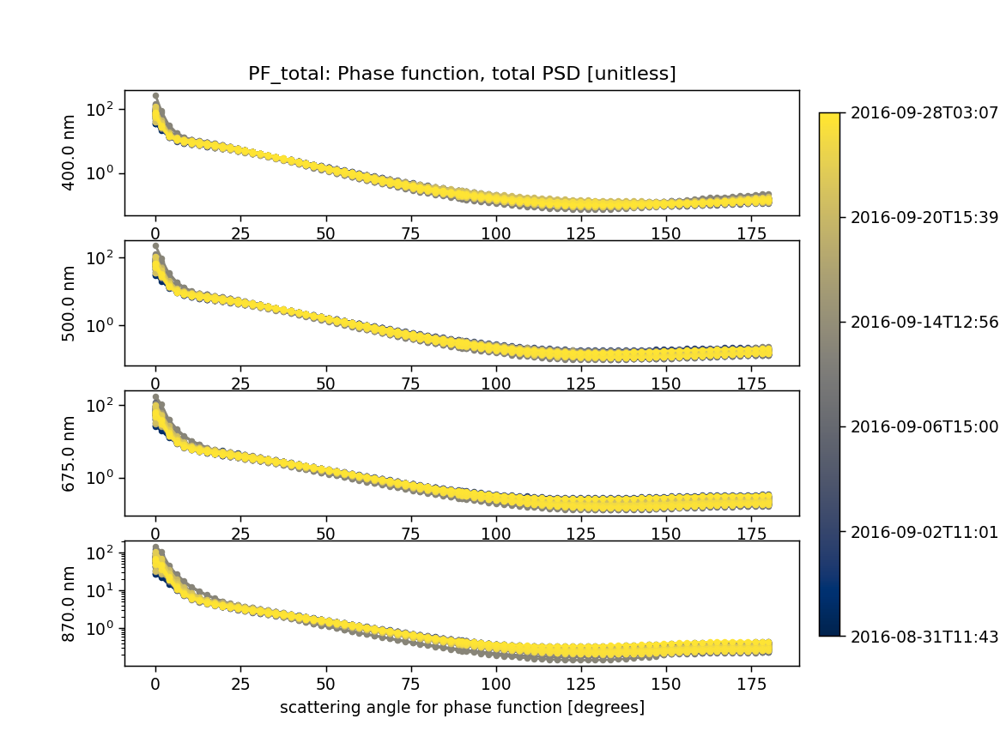

<ipython-input-76-a8a0ba7048fb>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


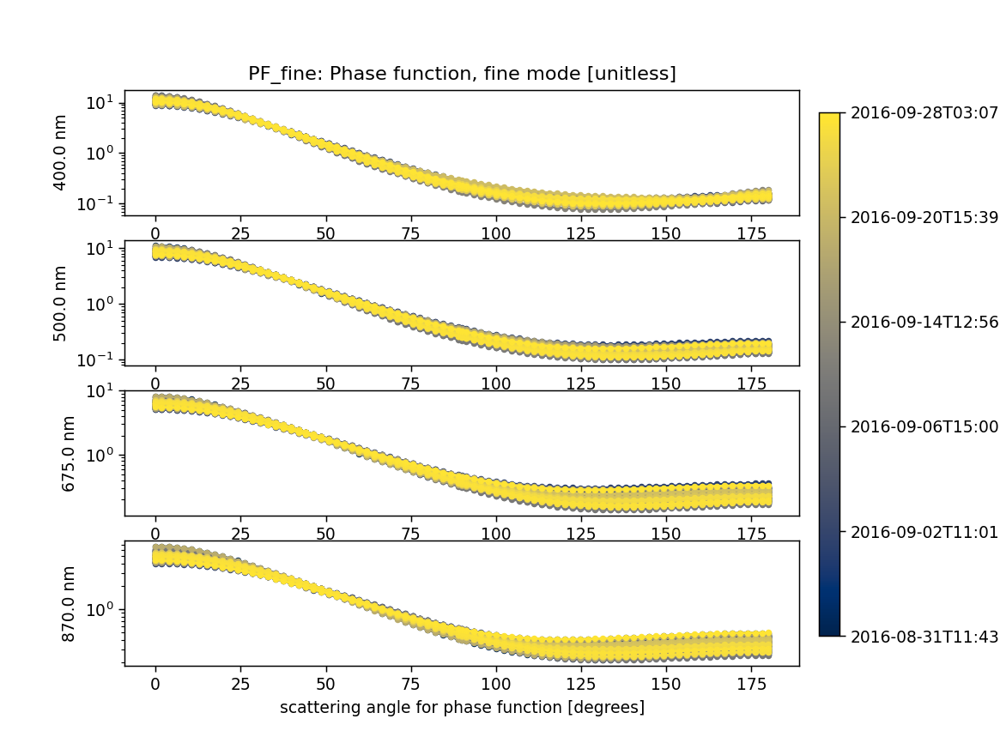

<ipython-input-76-a8a0ba7048fb>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


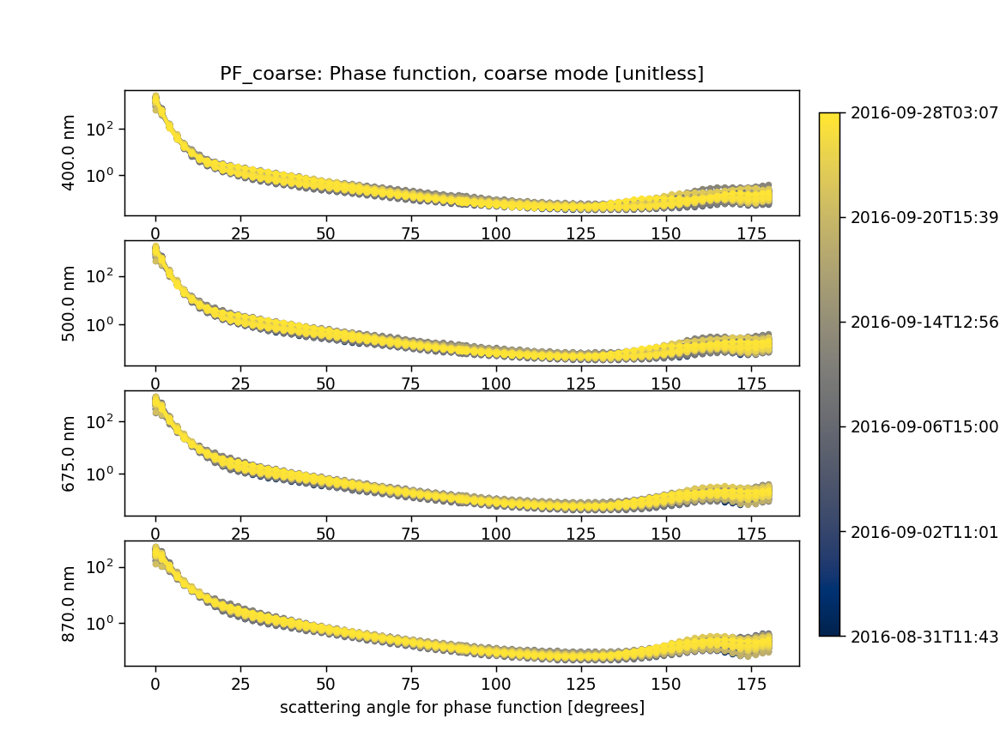

<ipython-input-76-a8a0ba7048fb>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


In [76]:
for k in nc_all:
    if nc_all[k].shape == nc_all[b'PF_coarse'].shape:
        fig,ax = plt.subplots(4,1)
        for i in range(4):
            ax[i].set_prop_cycle(color=[plt.cm.cividis(k) for k in np.linspace(0, 1, len(nc_all[b'time'])+1)])
            ax[i].plot(nc_all[b'PF_angle'],nc_all[k][:,i,:].T,'.-')
            ax[i].set_ylabel('{} nm'.format(nc_all[b'wavelength'][i]))
            ax[i].set_yscale('log')

        ax[0].set_title(k.decode()+': '+nc_dict_tmp[k].long_name + ' ['+nc_dict_tmp[k].units+']')
        ax[-1].set_xlabel(nc_dict_tmp[b'PF_angle'].long_name + ' ['+nc_dict_tmp[b'PF_angle'].units+']')
        fig.subplots_adjust(right=0.8)
        cbar_ax = fig.add_axes([0.82, 0.15, 0.02, 0.7])
        scalarmap = plt.cm.ScalarMappable(cmap=plt.cm.cividis)
        scalarmap.set_array(np.linspace(0, 1, len(nc_all[b'time'])+1))
        cb = plt.colorbar(scalarmap,cax=cbar_ax)
        indexes = [np.argmin(abs(np.linspace(0, 1, len(nc_all[b'time']))-ti)) for ti in cb.get_ticks()]
        cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])
        
        
        plt.savefig(fpo+name+k.decode()+'.png',transparent=True,dpi=500)
        

<IPython.core.display.Javascript object>


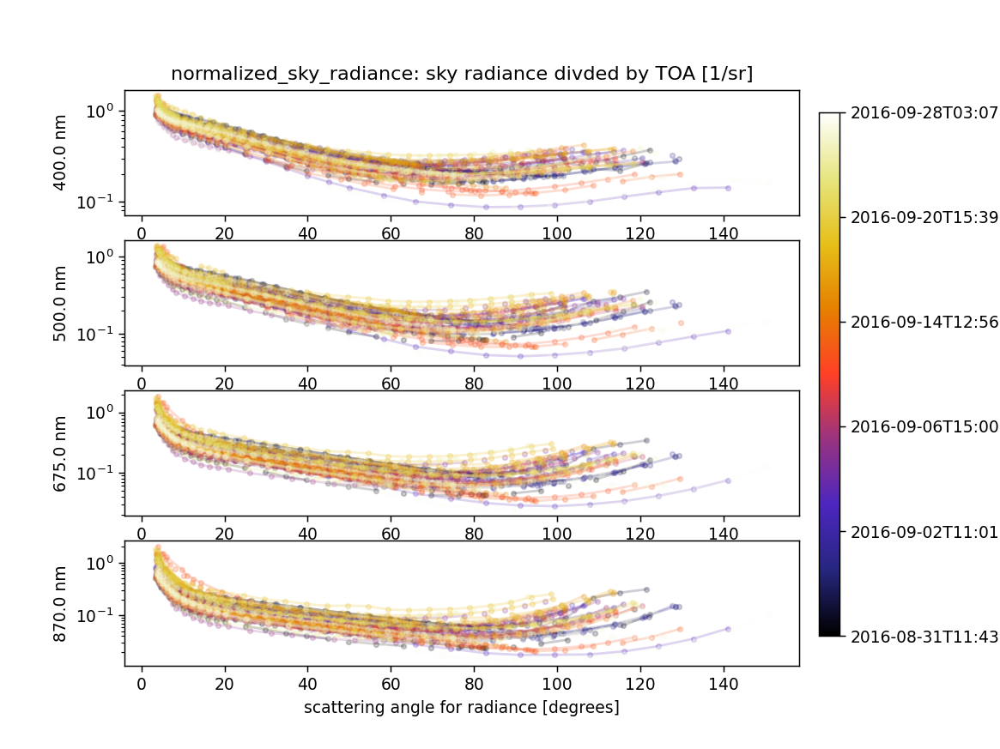

<ipython-input-77-b5c66737a6e1>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


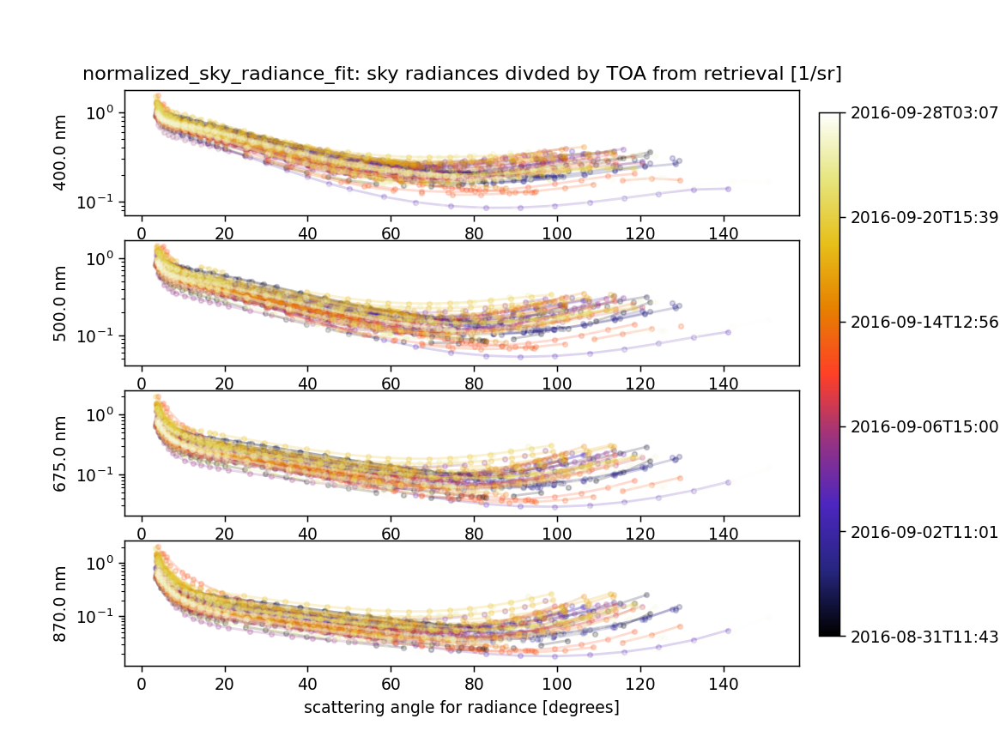

<ipython-input-77-b5c66737a6e1>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


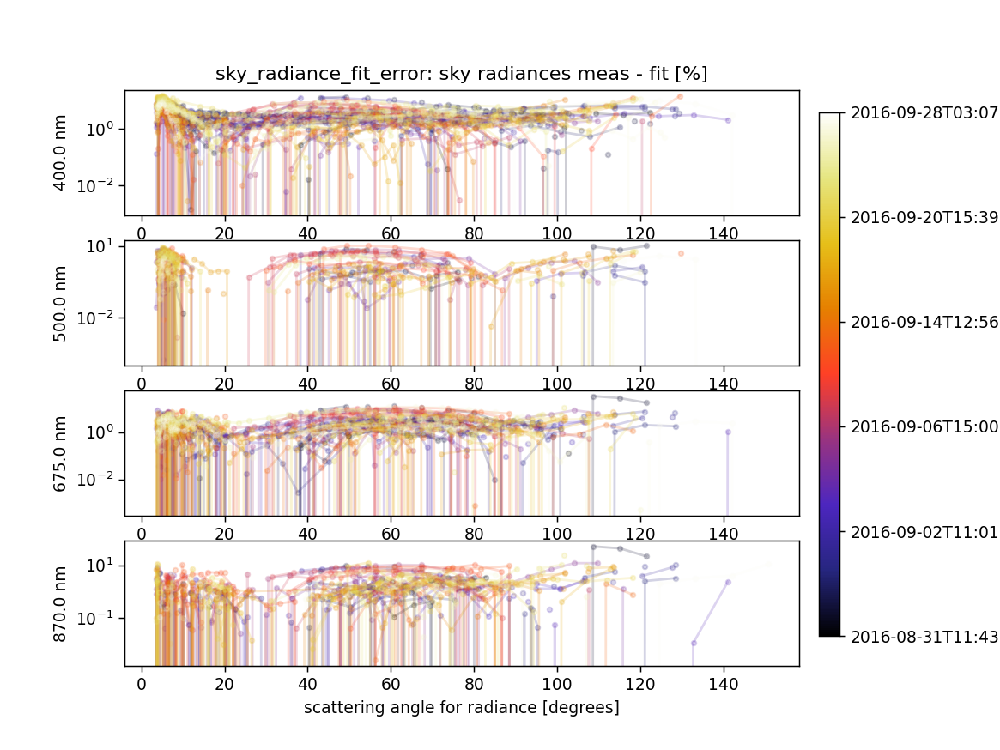

<ipython-input-77-b5c66737a6e1>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


In [77]:
for k in nc_all:
    if nc_all[k].shape == nc_all[b'normalized_sky_radiance'].shape:
        fig,ax = plt.subplots(4,1)
        for i in range(4):
            ax[i].set_prop_cycle(color=[plt.cm.CMRmap(k) for k in np.linspace(0, 1, len(nc_all[b'time'])+1)])
            ax[i].plot(nc_all[b'sca_angle'].T,nc_all[k][:,i,:].T,'.-',alpha=0.2)
            ax[i].set_ylabel('{} nm'.format(nc_all[b'wavelength'][i]))
            ax[i].set_yscale('log')

        ax[0].set_title(k.decode()+': '+nc_dict_tmp[k].long_name + ' ['+nc_dict_tmp[k].units+']')
        ax[-1].set_xlabel(nc_dict_tmp[b'sca_angle'].long_name + ' ['+nc_dict_tmp[b'sca_angle'].units+']')
        fig.subplots_adjust(right=0.8)
        cbar_ax = fig.add_axes([0.82, 0.15, 0.02, 0.7])
        scalarmap = plt.cm.ScalarMappable(cmap=plt.cm.CMRmap)
        scalarmap.set_array(np.linspace(0, 1, len(nc_all[b'time'])+1))
        cb = plt.colorbar(scalarmap,cax=cbar_ax)
        indexes = [np.argmin(abs(np.linspace(0, 1, len(nc_all[b'time']))-ti)) for ti in cb.get_ticks()]
        cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])
        
        plt.savefig(fpo+name+k.decode()+'.png',transparent=True,dpi=500)

<IPython.core.display.Javascript object>


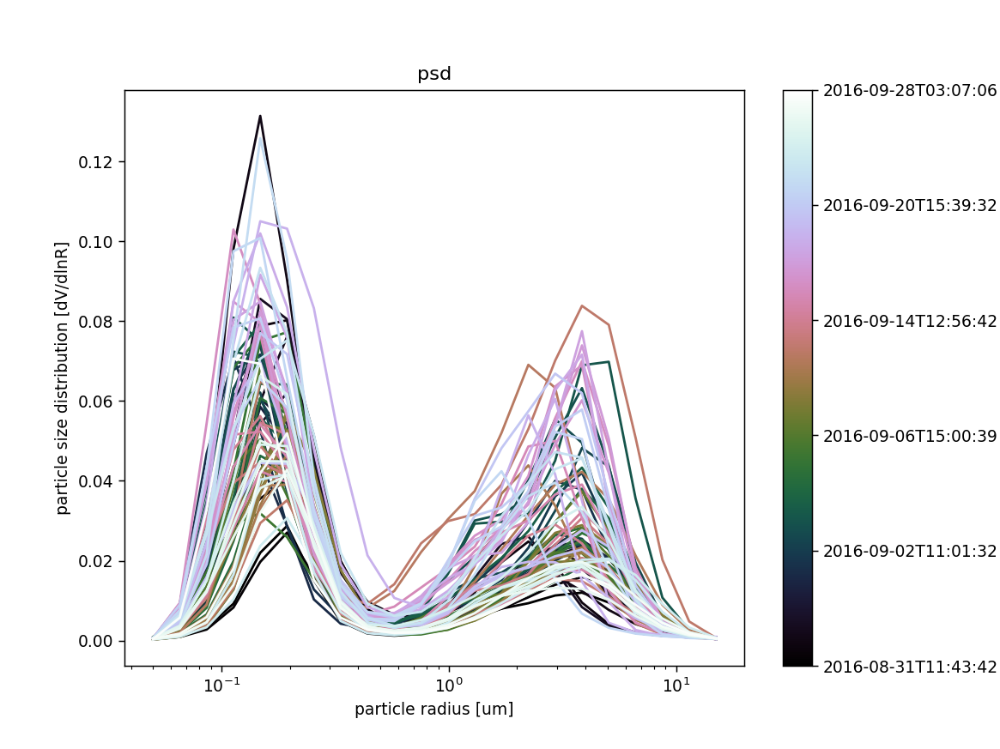

<ipython-input-78-313785d5f583>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])


In [78]:
plt.figure()
plt.gca().set_prop_cycle(color=[plt.cm.cubehelix(k) for k in np.linspace(0, 1, len(nc_all[b'time'])+1)])
plt.plot(nc_all[b'radius'],nc_all[b'psd'].T)
plt.xscale('log')

plt.xlabel(nc_dict_tmp[b'radius'].long_name + ' ['+nc_dict_tmp[b'radius'].units+']')
plt.ylabel(nc_dict_tmp[b'psd'].long_name + ' ['+nc_dict_tmp[b'psd'].units+']')
plt.title(b'psd'.decode())

scalarmap = plt.cm.ScalarMappable(cmap=plt.cm.cubehelix)
scalarmap.set_array(np.linspace(0, 1, len(nc_all[b'time'])+1))
cb = plt.colorbar(scalarmap)
indexes = [np.argmin(abs(np.linspace(0, 1, len(nc_all[b'time']))-ti)) for ti in cb.get_ticks()]
cb.ax.set_yticklabels(nc_all[b'datetime'][indexes])

plt.savefig(fpo+name+'psd'+'.png',transparent=True,dpi=500)

In [79]:
ae_fine_mode = [nc_all[b'radius'][np.argmax(p)] for p in nc_all[b'psd'][:,0:9]]
ae_coarse_mode = [nc_all[b'radius'][9:][np.argmax(p)] for p in nc_all[b'psd'][:,9:]]


<IPython.core.display.Javascript object>


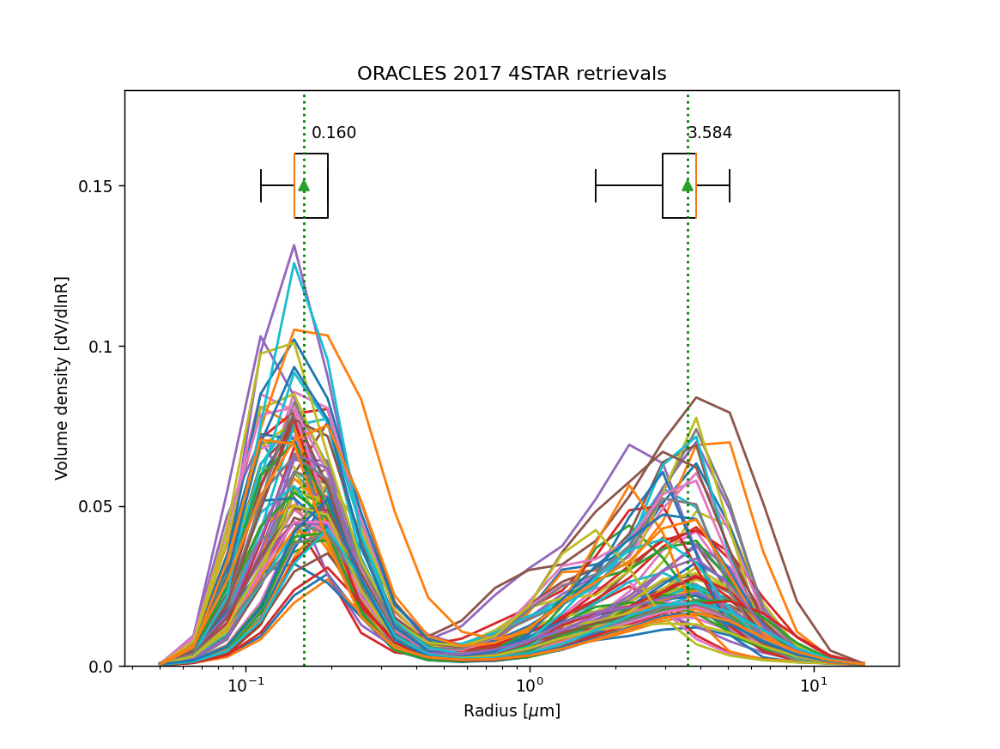

In [80]:
fig = plt.figure()
#
bp = plt.boxplot([ae_fine_mode,ae_coarse_mode],positions=[0.15,0.15],vert=False,showmeans=True,widths=0.02)
plt.plot(nc_all[b'radius'],nc_all[b'psd'].T)
plt.xscale('log')

[plt.axvline(m.get_data()[0],color='g',ls=':') for m in bp['means']]
[plt.text(m.get_data()[0]+0.01,0.165,'{:1.3f}'.format(m.get_data()[0][0])) for m in bp['means']]

plt.xlabel('Radius [$\mu$m]')
plt.ylabel('Volume density [dV/dlnR]')
plt.ylim(0,0.18)
plt.yticks([0.0,0.05,0.1,0.15])
plt.gca().set_yticklabels([0.0,0.05,0.1,0.15])

plt.title('ORACLES 2017 4STAR retrievals')

plt.savefig(fpo+name+'psd_avgeraged'+'.png',transparent=True,dpi=500)

In [81]:
nc_dict_tmp.keys()

dict_keys([b'base_time', b'time_offset', b'time', b'wavelength', b'radius', b'psd', b'QA_level', b'sphericity', b'sphericity_err', b'PF_angle', b'sca_angle', b'n_real', b'n_imag', b'SSA', b'AOD_fit_total', b'AOD_fit_fine', b'AOD_fit_coarse', b'AOD_meas', b'AAOD', b'TOD_meas', b'TOD_fit', b'TOD_meas_minus_fit', b'AGOD', b'sfc_alb', b'g_total', b'g_fine', b'g_coarse', b'PF_total', b'PF_fine', b'PF_coarse', b'normalized_sky_radiance', b'normalized_sky_radiance_fit', b'sky_radiance_fit_error', b'scan_tag', b'scan_type', b'Lat', b'Lon', b'GPS_Altitude', b'Heading', b'Pitch', b'Roll', b'GPS_Altitude_std', b'Heading_std', b'Pitch_std', b'Roll_std', b'T_static', b'P_static', b'RH', b'SAZ', b'SZA', b'SEL', b'm_ray', b'PWV'])

In [82]:
ncf = sio.netcdf_file(fpo+f)

In [83]:
for k in ncf.__dict__:
    try:
        print(k+':   ',ncf.__dict__[k].decode())
    except: 
        pass

PI:    Jens Redemann
Institution:    NASA Ames Research Center
Instrument:    Spectrometers for Sky-Scanning, Sun-Tracking Atmospheric Research (4STAR)
Mission:    ORACLES 2016
PI_CONTACT_INFO:    jredemann@ou.edu
PLATFORM:    NASA P3
LOCATION:    Based at Walvis Bay, Namibia, aircraft latitude, longitude, altitude are included in the data records
DATA_INFO:    Measurements represent airborne retrievals of aerosol properties derived from direct beam and angularly-resolved sky radiances at the location of the aircraft.  All measurements used in a single retrieval are reported at the time averaged over the sky scan. These retrievals are based on work by Kristina Pistone (kristina.pistone@nasa.gov), and represent the highest quality data. Only retrievals that pass QC_CRITERIA are included in this archival
RETRIEVAL_INFO:    Retrieval code was provided by AERONET (version 2 Aerosol Inversions), input files modified for airborne application. Description is found in Pistone et al., 2019 (doi

## For 2018

<IPython.core.display.Javascript object>


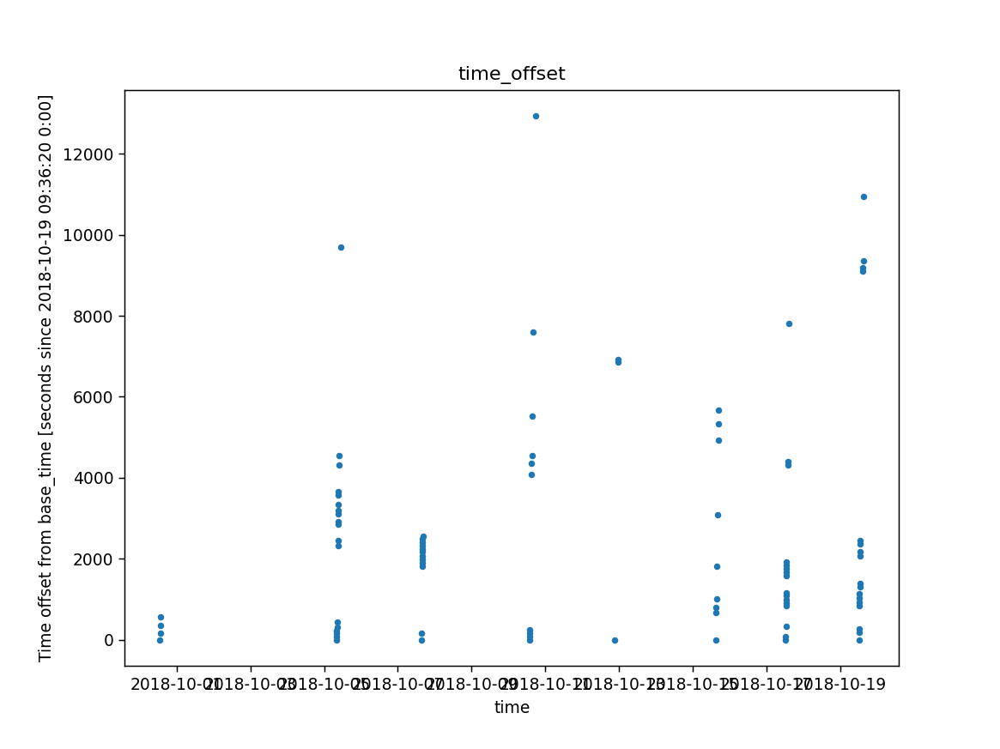

<IPython.core.display.Javascript object>


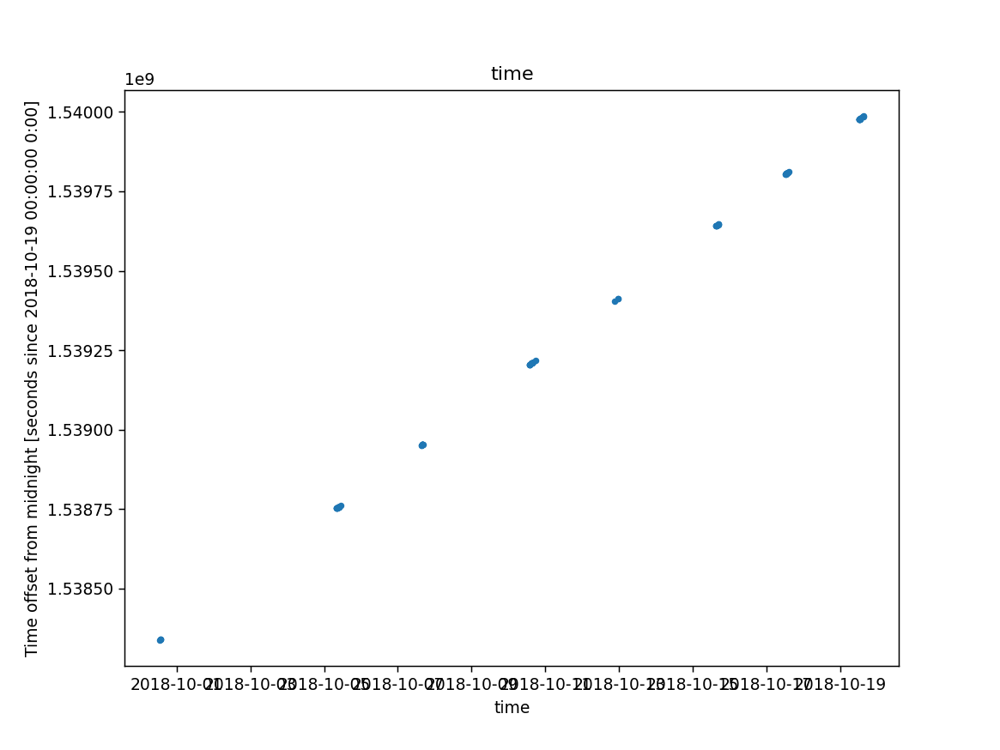

<IPython.core.display.Javascript object>


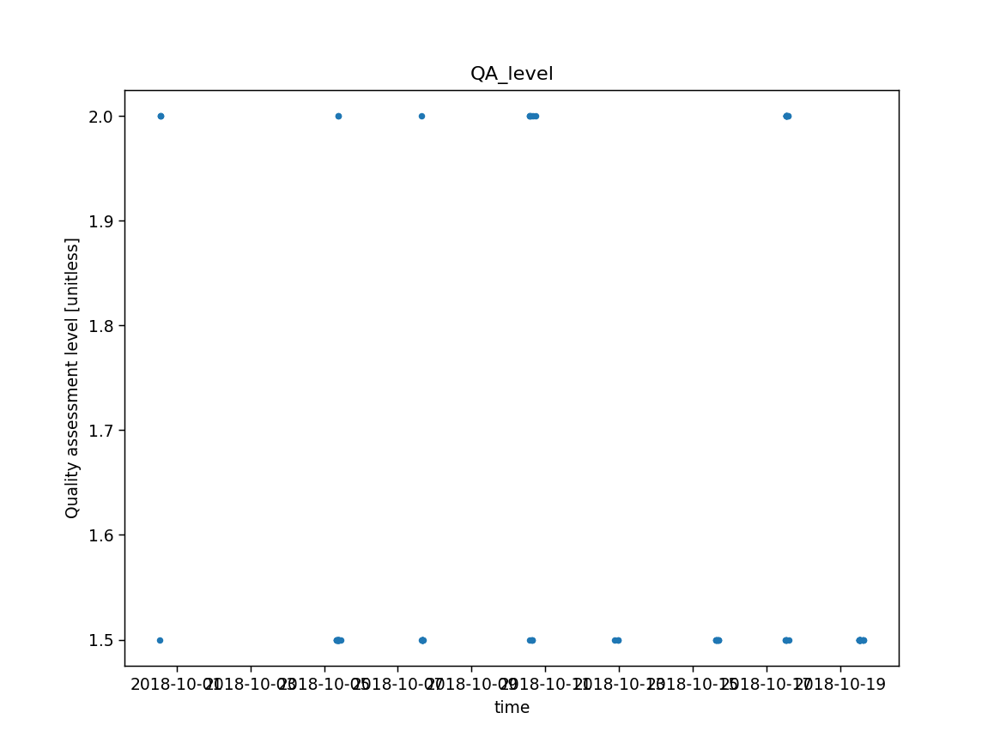

<IPython.core.display.Javascript object>


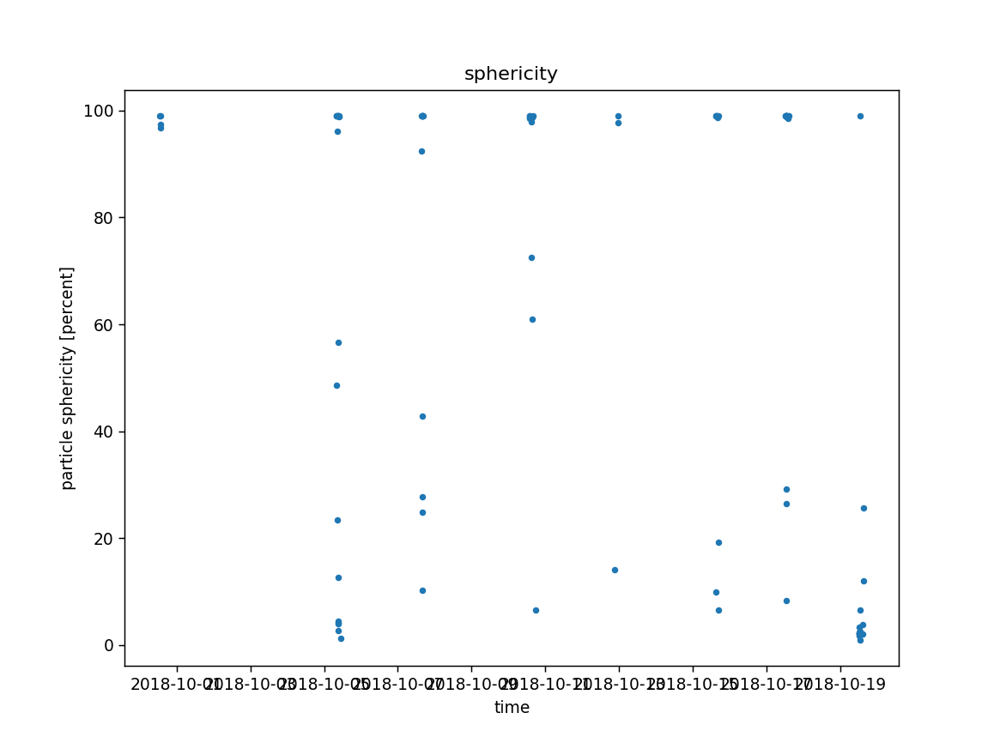

<IPython.core.display.Javascript object>


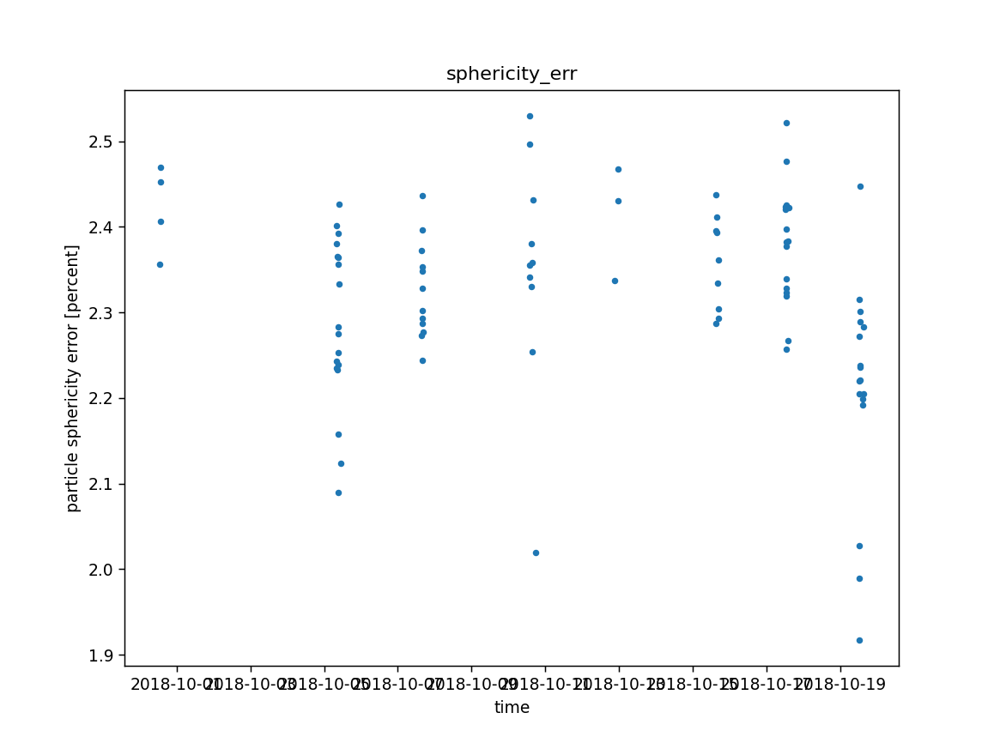

<IPython.core.display.Javascript object>


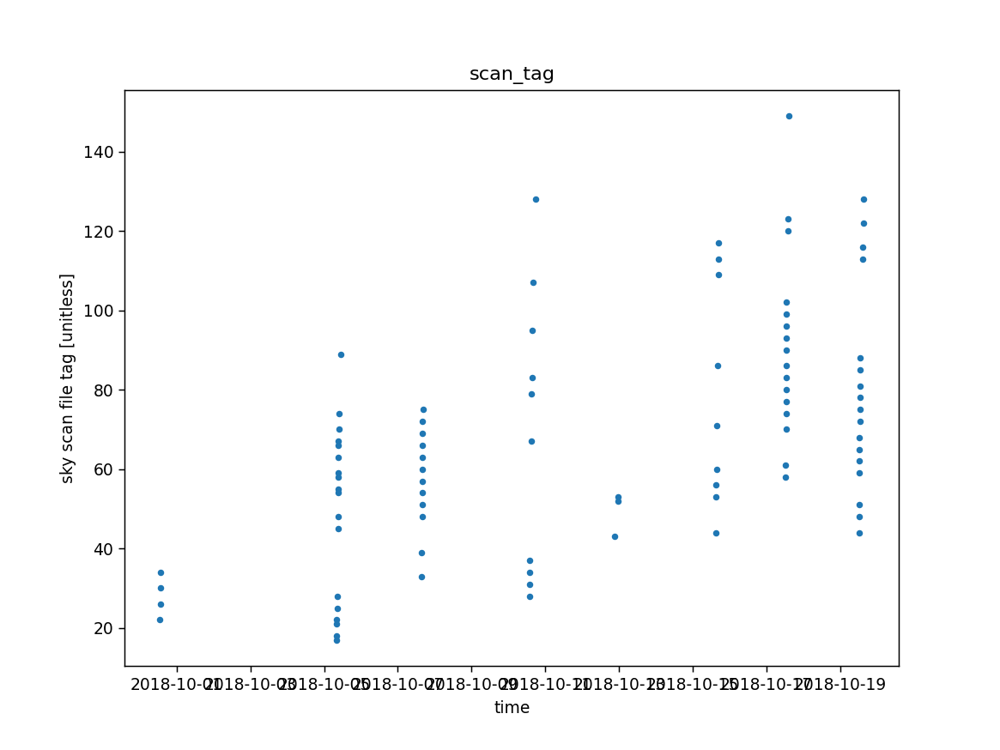

<IPython.core.display.Javascript object>


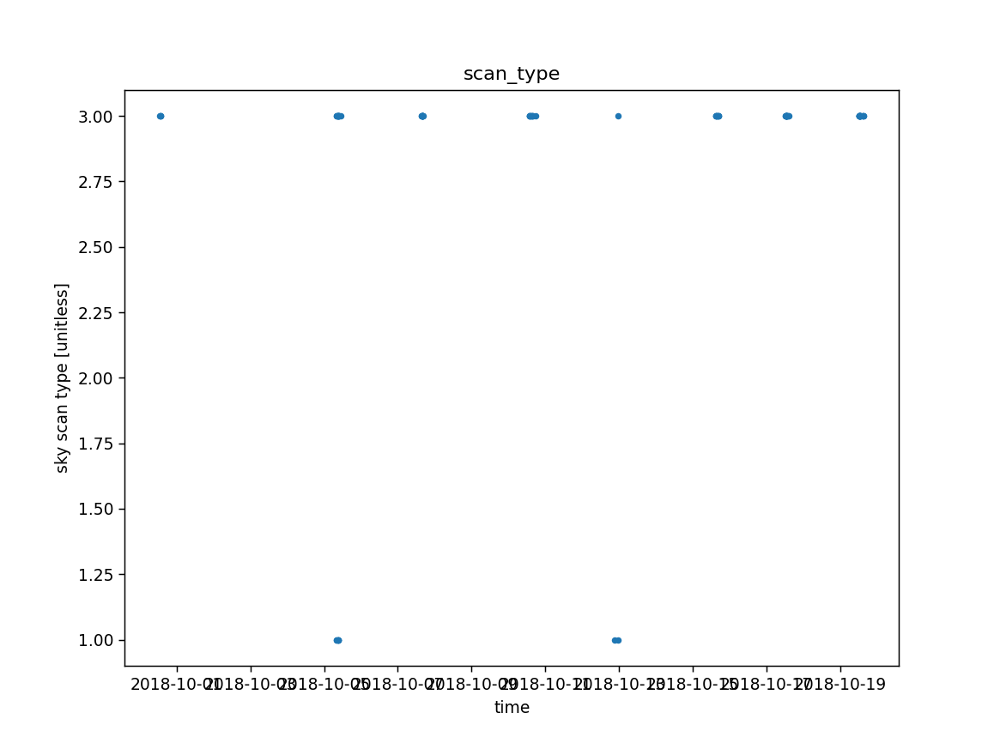

<IPython.core.display.Javascript object>


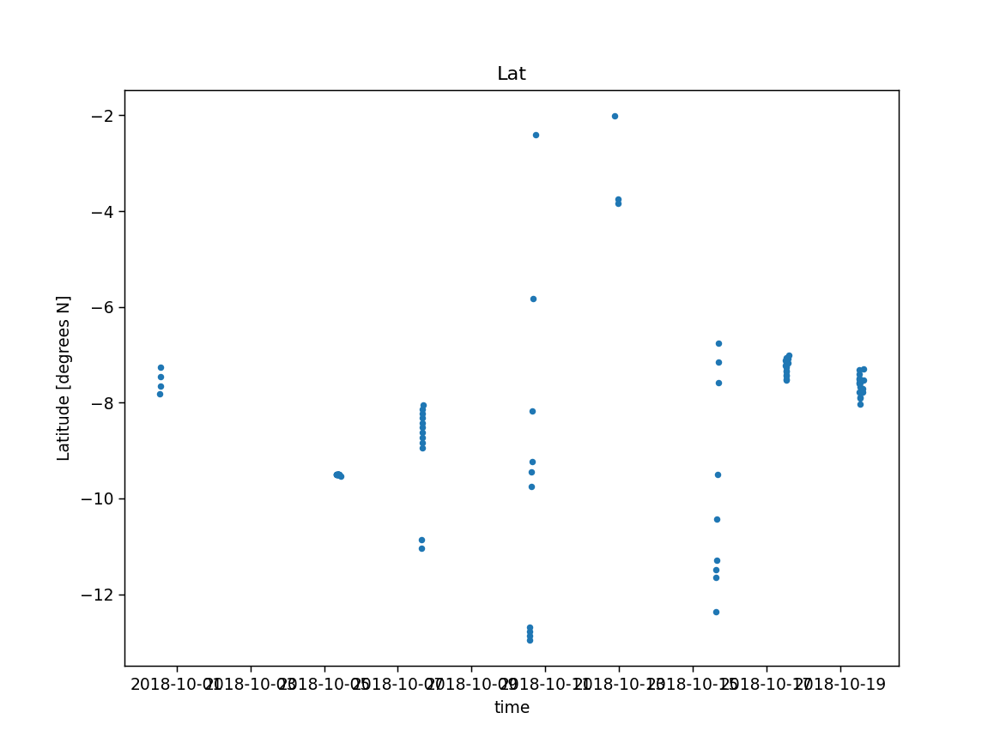

<IPython.core.display.Javascript object>


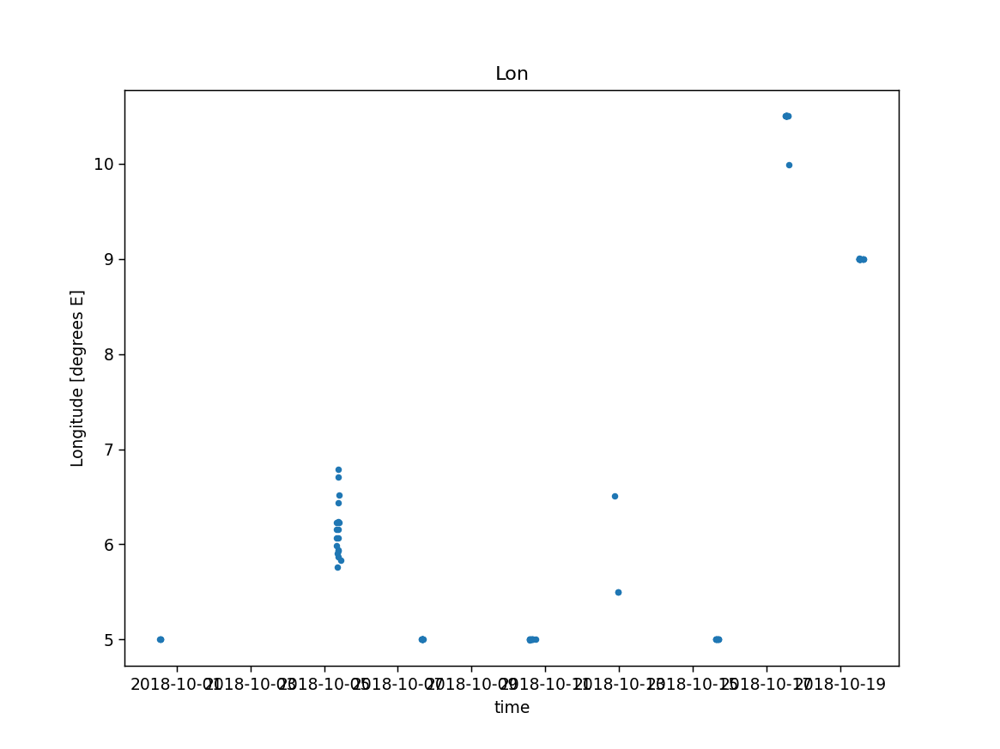

<IPython.core.display.Javascript object>


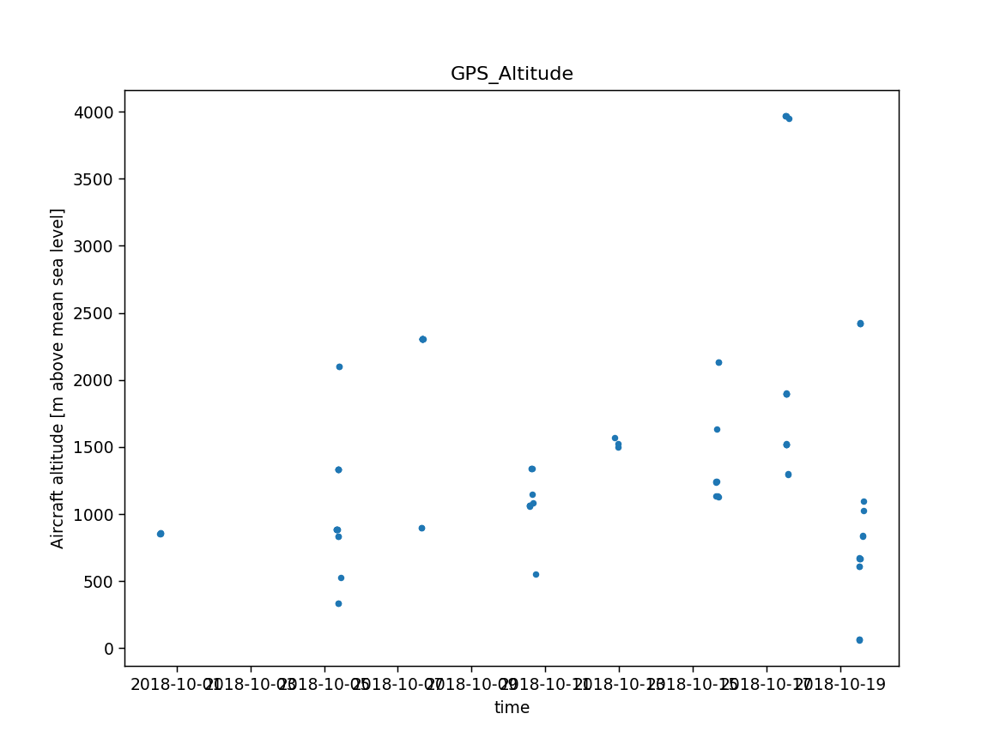

<IPython.core.display.Javascript object>


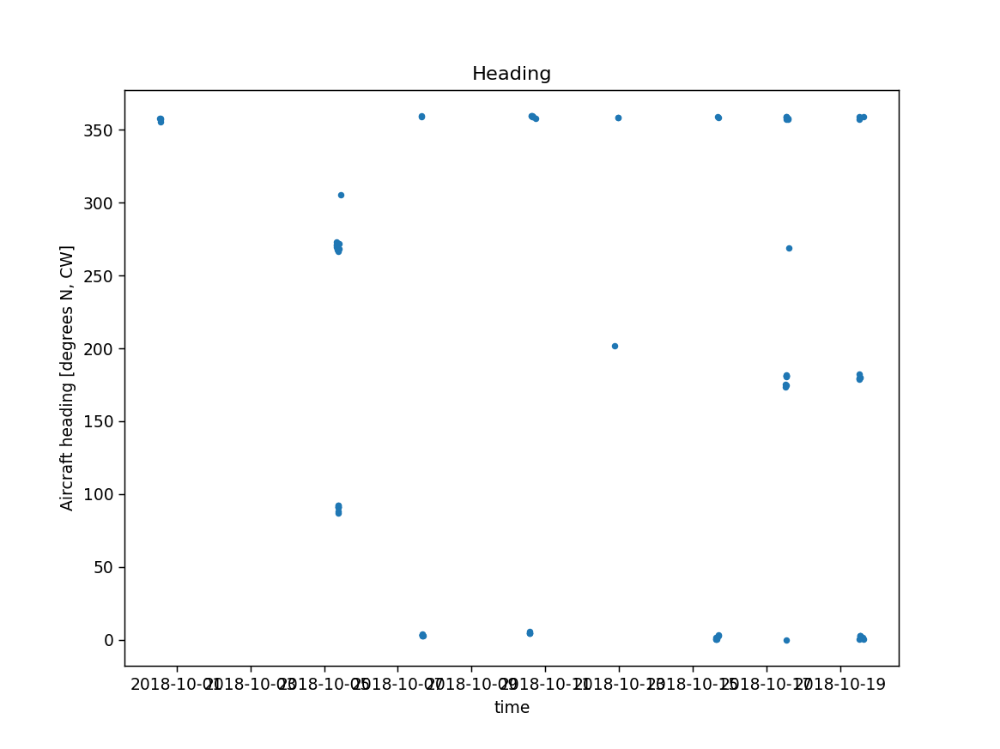

<IPython.core.display.Javascript object>


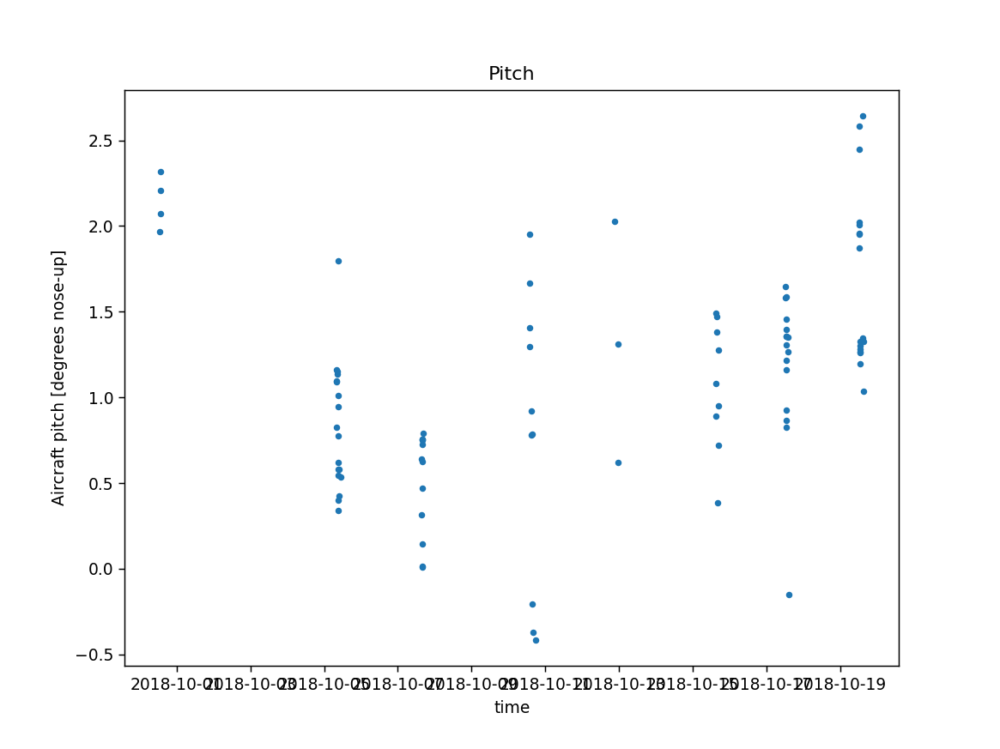

<IPython.core.display.Javascript object>


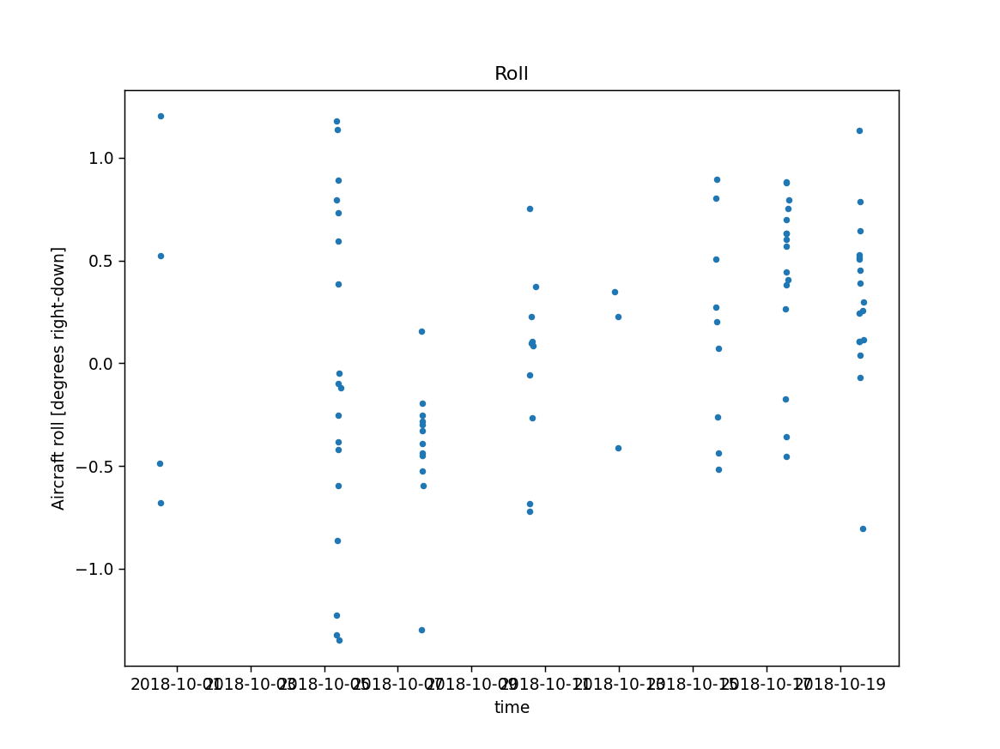

<IPython.core.display.Javascript object>


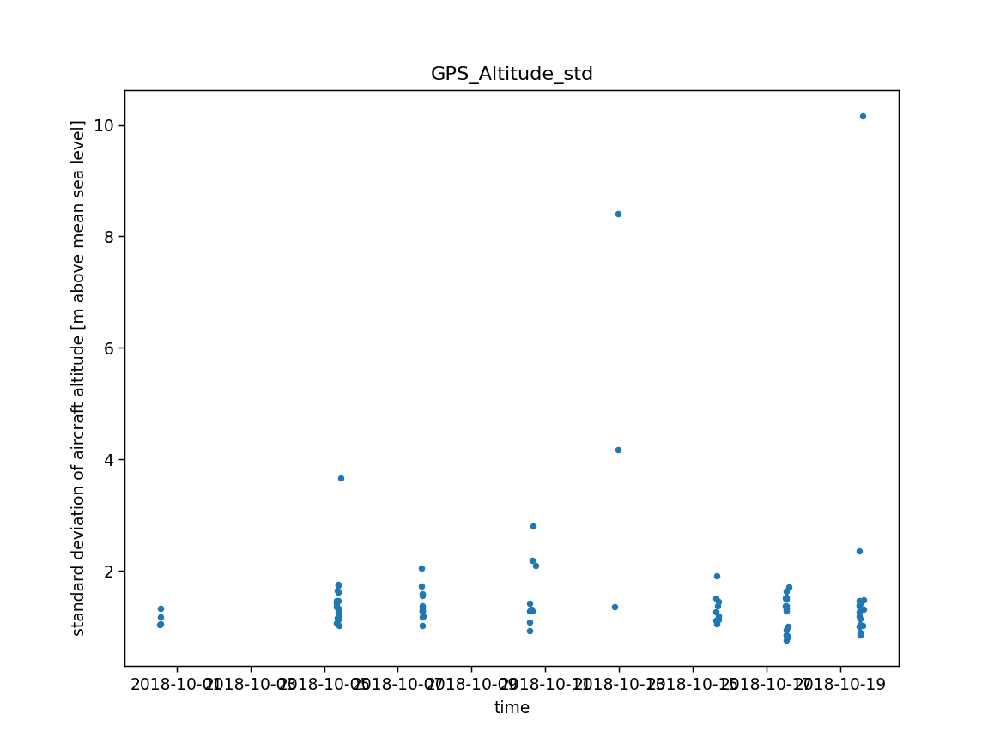

<IPython.core.display.Javascript object>


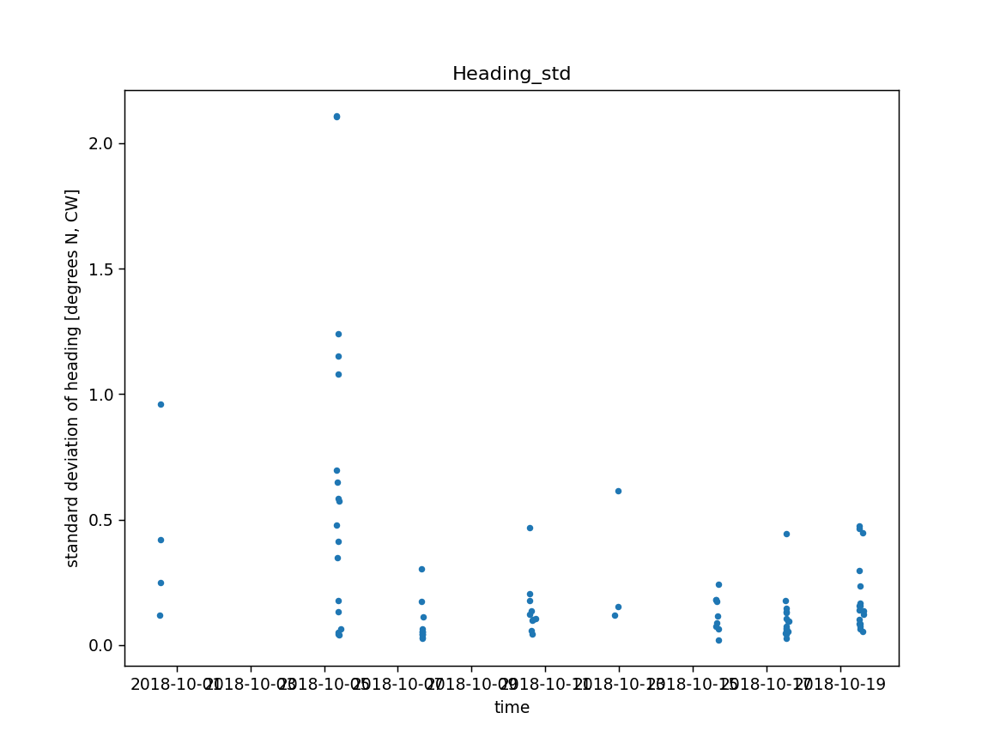

<IPython.core.display.Javascript object>


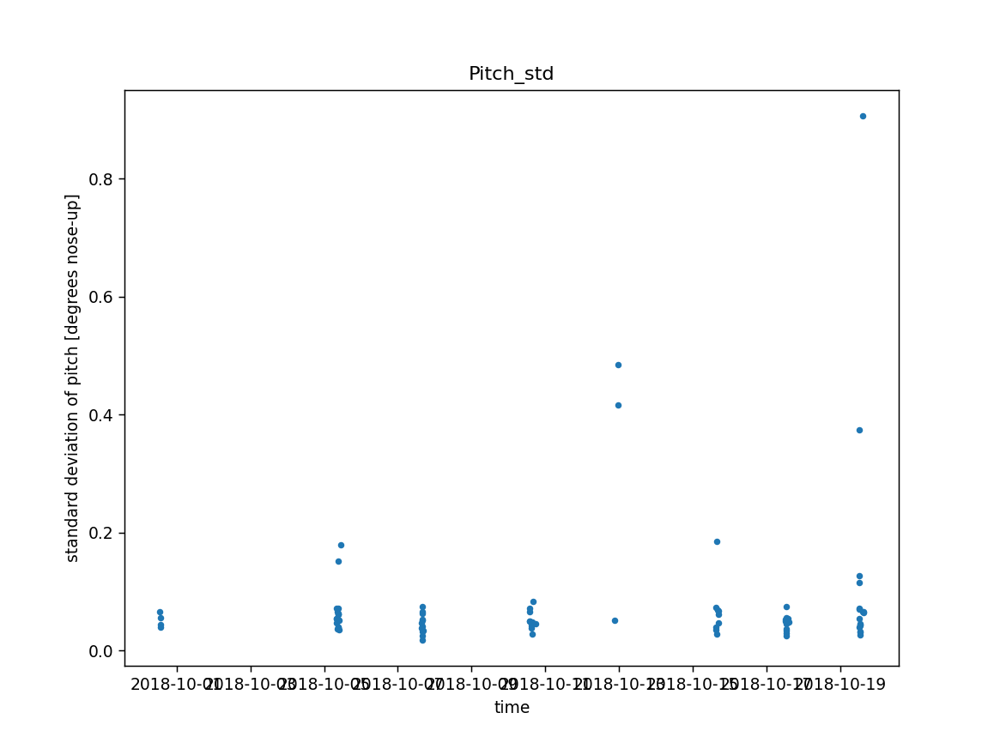

<IPython.core.display.Javascript object>


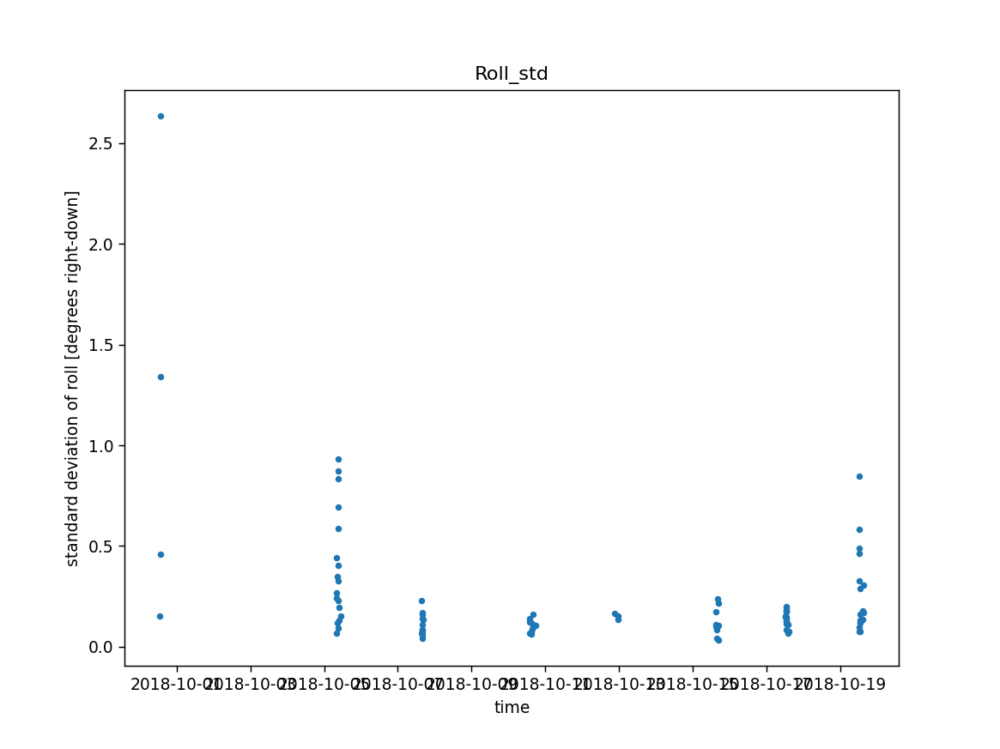

<IPython.core.display.Javascript object>


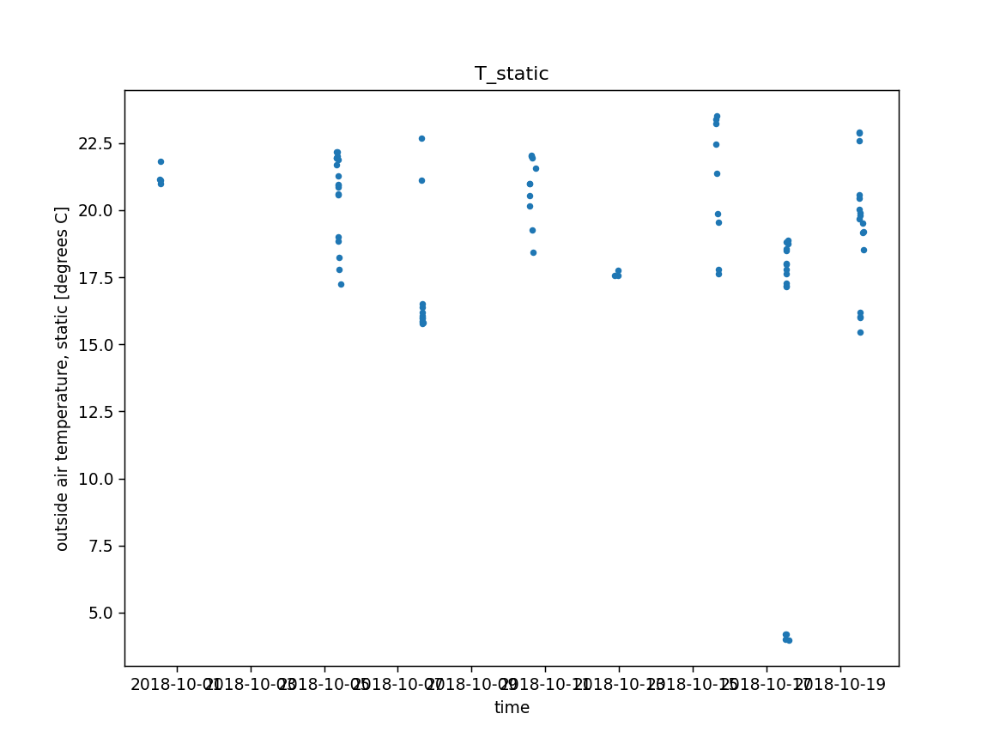

<IPython.core.display.Javascript object>


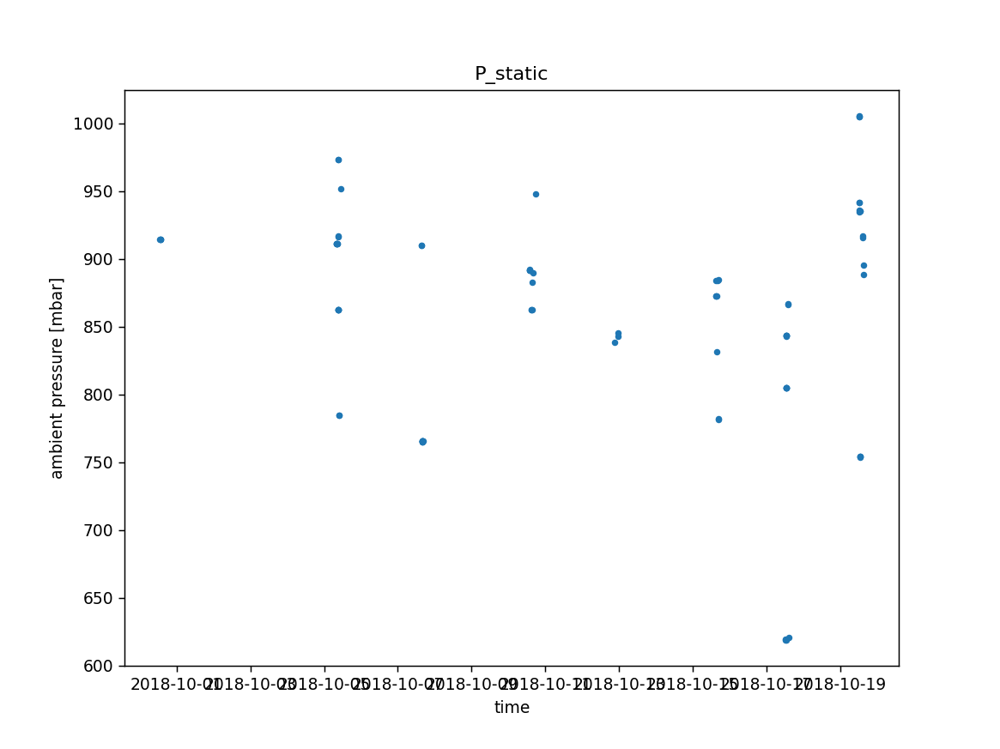

<IPython.core.display.Javascript object>


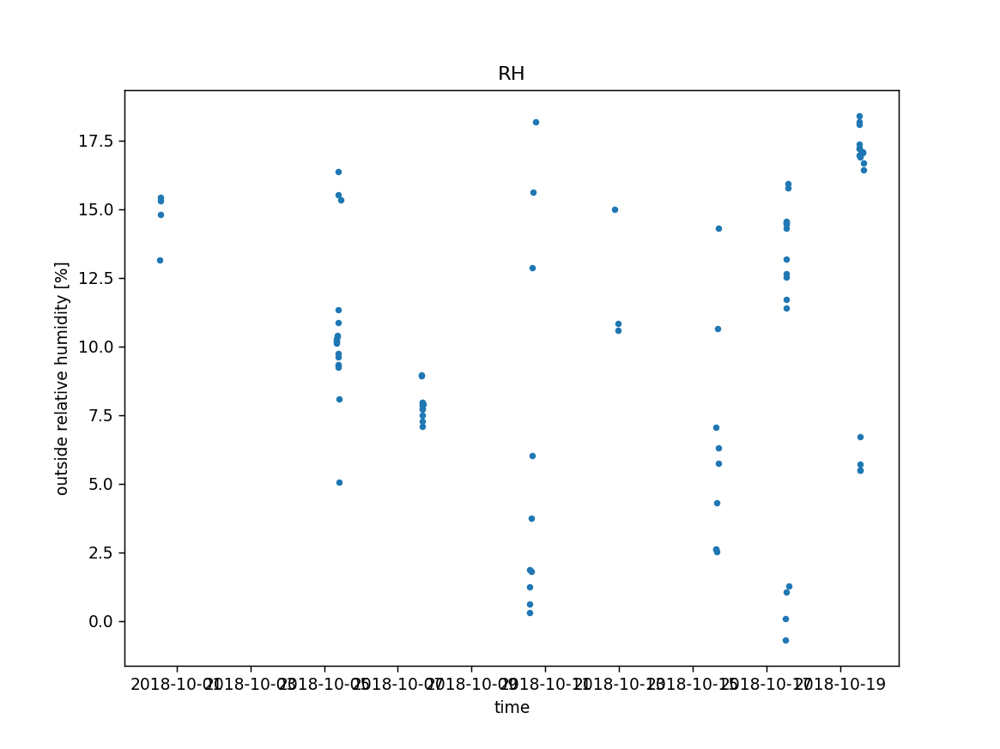

<IPython.core.display.Javascript object>


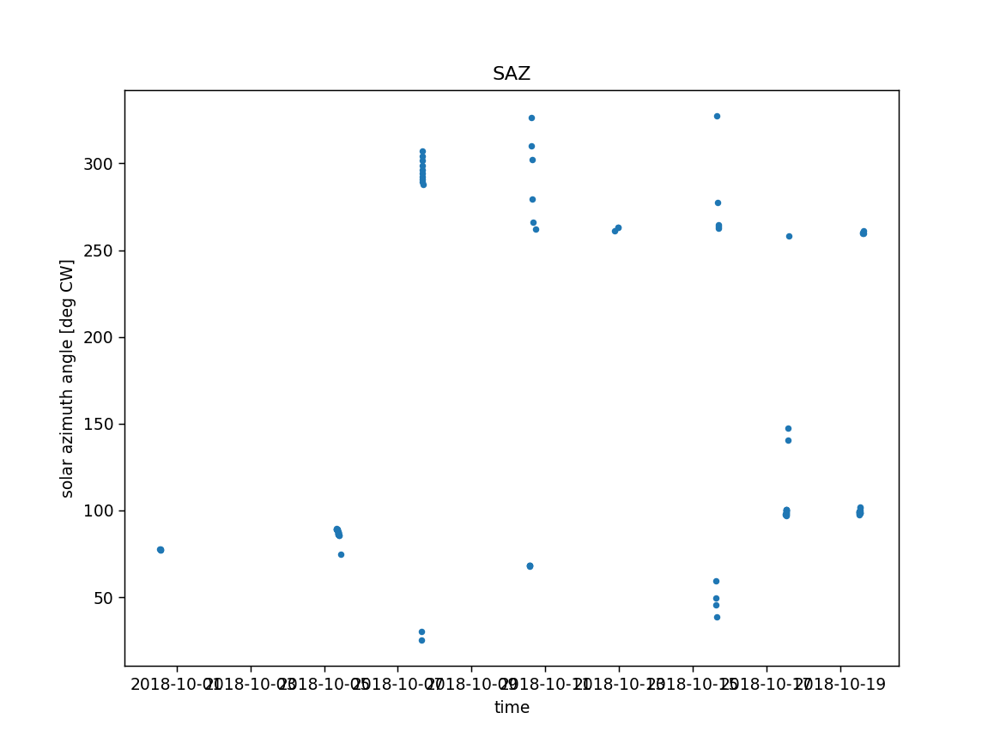

<IPython.core.display.Javascript object>


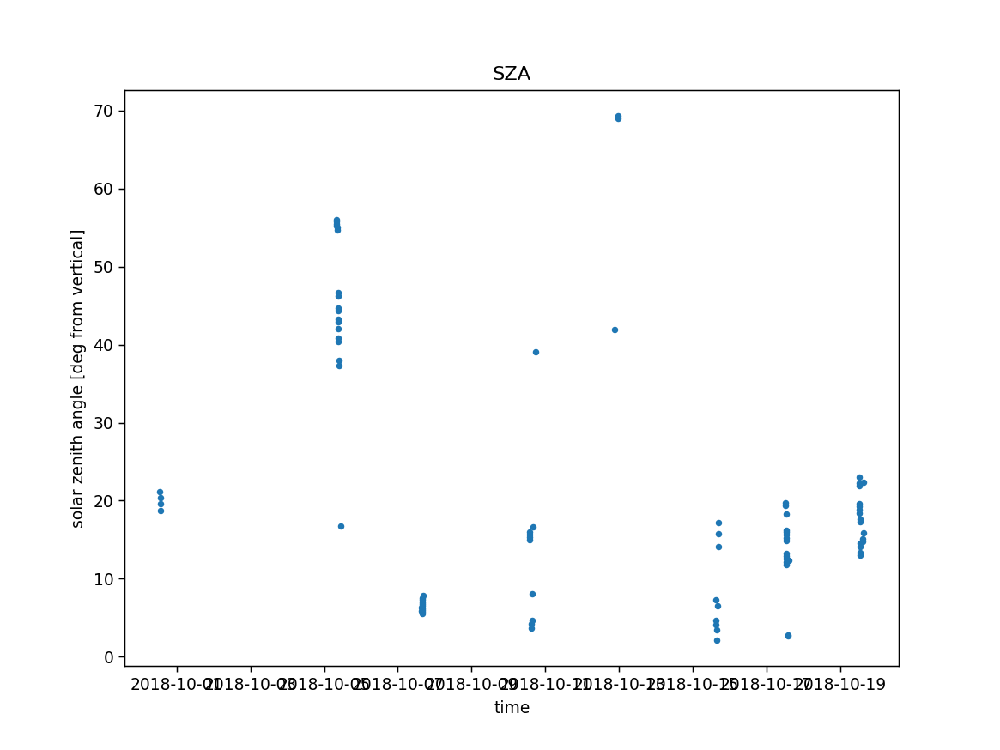

<IPython.core.display.Javascript object>


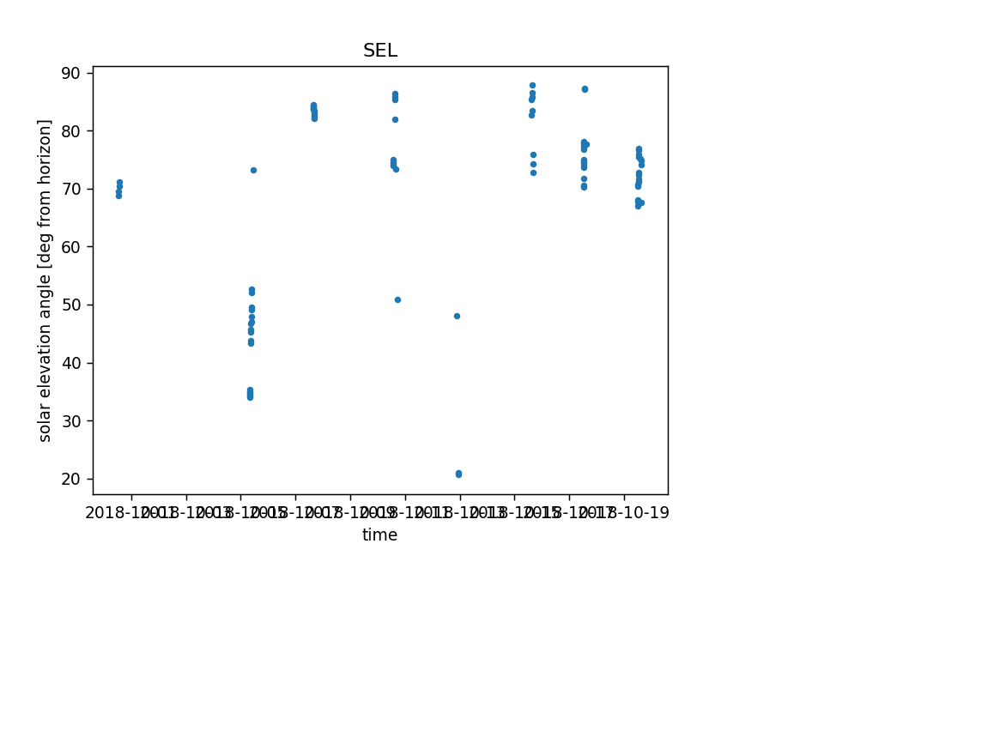

<IPython.core.display.Javascript object>


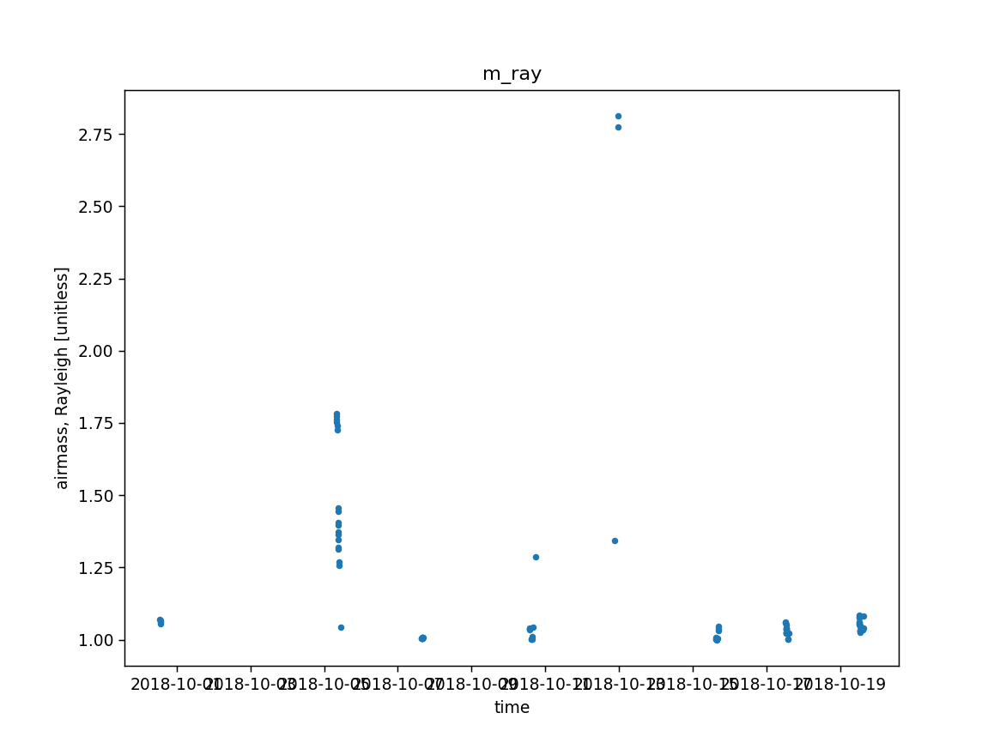

<IPython.core.display.Javascript object>


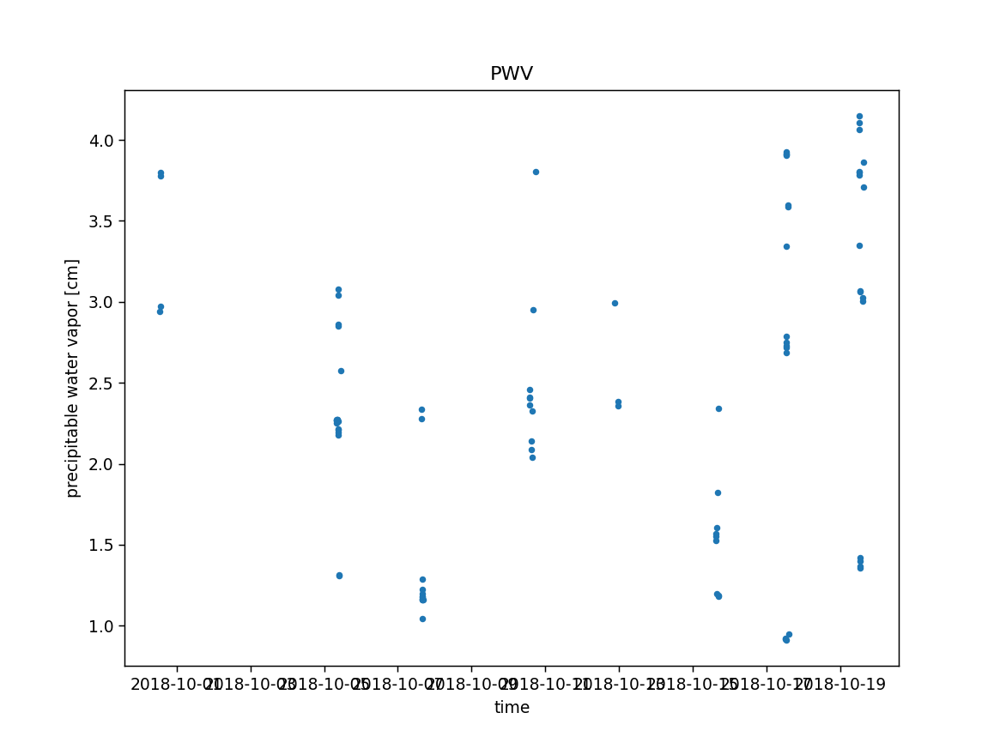

<IPython.core.display.Javascript object>


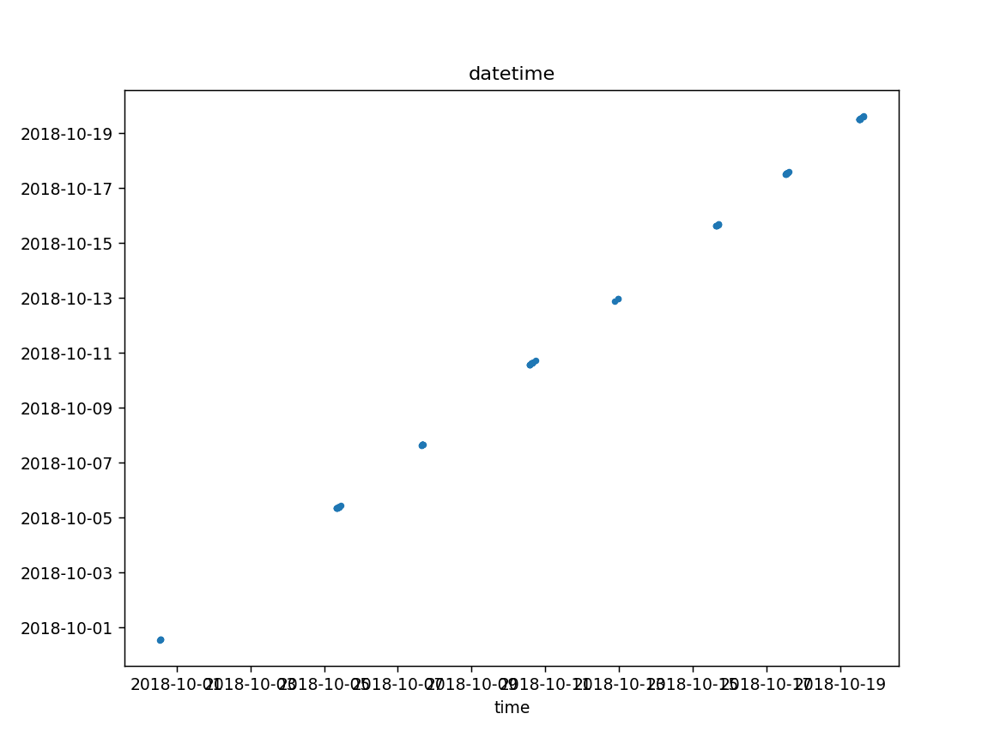

In [41]:
for k in nc8_all:
    if nc8_all[k].shape == nc8_all[b'time'].shape:
        plt.figure()
        plt.plot(nc8_all[b'datetime'],nc8_all[k],'.')
        try: 
            plt.ylabel(nc8_dict_tmp[k].long_name + ' ['+nc8_dict_tmp[k].units+']')
        except:
            pass
        plt.xlabel('time')
        plt.title(k.decode())        
        
        plt.savefig(fpo8+name8+k.decode()+'.png',transparent=True,dpi=500)

<IPython.core.display.Javascript object>


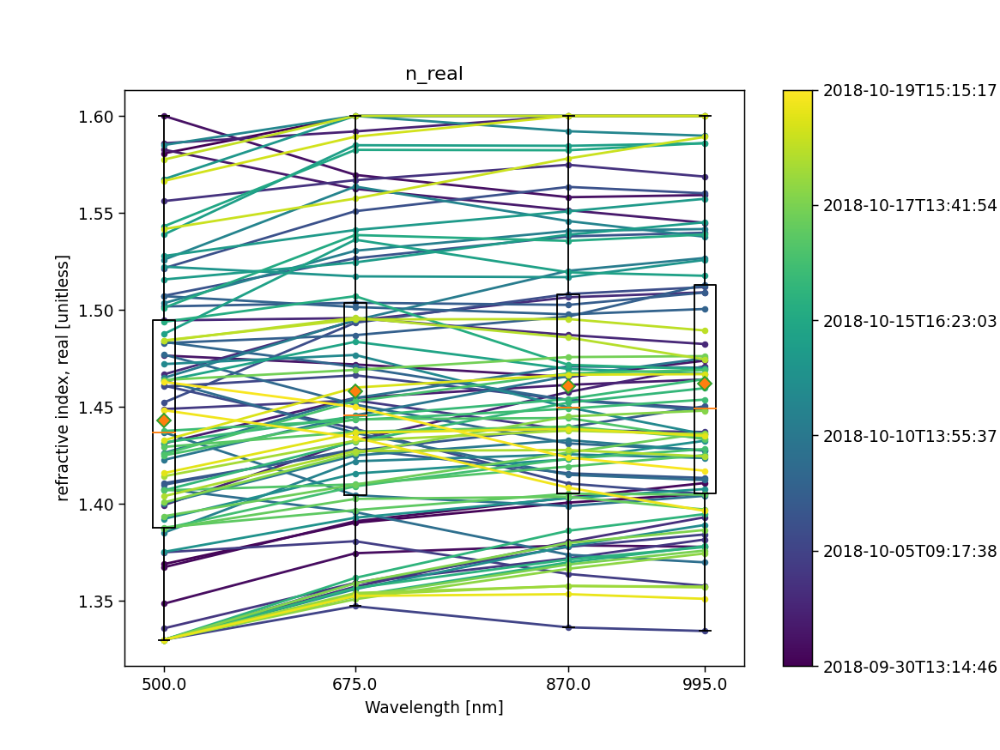

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


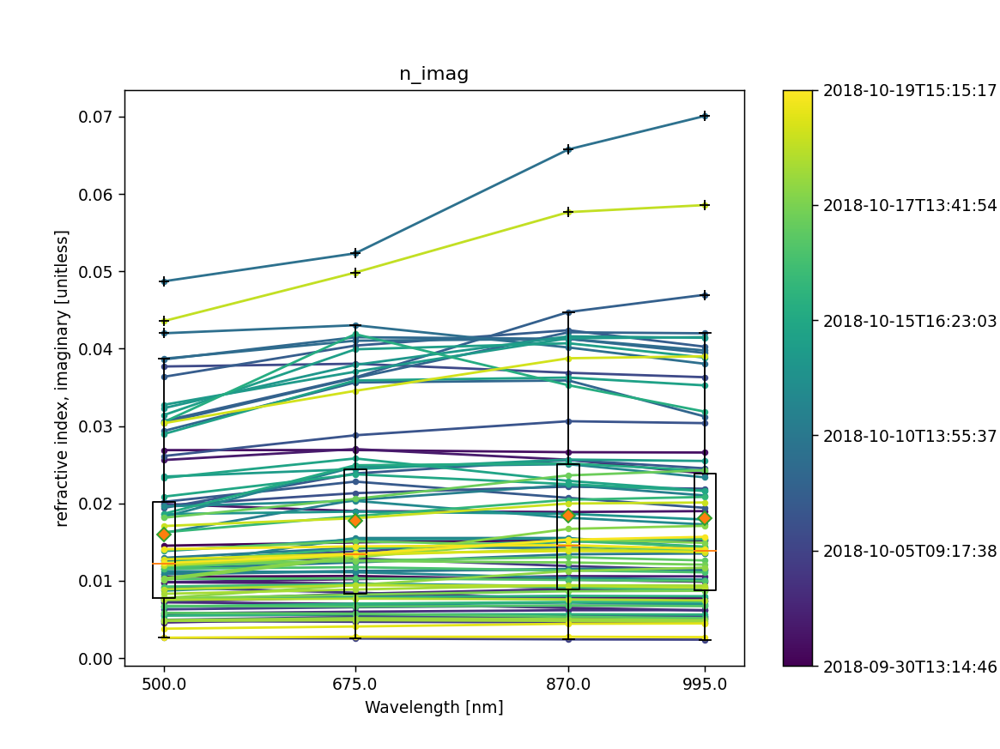

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


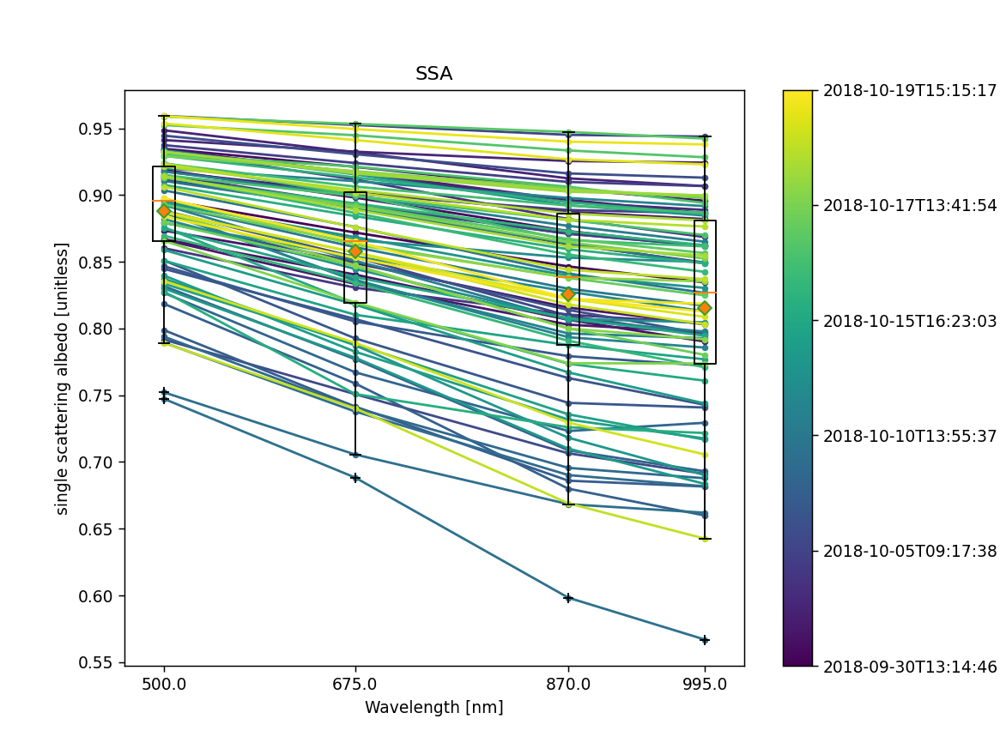

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


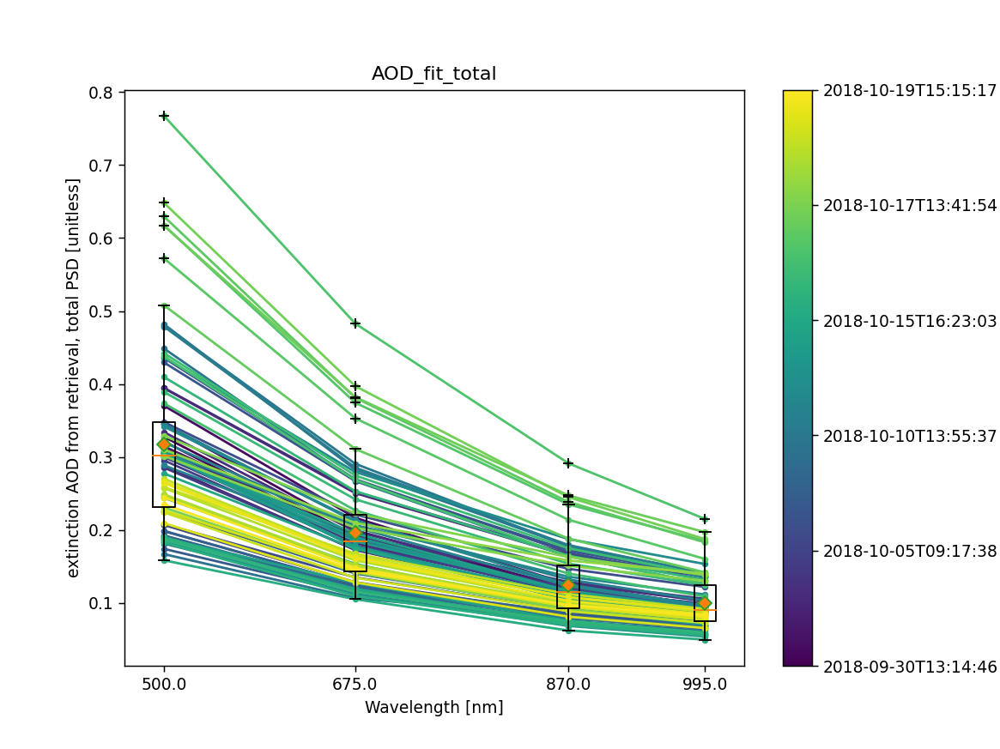

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


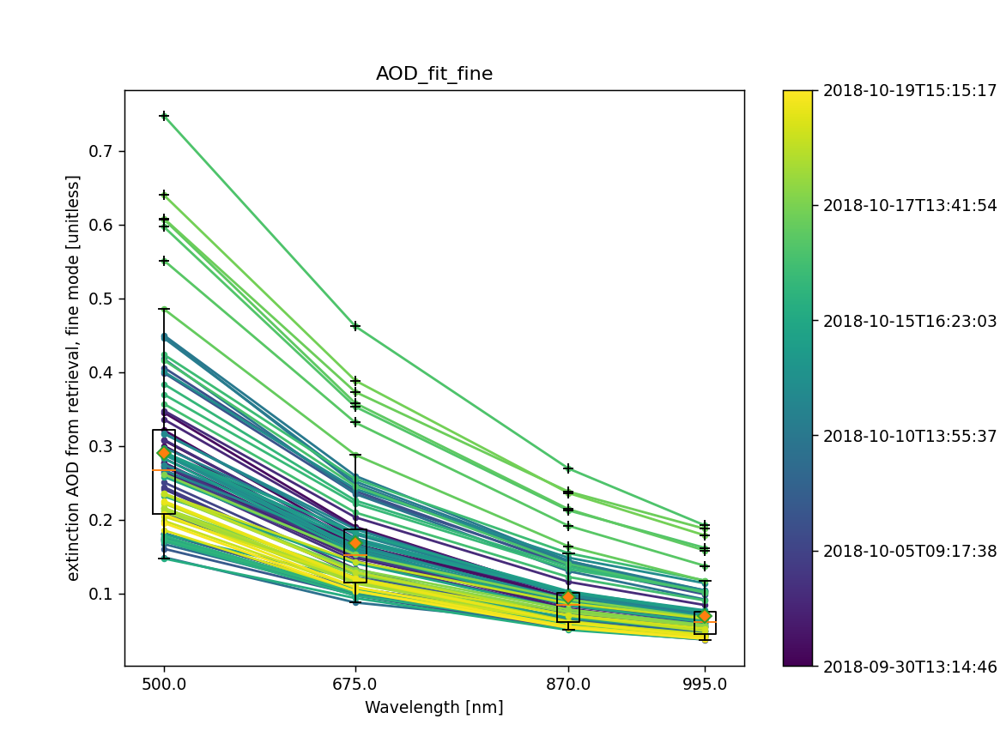

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


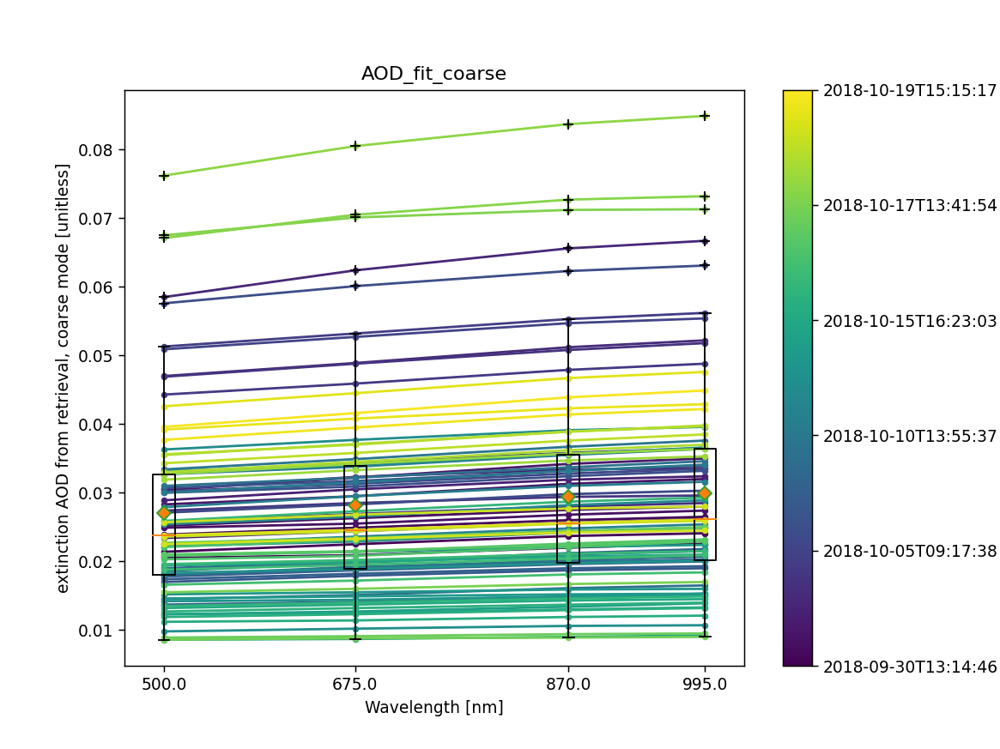

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


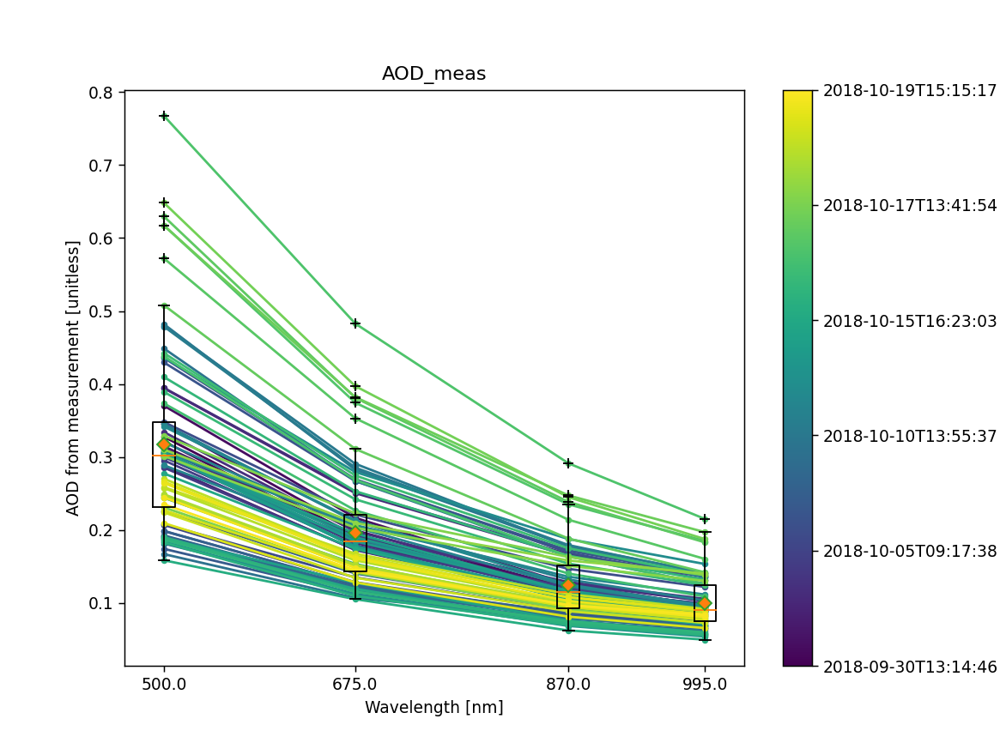

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


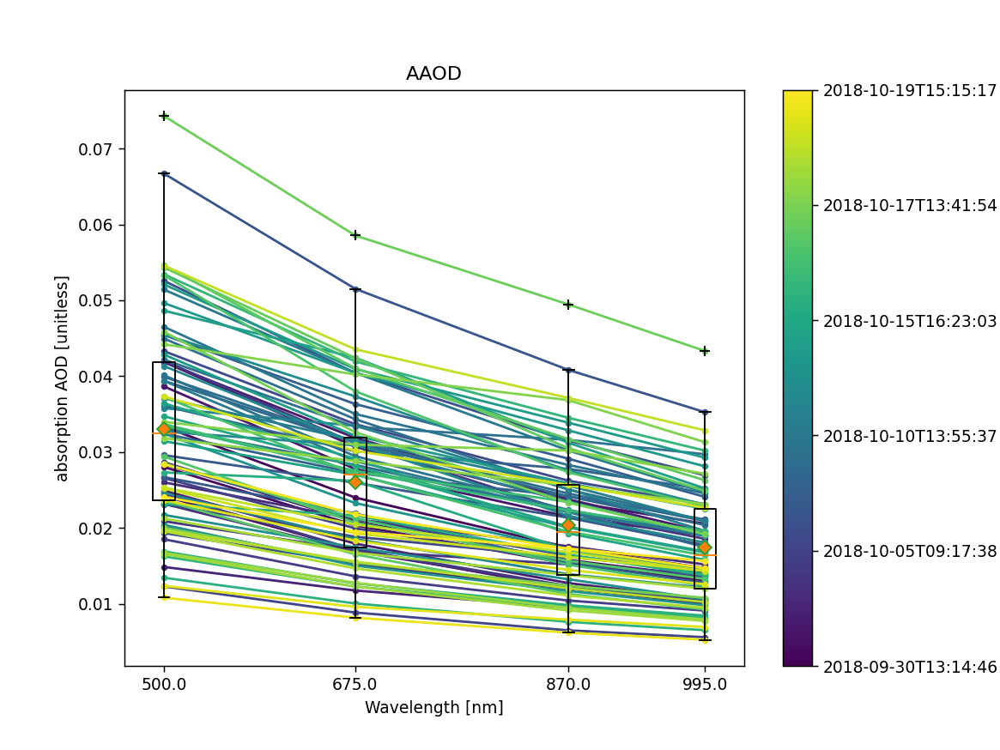

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


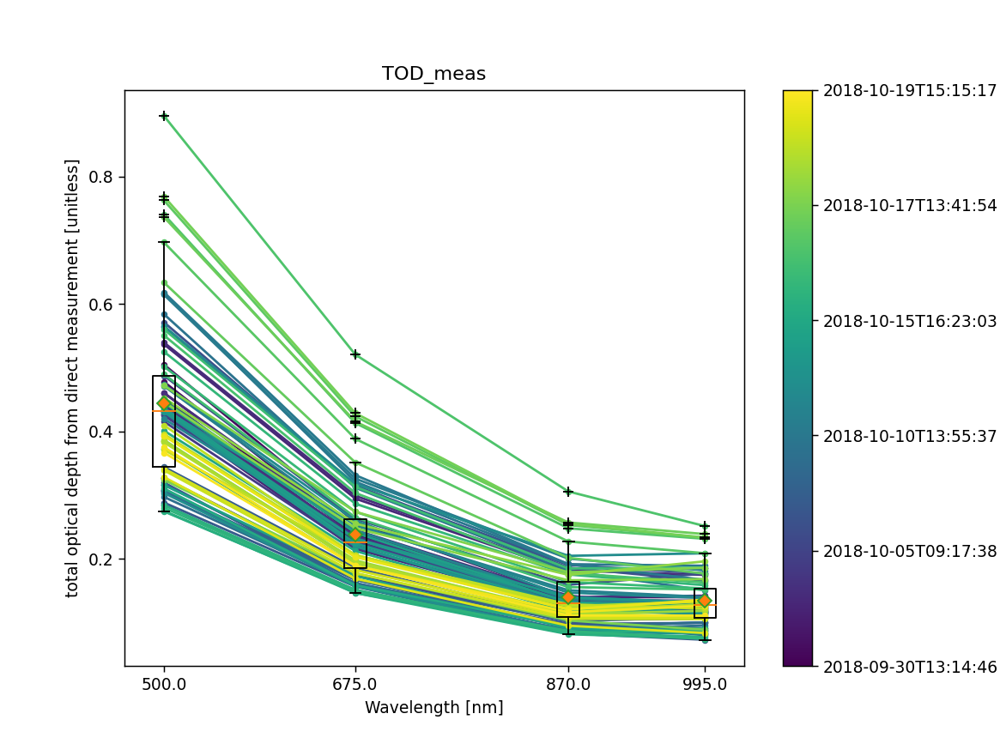

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


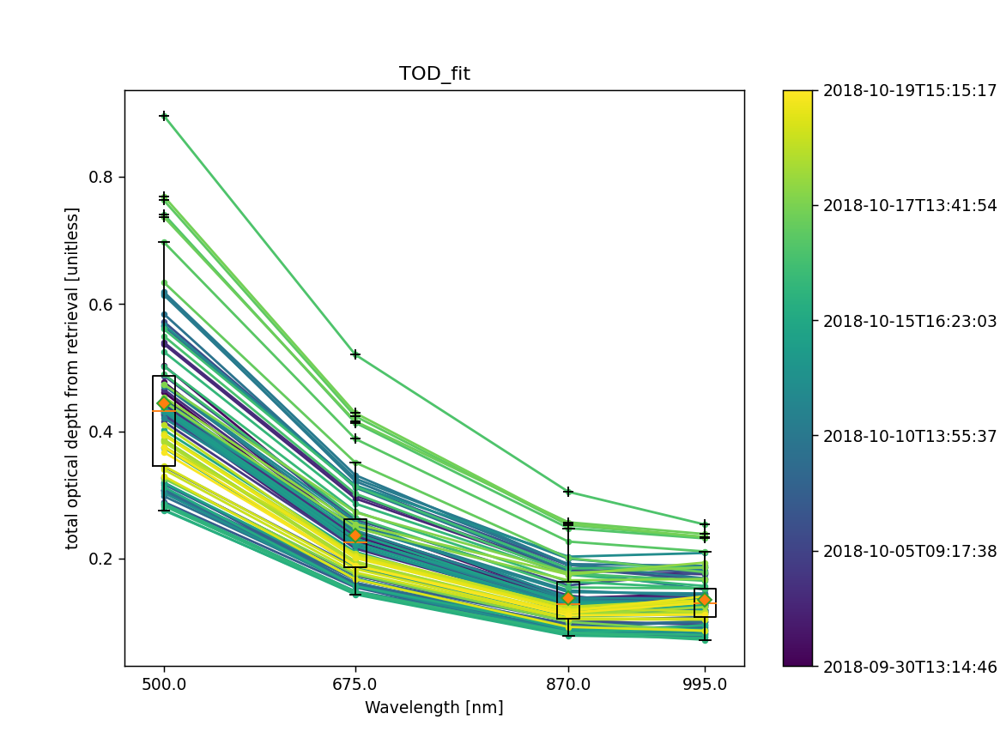

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


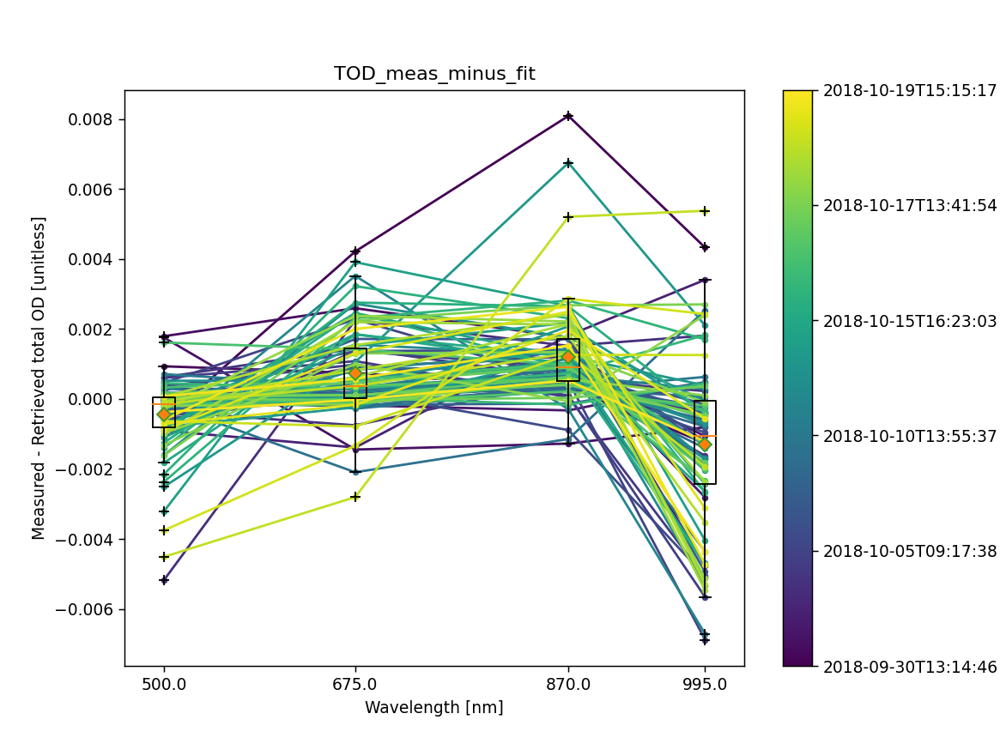

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


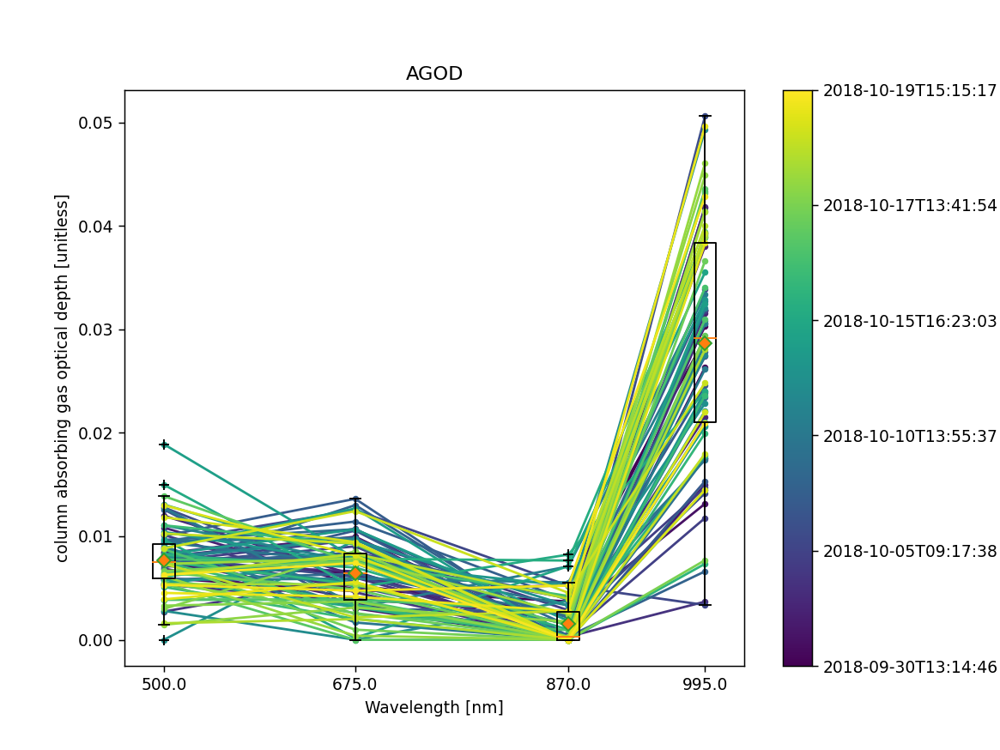

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


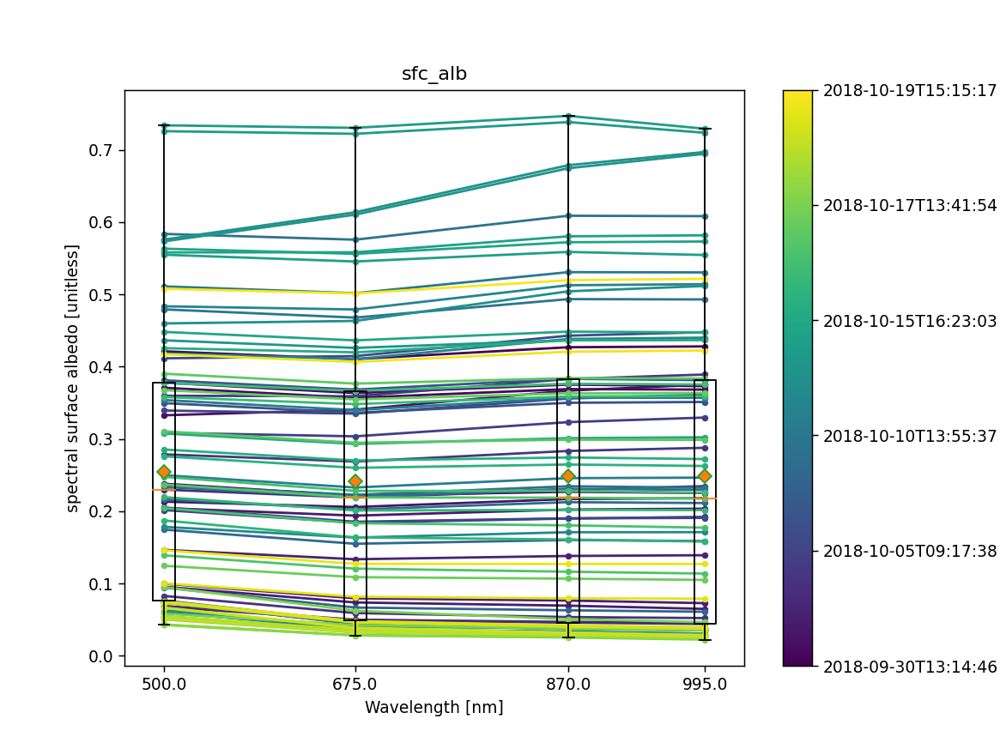

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


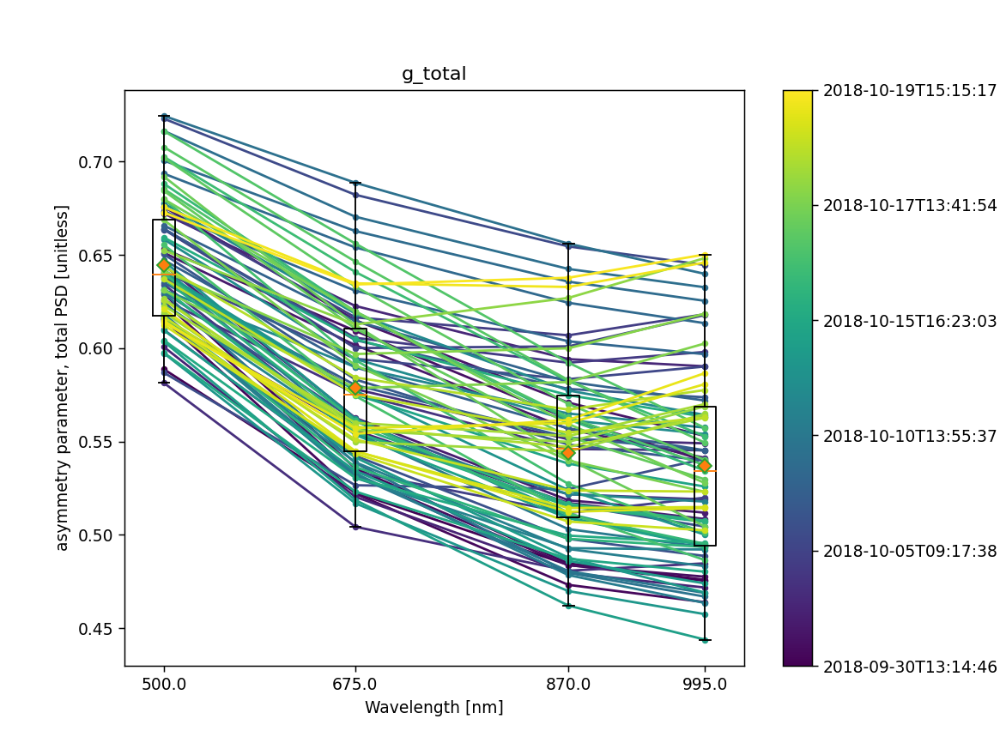

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


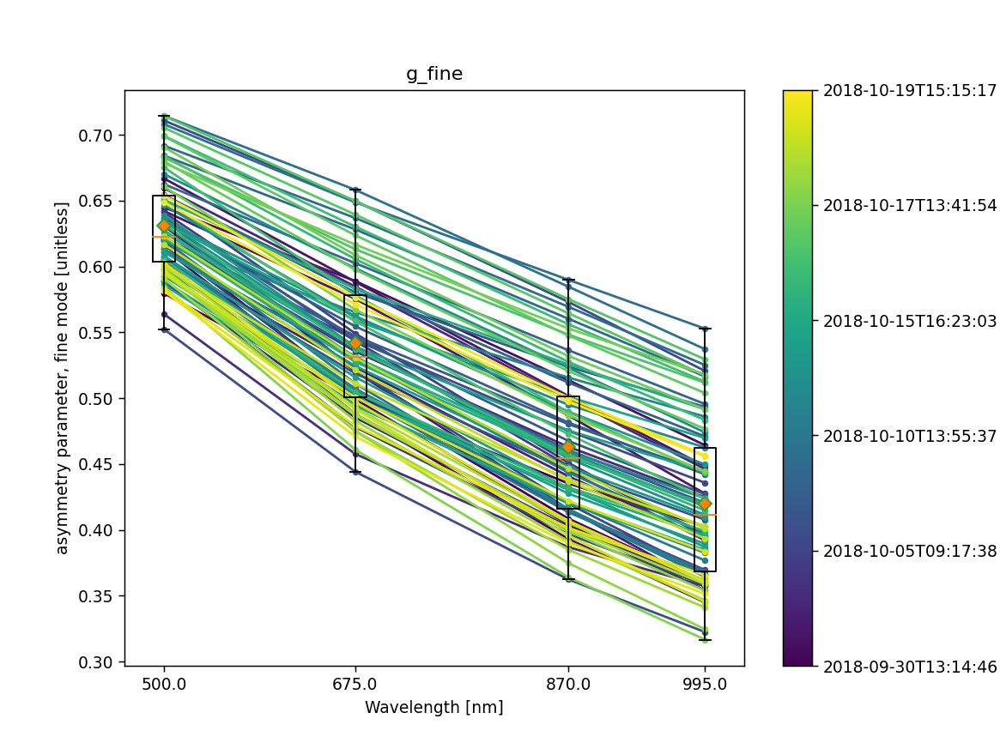

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


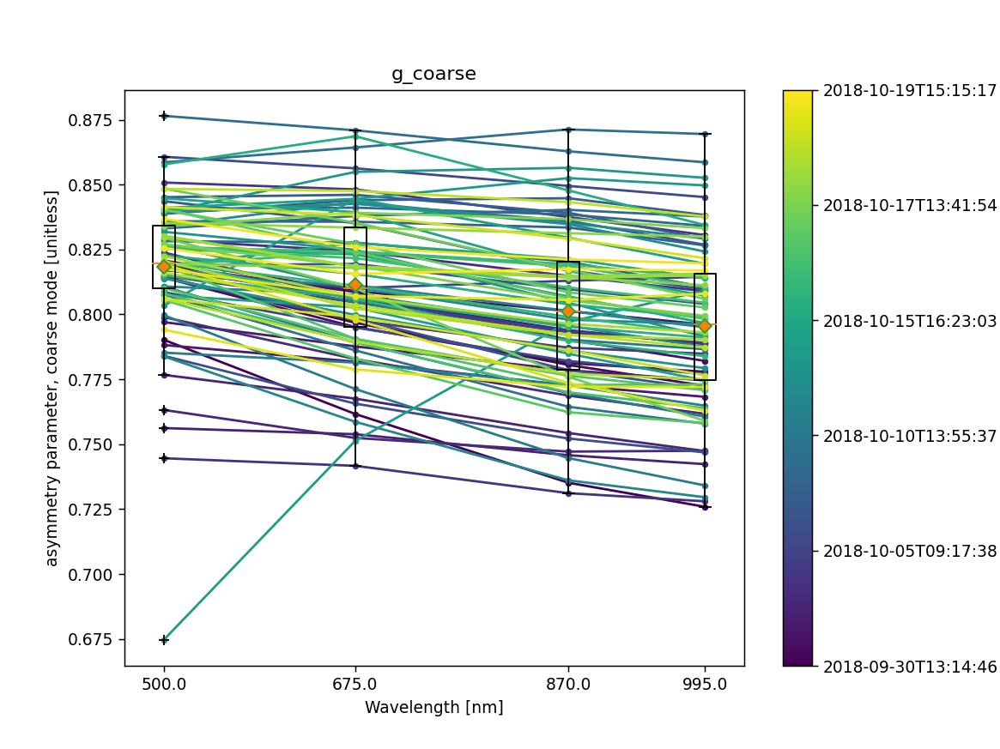

<ipython-input-50-c3b3be7db155>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


In [50]:
for k in nc8_all:
    if nc8_all[k].shape == nc8_all[b'SSA'].shape:
        plt.figure()
        plt.gca().set_prop_cycle(color=[plt.cm.viridis(k) for k in np.linspace(0, 1, len(nc8_all[b'time'])+1)])
        plt.plot(nc8_all[b'wavelength'],nc8_all[k].T,'.-')
        plt.boxplot(nc8_all[k],positions=nc8_all[b'wavelength'],widths=20.0,showmeans=True,sym='+',meanprops={'markerfacecolor':'tab:orange','marker':'D'})
        plt.xlabel('Wavelength [nm]')
        plt.ylabel(nc8_dict_tmp[k].long_name + ' ['+nc8_dict_tmp[k].units+']')
        plt.title(k.decode())
        scalarmap = plt.cm.ScalarMappable(cmap=plt.cm.viridis)
        scalarmap.set_array(np.linspace(0, 1, len(nc8_all[b'time'])+1))
        cb = plt.colorbar(scalarmap)
        indexes = [np.argmin(abs(np.linspace(0, 1, len(nc8_all[b'time']))-ti)) for ti in cb.get_ticks()]
        cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])
        
        plt.savefig(fpo8+name8+k.decode()+'.png',transparent=True,dpi=500)

<IPython.core.display.Javascript object>


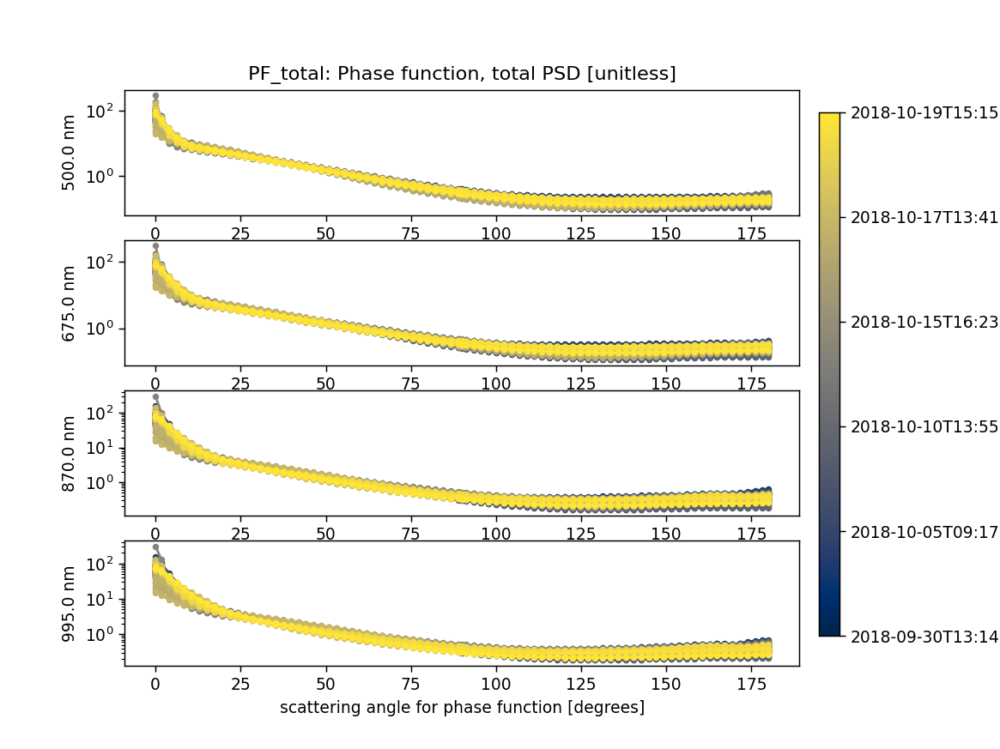

<ipython-input-59-67fa85137969>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


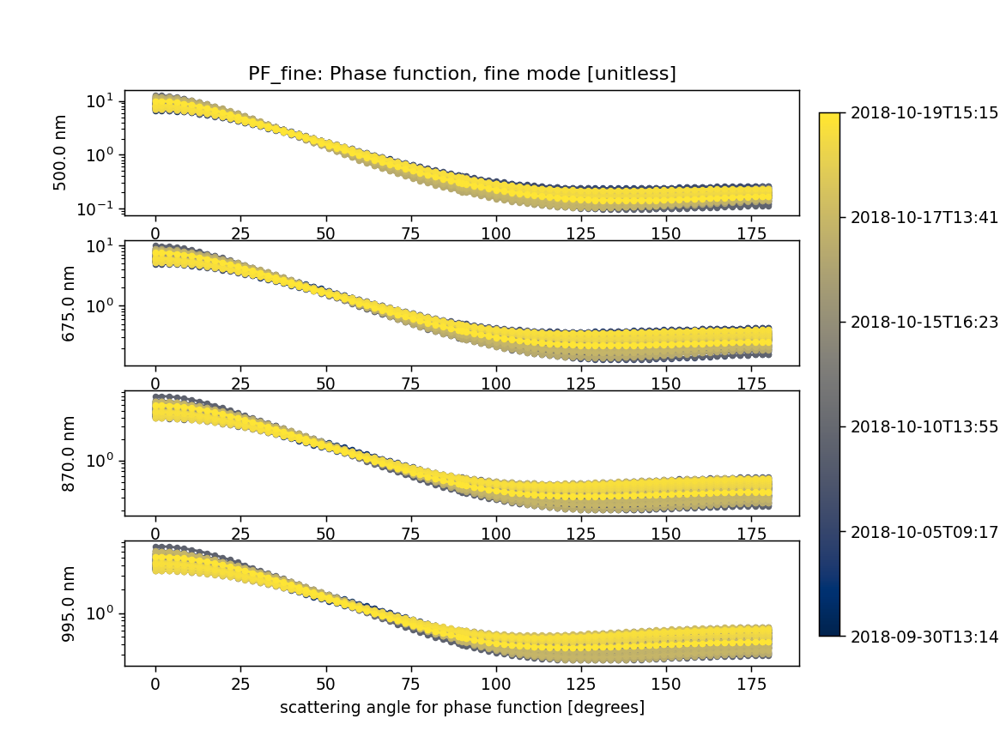

<ipython-input-59-67fa85137969>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


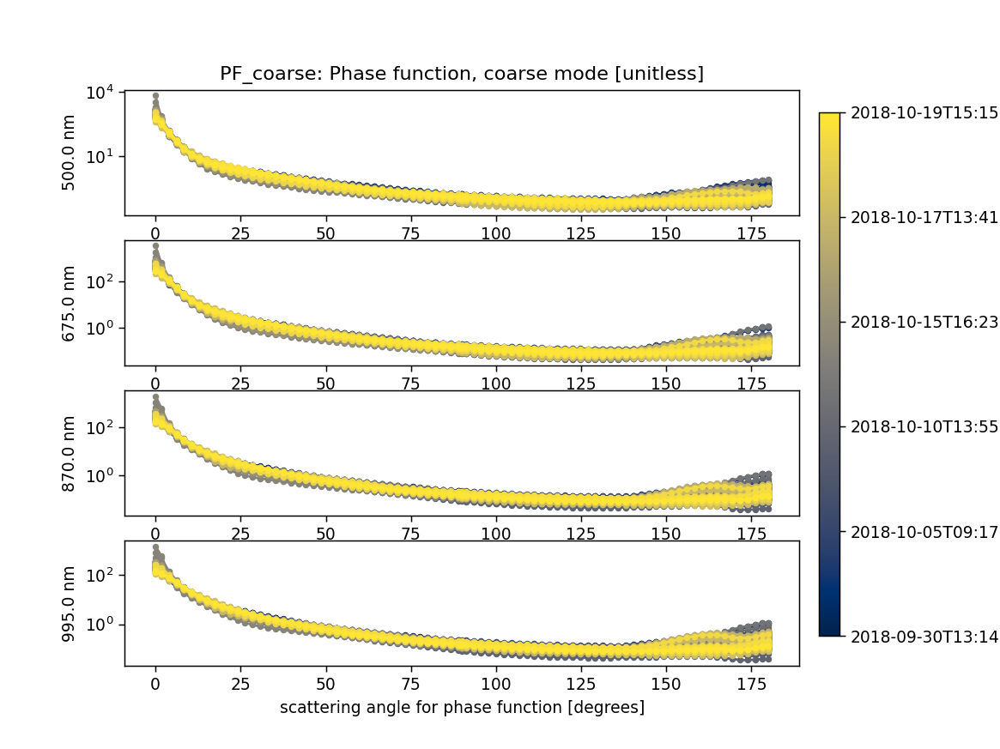

<ipython-input-59-67fa85137969>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


In [59]:
for k in nc8_all:
    if nc8_all[k].shape == nc8_all[b'PF_coarse'].shape:
        fig,ax = plt.subplots(4,1)
        for i in range(4):
            ax[i].set_prop_cycle(color=[plt.cm.cividis(k) for k in np.linspace(0, 1, len(nc8_all[b'time'])+1)])
            ax[i].plot(nc8_all[b'PF_angle'],nc8_all[k][:,i,:].T,'.-')
            ax[i].set_ylabel('{} nm'.format(nc8_all[b'wavelength'][i]))
            ax[i].set_yscale('log')

        ax[0].set_title(k.decode()+': '+nc8_dict_tmp[k].long_name + ' ['+nc8_dict_tmp[k].units+']')
        ax[-1].set_xlabel(nc8_dict_tmp[b'PF_angle'].long_name + ' ['+nc8_dict_tmp[b'PF_angle'].units+']')
        fig.subplots_adjust(right=0.8)
        cbar_ax = fig.add_axes([0.82, 0.15, 0.02, 0.7])
        scalarmap = plt.cm.ScalarMappable(cmap=plt.cm.cividis)
        scalarmap.set_array(np.linspace(0, 1, len(nc8_all[b'time'])+1))
        cb = plt.colorbar(scalarmap,cax=cbar_ax)
        indexes = [np.argmin(abs(np.linspace(0, 1, len(nc8_all[b'time']))-ti)) for ti in cb.get_ticks()]
        cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])
        
        
        plt.savefig(fpo8+name8+k.decode()+'.png',transparent=True,dpi=500)
        

<IPython.core.display.Javascript object>


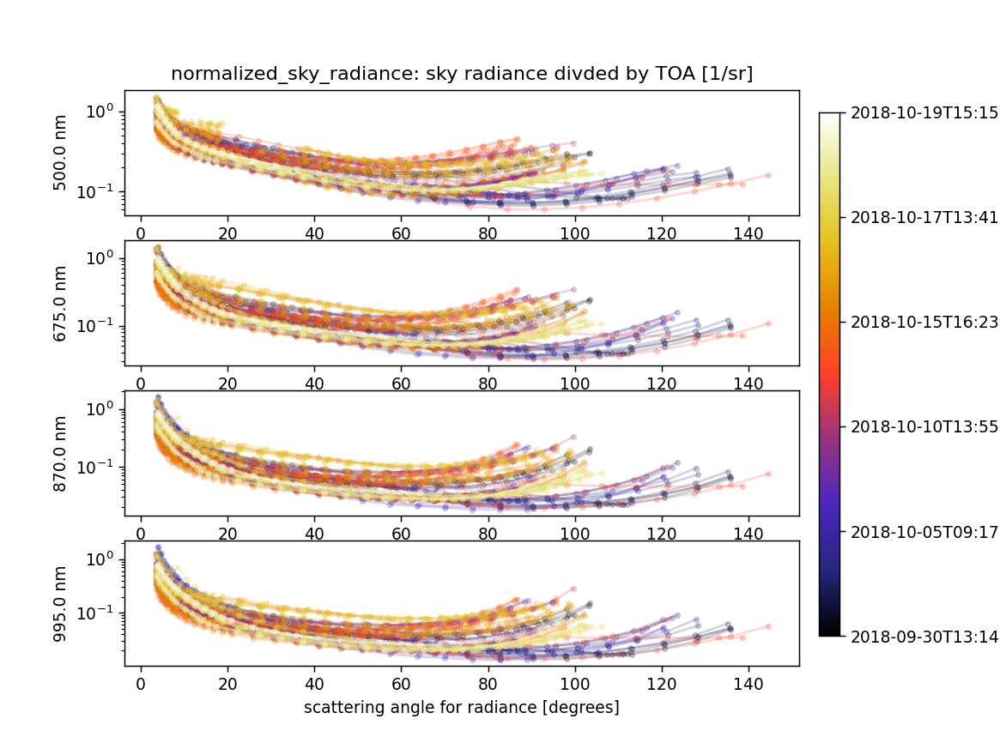

<ipython-input-52-cf844a2e2aa9>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


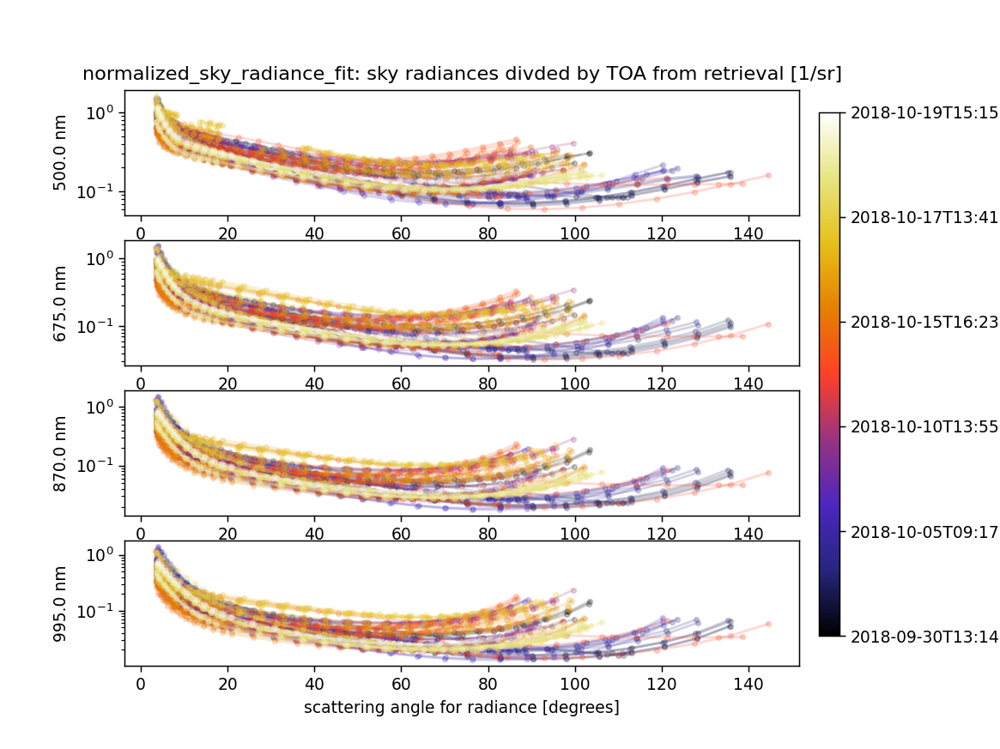

<ipython-input-52-cf844a2e2aa9>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


<IPython.core.display.Javascript object>


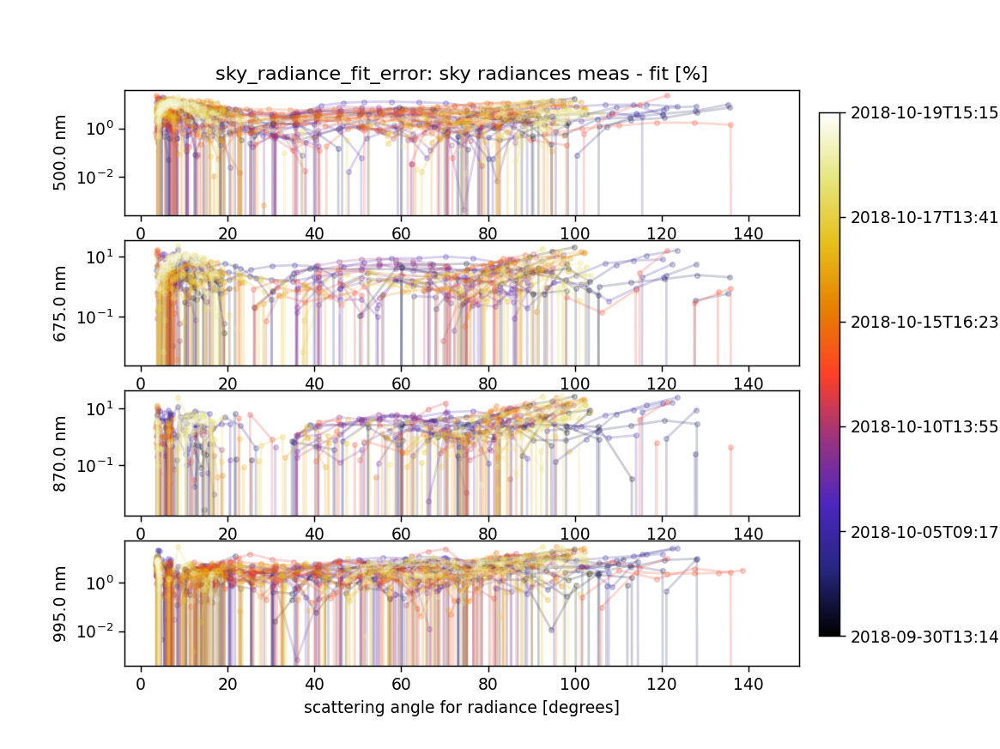

<ipython-input-52-cf844a2e2aa9>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


In [52]:
for k in nc8_all:
    if nc8_all[k].shape == nc8_all[b'normalized_sky_radiance'].shape:
        fig,ax = plt.subplots(4,1)
        for i in range(4):
            ax[i].set_prop_cycle(color=[plt.cm.CMRmap(k) for k in np.linspace(0, 1, len(nc8_all[b'time'])+1)])
            ax[i].plot(nc8_all[b'sca_angle'].T,nc8_all[k][:,i,:].T,'.-',alpha=0.2)
            ax[i].set_ylabel('{} nm'.format(nc8_all[b'wavelength'][i]))
            ax[i].set_yscale('log')

        ax[0].set_title(k.decode()+': '+nc8_dict_tmp[k].long_name + ' ['+nc8_dict_tmp[k].units+']')
        ax[-1].set_xlabel(nc8_dict_tmp[b'sca_angle'].long_name + ' ['+nc8_dict_tmp[b'sca_angle'].units+']')
        fig.subplots_adjust(right=0.8)
        cbar_ax = fig.add_axes([0.82, 0.15, 0.02, 0.7])
        scalarmap = plt.cm.ScalarMappable(cmap=plt.cm.CMRmap)
        scalarmap.set_array(np.linspace(0, 1, len(nc8_all[b'time'])+1))
        cb = plt.colorbar(scalarmap,cax=cbar_ax)
        indexes = [np.argmin(abs(np.linspace(0, 1, len(nc8_all[b'time']))-ti)) for ti in cb.get_ticks()]
        cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])
        
        plt.savefig(fpo8+name8+k.decode()+'.png',transparent=True,dpi=500)

<IPython.core.display.Javascript object>


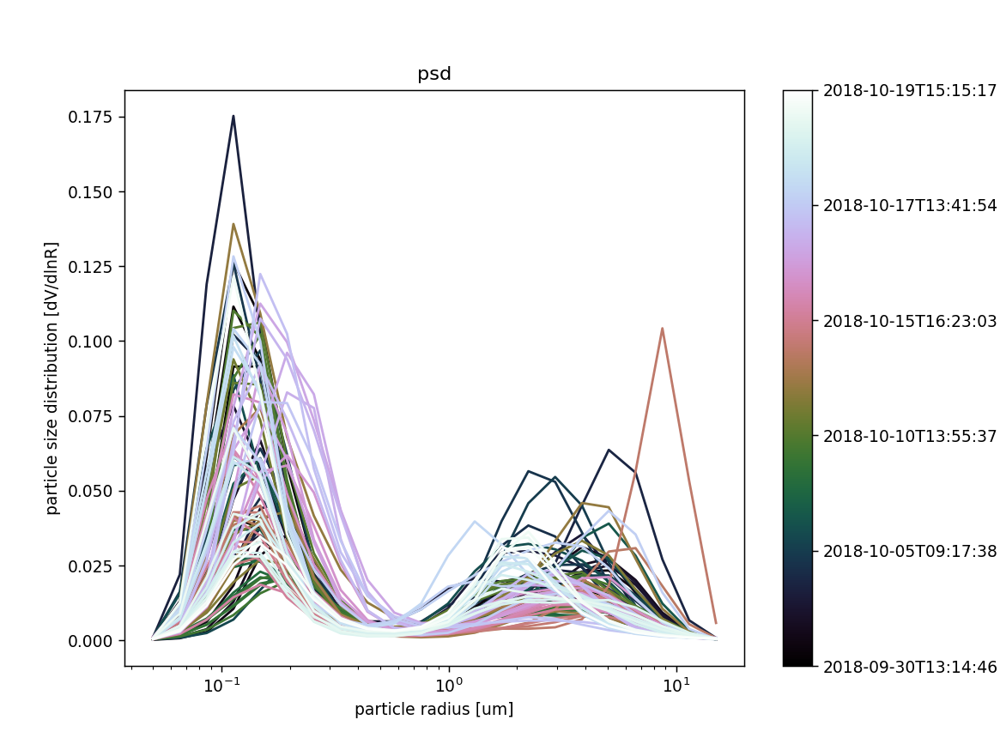

<ipython-input-53-8a3f082914bc>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])


In [53]:
plt.figure()
plt.gca().set_prop_cycle(color=[plt.cm.cubehelix(k) for k in np.linspace(0, 1, len(nc8_all[b'time'])+1)])
plt.plot(nc8_all[b'radius'],nc8_all[b'psd'].T)
plt.xscale('log')

plt.xlabel(nc8_dict_tmp[b'radius'].long_name + ' ['+nc8_dict_tmp[b'radius'].units+']')
plt.ylabel(nc8_dict_tmp[b'psd'].long_name + ' ['+nc8_dict_tmp[b'psd'].units+']')
plt.title(b'psd'.decode())

scalarmap = plt.cm.ScalarMappable(cmap=plt.cm.cubehelix)
scalarmap.set_array(np.linspace(0, 1, len(nc8_all[b'time'])+1))
cb = plt.colorbar(scalarmap)
indexes = [np.argmin(abs(np.linspace(0, 1, len(nc8_all[b'time']))-ti)) for ti in cb.get_ticks()]
cb.ax.set_yticklabels(nc8_all[b'datetime'][indexes])

plt.savefig(fpo8+name8+'psd'+'.png',transparent=True,dpi=500)

In [60]:
ae8_fine_mode = [nc8_all[b'radius'][np.argmax(p)] for p in nc8_all[b'psd'][:,0:9]]
ae8_coarse_mode = [nc8_all[b'radius'][9:][np.argmax(p)] for p in nc8_all[b'psd'][:,9:]]


<IPython.core.display.Javascript object>


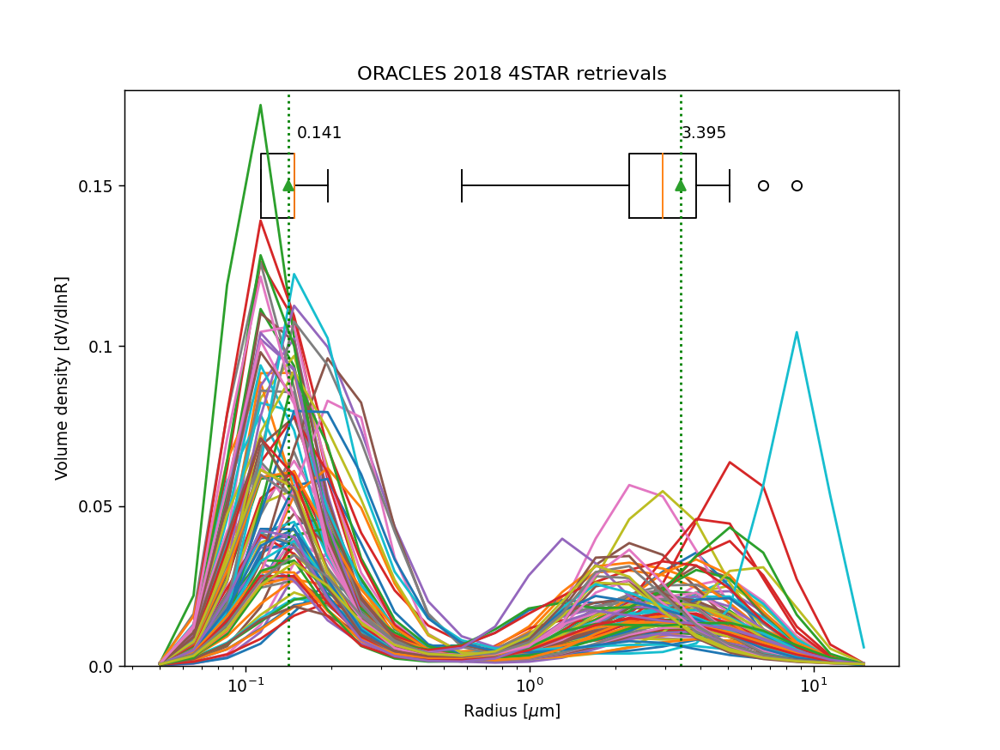

In [61]:
fig = plt.figure()
#
bp = plt.boxplot([ae8_fine_mode,ae8_coarse_mode],positions=[0.15,0.15],vert=False,showmeans=True,widths=0.02)
plt.plot(nc8_all[b'radius'],nc8_all[b'psd'].T)
plt.xscale('log')

[plt.axvline(m.get_data()[0],color='g',ls=':') for m in bp['means']]
[plt.text(m.get_data()[0]+0.01,0.165,'{:1.3f}'.format(m.get_data()[0][0])) for m in bp['means']]

plt.xlabel('Radius [$\mu$m]')
plt.ylabel('Volume density [dV/dlnR]')
plt.ylim(0,0.18)
plt.yticks([0.0,0.05,0.1,0.15])
plt.gca().set_yticklabels([0.0,0.05,0.1,0.15])

plt.title('ORACLES 2018 4STAR retrievals')

plt.savefig(fpo8+name8+'psd_avgeraged'+'.png',transparent=True,dpi=500)

In [62]:
nc8_dict_tmp.keys()

dict_keys([b'base_time', b'time_offset', b'time', b'wavelength', b'radius', b'psd', b'QA_level', b'sphericity', b'sphericity_err', b'PF_angle', b'sca_angle', b'n_real', b'n_imag', b'SSA', b'AOD_fit_total', b'AOD_fit_fine', b'AOD_fit_coarse', b'AOD_meas', b'AAOD', b'TOD_meas', b'TOD_fit', b'TOD_meas_minus_fit', b'AGOD', b'sfc_alb', b'g_total', b'g_fine', b'g_coarse', b'PF_total', b'PF_fine', b'PF_coarse', b'normalized_sky_radiance', b'normalized_sky_radiance_fit', b'sky_radiance_fit_error', b'scan_tag', b'scan_type', b'Lat', b'Lon', b'GPS_Altitude', b'Heading', b'Pitch', b'Roll', b'GPS_Altitude_std', b'Heading_std', b'Pitch_std', b'Roll_std', b'T_static', b'P_static', b'RH', b'SAZ', b'SZA', b'SEL', b'm_ray', b'PWV'])

In [64]:
ncf8 = sio.netcdf_file(fpo8+flist8[0])

In [65]:
for k in ncf8.__dict__:
    try:
        print(k+':   ',ncf8.__dict__[k].decode())
    except: 
        pass

PI:    Samuel LeBlanc
Institution:    NASA Ames Research Center
Instrument:    Spectrometers for Sky-Scanning, Sun-Tracking Atmospheric Research (4STAR)
Mission:    ORACLES 2018
PI_CONTACT_INFO:    samuel.leblanc@nasa.gov
PLATFORM:    NASA P3
LOCATION:    Based at Sao Tome, aircraft latitude, longitude, altitude are included in the data records
DATA_INFO:    Measurements represent airborne retrievals of aerosol properties derived from direct beam and angularly-resolved sky radiances at the location of the aircraft.  All measurements used in a single retrieval are reported at the time averaged over the sky scan. These retrievals are based on work by Logan Mitchell (log.mitch@ou.edu), and represent the highest quality data. Only retrievals that pass QC_CRITERIA are included in this archival
RETRIEVAL_INFO:    Retrieval code was provided by AERONET (version 2 Aerosol Inversions), input files modified for airborne application. Description is found in Pistone et al., 2019 (doi: https://doi.